# Automatically classify consumer goods- **Project 6 of the OpenClassrooms “Data Scientist” course**- **Mark Creasey**## Part 2: Image Classification

<!--TABLE OF CONTENTS-->- [1. Understanding the problem](#1.-Understanding-the-problem)- [1.1 Mission](#1.1-Mission)- [1.2 Requirements: Libraries used in this notebook](#1.2-Requirements-:-Libraries-used-in-this-notebook)- [1.3 Utility functions](#1.3-Utility-functions)- [1.4 Model evaluation:](#1.4-Model-evaluation:)- [1.5 Visualization of performance metrics](#1.5-Visualizations-of-performance-metrics)- [1.6 Create the confusion matrix](#1.6-Create-the-confusion-matrix)- [1.7 Visualization of clusters on 'reduced_dimensions'](#1.7-Visualization-of-clusters-on-'reduced_dimensions')- [1.8 Sankey Diagram (Visualization of the Confusion Matrix)](#1.8-Sankey-Diagram-(Visualization-of-the-confusion-matrix))- [1.9 Accumulation of model performance](#1.9-Accumulation-of-model-performance)- [2. Import, cleaning and exploratory analysis of data](#2.-Import,-cleaning-and-exploratory-analysis-of-data)- [2.1 Importing text data to retrieve images](#2.1-Importing-text-data-to-retrieve-images)- [2.2 Cleaning (preprocessing) of image data](#2.2-Cleaning-(preprocessing)-of-image-data)- [2.3 Image preprocessing pipeline](#2.3-Image-preprocessing-pipeline)- [3. SIFT - (Scale-Invariant Feature Transform)](#3.-SIFT---(Scale-Invariant-Feature-Transform))- [3.1 Pre-processing of images via SIFT](#3.1-Pre-processing-of-images-via-SIFT)- [3.2 Creation of descriptor clusters](#3.2-Creation-of-descriptor-clusters)- [3.3 Creating image features](#3.3-Creating-image-features)- [3.4 Dimension Reductions](#3.4-Dimension-Reductions)- [3.5 KMeans: determination of the number of clusters of images](#3.5-KMeans-:-determination-of-the-number-of-clusters-of-images)- [3.6 Visual analysis: T-SNE display according to image categories](#3.6-Visual-analysis-:-T-SNE-display-according-to-image-categories)- [3.7 Analysis of similarity between categories and clusters](#3.7-Analysis-of-similarity-between-categories-and-clusters)- [3.8 View images by cluster found by SIFT](#3.8-View-images-by-cluster-found-by-SIFT)- [4. ORB (Oriented FAST and Rotated BRIEF)](#4.-ORB-(Oriented-FAST-and-Rotated-BRIEF))- [4.1 Pre-processing images via ORB](#4.1-Pre-processing-images-via-ORB)- [4.2 Creation of descriptor clusters](#4.2-Creation-of-descriptor-clusters)- [4.3 Creating image features](#4.3-Creating-image-features)- [4.4 Dimension Reductions](#4.4-Dimension-Reductions)- [4.5 KMeans: determination of the number of clusters of images](#4.5-KMeans-:-determination-of-the-number-of-clusters-of-images)- [4.6 Visual analysis: T-SNE display according to image categories](#4.6-Visual-analysis-:-T-SNE-display-according-to-image-categories)- [4.7 Analysis of similarity between categories and clusters](#4.7-Analysis-of-similarity-between-categories-and-clusters)- [4.8 View categories found by ORB](#4.8-View-categories-found-by-ORB)- [5. Image classification: CNN method](#5.-Image-classification-:-CNN-method)- [5.1 Building a CNN from A to Z with Tensorflow / Keras](#5.1-Building-a-CNN-from-A-to-Z-with-Tensorflow-/-Keras)- [5.2 Training a baseline CNN model](#5.2-Training-a-baseline-CNN-model)- [5.3 Preparation d'images pour CNN](#5.3-Preparation-d'images-pour-CNN)- [5.4 Evolution of history](#5.4-Evolution-of-history)- [5.5 Model performance evaluation (accuracy, score)](#5.5-Model-performance-evaluation-(accuracy,-score))- [5.6 Repeat, but with sparse_category](#5.6-Repeat,-but-with-sparse_category)- [5.7 Dataset tensors: means of creating out-of-memory datasets](#5.7-Dataset-tensors-:-means-of-creating-out-of-memory-datasets)- [5.8 VGG-16 model without training](#5.8-VGG-16-model-without-training)- [6. Classification with pre-trained VGG16](#6.-Classification-with-pre-trained-VGG16)- [6.1 Classification avec pretrained VGG16 (1000 classes d'ImageNet)](#6.1-Classification-avec-pretrained-VGG16-(1000-classes-d'ImageNet))- [6.2 Semi-supervised classification of VGG-16 images](#6.2-Semi-supervised-classification-of-VGG-16-images)- [6.3 Unsupervised clustering without the first 2 layers of VGG16](#6.3-Unsupervised-clustering-without-the-first-2-layers-of-VGG16)- [7. Transfer Learning with pre-trained VGG16](#7.-Transfer-Learning-with-pre-trained-VGG16)- [7.1 Regularization with random data augmentation](#7.1-Regularization-with-random-data-augmentation)- [7.2 Creating the model for transfer learning (with preprocessing and data augmentation)](#7.2-Creating-the-model-for-transfer-learning-(with-preprocessing-and-data-augmentation))- [7.3 Transfer Learning - Stratégie #1 : Fine tuning total](#7.3-Transfer-Learning---Stratégie-#1-:-Fine-tuning-total)- [7.4 Transfer Learning - Strategy #2: Feature Extraction](#7.4-Transfer-Learning---Strategy-#2-:-Feature-Extraction)- [7.5 Transfer Learning - Strategy #3: Partial Fine-tuning](#7.5-Transfer-Learning---Strategy-#3-:-Partial-Fine-tuning)- [7.6 Conclusions](#7.6-Conclusions)- [8. Combination of image features + text features](#8.-Combination-of-image-features-+-text-features)- [8.1 Feature Extraction](#8.1-Feature-Extraction)- [8.2 Procedure for merging text and image vectors](#8.2-Procedure-for-merging-text-and-image-vectors)- [8.3 Clustering on text features + image features](#8.3-Clustering-on-text-features-+-image-features)- [8.4 Visualization of clusters (features texts + images)](#8.4-Visualization-of-clusters-(features-texts-+-images))- [8.5 Performance evaluation on the 7 level 1 categories](#8.5-Performance-evaluation-on-the-7-level-1-categories)- [8.6 Performance evaluation on level 2 categories](#8.6-Performance-evaluation-on-level-2-categories)- [9. Results](#9.-Results)- [9.1 Summary of results](#9.1-Summary-of-results)- [9.2 Recording results](#9.2-Recording-results)

#1. Understanding the problem## 1.1 MissionStudy the feasibility of a **classification engine** for articles in different categories,with a sufficient level of precision.- **carry out an initial feasibility study of a classification engine**, of articles, based onan image and a description, for the automation of the attribution of the article category.- **analyze the dataset** by **performing preprocessing** of the product descriptions andimages, **dimension reduction**, then **clustering**, to be presented in the form oftwo-dimensional graphics, and confirmed by a calculation of similarity between categoriesreal and clusters.- illustrates that the extracted characteristics make it possible to group products of the samecategory.- demonstrate, through this modeling approach, the feasibility of automatically grouping togetherproducts of the same category

### 1.1.1 InterpretationSteps for image classification:- image preprocessing- extraction des _features_ (SIFT, ORB)- creation of _bag-of-features_- supervised classification (by CNN for example)

## 1.2 Requirements: Libraries used in this notebook- see [`requirements.txt`](./requirements.txt) for versions of libraries tested with this notebook**Installing openCV on windows**- Use the command `pip install opencv-contrib-python` in your conda environment- test : `import cv2; print(cv2.__version__)`- <https://learnopencv.com/install-opencv-on-windows/>

In [ ]:
# si ce notebook ne marche pas avec les versions
# des bibliothèques dans votre environnement, alors
# decommentarise la ligne suivant pour des versions testées :

# %pip install -r requirements.txt


In [ ]:
def install_libraries(required={}) -> None:
    """
    Installation des bibliothèques manquantes
    https://stackoverflow.com/questions/44210656/
    """
    import sys
    import subprocess
    import pkg_resources
    installed = {pkg.key for pkg in pkg_resources.working_set}
    missing = set(required) - set(installed)
    if missing:
        print(f'missing libraries: {missing}')
        python = sys.executable
        subprocess.check_call([python, '-m', 'pip', 'install', *missing],
                              stdout=subprocess.DEVNULL)


required_libraries = {'numpy', 'pandas',
                      'matplotlib', 'seaborn', 'scikit-learn',
                      'pillow', 'pydot', 'graphviz', 'pathvalidate', 'plotly'}
install_libraries(required_libraries)


missing libraries: {'pathvalidate'}


In [ ]:
!pip install -q kaleido

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 79.9/79.9 MB 8.5 MB/s eta 0:00:00


### 1.2.1 Importing LibrariesThe keras and tensorflow.keras libraries are 2 separate libraries, sometimes with subtle differences between the APIs.To avoid problems, [it is recommended](https://pyimagesearch.com/2019/10/21/keras-vs-tf-keras-whats-the-difference-in-tensorflow-2-0/) to import keras only from tensorflow.

In [ ]:
import warnings
warnings.filterwarnings("ignore", category=FutureWarning)

import os
import time
import random  # for sampling np.array
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# optimize linear sum du diagonal d'un confusion matrix
import scipy

import sklearn

# feature preprocessing
from sklearn import preprocessing
# feature et parameter selection
from sklearn.model_selection import train_test_split, ParameterGrid
# reduction de dimensions TSNE et PCA
from sklearn import manifold, decomposition
# clustering KMeans
from sklearn import cluster
# metrics de performance
from sklearn import metrics

import PIL  # constants
# lecture, conversion, enregistrement d'une image
from PIL import Image
# mise en gris, égalise, resize, filtre...
from PIL import ImageOps, ImageFilter

# Bibliothèque de computer vision
import cv2

# pour diagrammes Sankey
import plotly.graph_objects as go
from IPython import display
import plotly.io as pio
# pour enregistrée diagramme Sankey comme png
import kaleido

# Enregistre les
import pickle

import tensorflow as tf
from tensorflow import keras

# pour visualiser les keras models comme diagramme
import pydot
import graphviz

# from tensorflow.keras import layers
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping, ReduceLROnPlateau
# from tensorflow.keras.preprocessing.image import ImageDataGenerator
# from tensorflow.keras.applications.vgg16 import VGG16


### 1.2.2 List of versions of libraries used

In [ ]:
from platform import python_version

print(python_version())
print('versions des bibliothèques utilisées:')
print('; '.join(f'{m.__name__}=={m.__version__}' for m in globals(
).values() if getattr(m, '__version__', None)))


3.11.12
versions des bibliothèques utilisées:
tensorflow==2.18.0; numpy==2.0.2; pandas==2.2.2; seaborn==0.13.2; scipy==1.14.1; sklearn==1.6.1; PIL==11.1.0; PIL.Image==11.1.0; cv2==4.11.0; kaleido==0.2.1; keras._tf_keras.keras==3.8.0; pydot==3.0.4; graphviz==0.20.3


### 1.2.3 Display Defaults Configuration

In [ ]:
pd.set_option('display.max_columns', 200)  # pour afficher toutes les colonnes
pd.set_option('display.max_rows', 20)  # pour afficher max 10 lignes
pd.set_option('display.max_colwidth', 100)  # pour afficher toutes la text
pd.set_option('display.precision', 2)
pd.options.display.float_format = '{:.2f}'.format  # currency, lat,lng

%matplotlib inline
sns.set_theme(style="white", context="notebook")
sns.set_color_codes("pastel")
sns.set_palette("tab20")

sklearn.set_config(display='diagram')
# displays HTML representation in a jupyter context


### 1.2.4 Some constants

In [ ]:
# Définir RANDOM_SEED = None pour des résultats variables
# Ici on définit RANDOM_SEED = constant seulement pour la réproductibilité
RANDOM_SEED = 42

# Suppression du PIL DecompressionBombWarning, car une image est 93680328 pixels
# Image size (pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.
# PIL.Image.MAX_IMAGE_PIXELS = 89478485 (default)
PIL.Image.MAX_IMAGE_PIXELS = 93680328 + 1


## 1.3 Utility functions### 1.3.1 Saving ChartsTo save the graphics, define **`SAVE_IMAGES = True`**

In [ ]:
SAVE_IMAGES = True
IMAGE_FOLDER = 'images/cv'
if not os.path.exists(IMAGE_FOLDER):
    os.makedirs(IMAGE_FOLDER)


In [ ]:
def sanitize(fig_name: str) -> str:
    """Enlever les caractères interdits dans les filenames ou filepaths"""
    return fig_name.replace(' ', '_').replace(':', '-').replace(
        '.', '-').replace('/', '_').replace('>', 'gt.').replace('<', 'lt.')


def make_timestamp():
    return time.strftime('%Y-%m-%d_%H_%M_%S')


def to_png(fig_name=None) -> None:
    """
    Register the current plot figure as an image in a file.
    Must call plt.show() or show image (by calling to_png() as last row in python cell)
    to apply the call 'bbox_inches=tight', to be sure to include the whole title / legend
    in the plot area.
    """

    def get_title() -> str:
        """find current plot title (or suptitle if more than one plot)"""
        if plt.gcf()._suptitle is None:  # noqa
            return plt.gca().get_title()
        else:
            return plt.gcf()._suptitle.get_text()  # noqa

    if SAVE_IMAGES:
        if fig_name is None:
            fig_name = get_title()
        elif len(fig_name) < 9:
            fig_name = f'{fig_name}_{get_title()}'
        fig_name = sanitize(fig_name)
        print(f'"{fig_name}.png"')
        plt.gcf().savefig(
            f'{IMAGE_FOLDER}/{fig_name}.png', bbox_inches='tight')


In [ ]:
OUT_FOLDER = 'data/out'


def save_pickle(obj, filename, filepath=OUT_FOLDER):
    with open(f'{filepath}/{filename}.pickle', 'wb') as handle:
        pickle.dump(obj, handle, protocol=pickle.HIGHEST_PROTOCOL)


def load_pickle(filename, filepath=OUT_FOLDER):
    with open(f'{filepath}/{filename}.pickle', 'rb') as handle:
        return pickle.load(handle)


### 1.3.2 Check that the columns are in the dataframe- without changing the order of the columns

In [ ]:
def cols_in_df(df: pd.DataFrame, colonnes: list = None) -> list:
    """
    Procedure pour retourner les colonnes existantes dans le dataframe dans la même ordre.
    Utiliser pour assurer que les colonnes existe.
    """
    ret_cols = []
    for col in colonnes:
        if col in df.columns:
            ret_cols.append(col)
    return ret_cols


## 1.4 Model evaluation- **Dimension reduction** (by t-SNE, PCA, NMF, truncatedSVD...)- **Unsupervised clustering on reduced dimensions** (Gridsearch of hyperparameters, with or without choice of number of clusters)- by Kmeans (default)- par LDA (topic modelling)- by NMF (not used here)- **Evaluation de performance**:- distortion score (the inertia or sum of squared errors of each cluster)- davies_bouldin score (cluster separation measure)- cluster silhouette score (+ visualization of the silhouettes of each cluster)- cluster stability score (on sub-samples --> standard deviation)- **Evaluation of correspondence with the defined categories**- ARI score- percentage of misclassified items- visualization to compare clusters on the main reduced dimensions (TSNE or PCA for example)- Sankey visualization of correlations between clusters

### 1.4.1 Scoring : performance d'un model KMeansAn alternative to GridsearchCV, which allows to evaluate several metrics

In [ ]:
# from sklearn.model_selection import ParameterGrid
# from sklearn import model, cluster, metrics
# import time

search_params = {'n_clusters': range(4, 12)}


def get_classname(estimator):
    return estimator.__class__.__name__


def score_kmeans(df: pd.DataFrame, param_grid=search_params, labels_true=None):
    """Exécuter un traitement de données, extraire les features, réduire les dimensions et faire du clustering
    Returns : scores, labels du meilleur kmeans
    """

    df_scores = pd.DataFrame({})

    nb_clusters = 7
    # generate parameter grid for classifier
    param_sets = ParameterGrid(param_grid)
    for params in param_sets:
        # print(f'score model for params = {params}')
        # set model parameters (usually just n_clusters for classifier)
        k = params.get('n_clusters', nb_clusters)
        clusterer = cluster.KMeans(n_clusters=k)
        clusterer.set_params(**params)
        #
        start_fit_clf = time.time()
        clusterer.fit(df)
        fit_time_clf = round(time.time()-start_fit_clf, 2)
        # print(f'Clusterer fit time = {fit_time_clf} s')

        labels_pred = clusterer.labels_
        cluster_sizes = (pd.Series(labels_pred).value_counts(
            normalize=True).values*100).astype(int)

        min_cluster_pct = pd.Series(
            labels_pred).value_counts(normalize=True).min()
        res = {'k': k,
               'min_cluster_pct': round(min_cluster_pct*100, 2),
               'distortion_score': round(getattr(clusterer, 'inertia_', 0), 0),
               'davies_bouldin': round(metrics.davies_bouldin_score(df, labels_pred), 2),
               'calinski_harabasz': round(metrics.calinski_harabasz_score(df, labels_pred), 2),
               'silhouette_score': round(metrics.silhouette_score(df, labels_pred), 3),
               'fit_time_cluster': fit_time_clf
               }
        ARI = ''
        if not labels_true is None:
            res['ARI'] = round(metrics.adjusted_rand_score(
                labels_true, labels_pred), 3)
            ARI = f" ARI = {res['ARI']},"
        print(
            f"k={k}, fit: {fit_time_clf} s, silhouette= {res['silhouette_score']:.3},{ARI} cluster sizes = {cluster_sizes}")
        df_scores = pd.concat([df_scores, pd.DataFrame([res])], ignore_index=True)

    df_scores['classifier'] = get_classname(clusterer)
    df_scores['k'] = df_scores['k'].astype(int)

    # fourni les labels du meilleur k (on peut plus inferer best_k = labels.nunique())
    best_score_idx = df_scores['silhouette_score'].idxmax()
    best_k = df_scores.loc[best_score_idx, 'k']
    clusterer = cluster.KMeans(n_clusters=best_k)
    clusterer.fit(df)
    labels_pred = clusterer.labels_
    return df_scores, labels_pred


## 1.5 Performance Metrics VisualizationsWe are inspired by yellowbrick KElbowVisualizer to generalize to other metrics (stability for example)

In [ ]:

def angle_between_vectors(v1, v2):
    """
    calculate angle between 2 vectors.
    use to find elbows
    """
    ang1 = np.arctan2(*v1[::-1])
    ang2 = np.arctan2(*v2[::-1])
    ang = np.rad2deg(abs(ang1 - ang2) % (2 * np.pi))
    if ang > 180:
        ang = ang-180
    return ang


print([
    angle_between_vectors([1, 1], [0, 0]),
    angle_between_vectors([1, 1], [0, 1]),
    angle_between_vectors([1, 1], [-1, 0]),
    angle_between_vectors([1, 1], [-1, -1]),
])


[np.float64(45.0), np.float64(45.0), np.float64(135.0), np.float64(180.0)]


In [ ]:

def find_elbow(df: pd.DataFrame, x_col='k', y_col='distortion_score'):
    """find sharpest difference in angle for [k, score]"""
    df = df.copy().reset_index()
    # standardise scale to maximise angles between points

    x_scale = df[x_col].max()-df[x_col].min()
    y_min = df[y_col].min()
    y_mult = (df[y_col].max()-y_min)/x_scale
    df['y_scaled'] = (df[y_col]-y_min)/y_mult

    # calculate angles between consecutive points
    n = len(df)
    for i in range(0, n-2):
        point1 = df.loc[i, [x_col, 'y_scaled']]
        point2 = df.loc[i+1, [x_col, 'y_scaled']]
        point3 = df.loc[i+2, [x_col, 'y_scaled']]
        vec1 = point2-point1
        vec2 = point3-point2
        df.loc[i+1, 'angle'] = angle_between_vectors(vec1, vec2)
    # elbow is at highest difference in angle (assume monotonic function)
    row = df['angle'].idxmax()
    x_elbow = df.loc[row, x_col]
    y_score = df.loc[row, y_col]
    return x_elbow, y_score


In [ ]:

# k_best, distortion_score = find_elbow(scores, y_col='distortion_score')
# print(f'Best score for k = {k_best}')
# # check labels for best score have been returned
# print(pd.Series(labels).nunique())


### 1.5.1 Plot elbow visualiser

In [ ]:

def plot_second_ax(df, x_col, y2_col, ax, color='grey'):
    """add a secondary y axis to a plot"""
    if y2_col in df.columns:
        ax2 = ax.twinx()
        ax2.plot(df[x_col], df[y2_col], label=y2_col,
                 c=color, marker='o', linestyle='--', alpha=0.75)
        ax2.tick_params(axis='y', colors=color)
        ax2.set_ylabel(y2_col, color=color)


def plot_elbow(df, x_col, y_col, ax):
    """draw a vertical line at elbow on a plot"""
    elbow_k, elbow_score = find_elbow(df, x_col, y_col)
    elbow_label = f'elbow at ${x_col}={elbow_k}$'
    ax.axvline(elbow_k, c='k', linestyle="--", label=elbow_label)
    ax.legend(frameon=True)


def plot_vline(df, x_col, y_col, ax, line_at='max'):
    """draw a vertical line at max or min value of y on a plot"""
    if line_at == 'max':
        row_idx = df[y_col].argmax()
    elif line_at == 'min':
        row_idx = df[y_col].argmin()
    line_x = df.loc[row_idx, x_col]
    line_label = f'{line_at} at ${x_col}={line_x}$'
    ax.axvline(line_x, c='k', linestyle="--", label=line_label)
    ax.legend(frameon=True)


def plot_elbow_visualiser(df: pd.DataFrame, x_col='k', score_col='distortion_score',
                          show_elbow=False, time_col=None, ax1=None):
    """
    Generic ElbowVisualiser, capable of showing any metric, elbows, secondary axis...
    Allows subsequent manipulation of plots
    """
    colors = sns.color_palette("tab20").as_hex()
    if ax1 is None:
        _, ax1 = plt.subplots()
    # scores
    ax1.plot(df[x_col], df[score_col],
             marker="D", c=colors[0], linestyle="-")
    ax1.grid(False)
    ax1.tick_params(axis='y', colors=colors[0])
    ax1.set_xlabel(x_col)
    ax1.set_ylabel(score_col, c=colors[0])
    # fit times
    if not time_col is None:
        plot_second_ax(df, x_col, y2_col=time_col, ax=ax1)
    if show_elbow:
        plot_elbow(df, x_col, score_col, ax1)


# Test visualiser
# plot_elbow_visualiser(scores, score_col='distortion_score', show_elbow=True)
# plt.suptitle(f'Kmeans Distortion Score')
# to_png()


### 1.5.2 Plot summary metrics- visualize multiple metrics com subplots

In [ ]:
# print(sorted(list(scores.columns)))


In [ ]:

def plot_metrics(df_scores, x_col='k', titre=''):
    """
    Plot each clustering metric in df_scores in a subplot
    Plots to show depend on metrics added to df_scores
    Parameters
    ----------
    df_scores   Scores for all permutations of a param_grid (previously calculated)
    x_col       Choice of parameter to compare -by default k, but can show any hyperparameter
    """
    if 'clf' in df_scores.columns and 'preprocessor' in df_scores.columns:
        print(
            f"plotting metrics (clf: {df_scores['clf'][0]}, preprocessor: {df_scores['preprocessor'][0]})")

    METRICS = ['distortion_score', 'calinski_harabasz',
               'davies_bouldin', 'silhouette_score', 'stability_score']
    metrics = cols_in_df(df_scores, METRICS)
    n_plots = len(metrics)
    n_cols = min(n_plots, 2)
    # n_rows = int(ceil(n_plots/n_cols))
    n_rows = n_plots // n_cols + (n_plots % n_cols > 0)
    _ = plt.figure(figsize=(n_cols*5, n_rows*3))
    for n, metric in enumerate(metrics):
        ax = plt.subplot(n_rows, n_cols, n + 1)
        if metric == 'distortion_score':
            plot_elbow_visualiser(
                df_scores, x_col, metric, ax1=ax, time_col='fit time (s)', show_elbow=True)
            plt.title(metric)
        if metric == 'calinski_harabasz':
            plot_elbow_visualiser(df_scores, x_col, metric, ax1=ax)
            plot_vline(df_scores, x_col, metric, ax=ax, line_at='max')
            plt.title(f'{metric} score (max={df_scores[metric].max():.0f})')
        if metric == 'davies_bouldin':
            plot_elbow_visualiser(df_scores, x_col, metric, ax1=ax)
            plot_vline(df_scores, x_col, metric, ax=ax, line_at='min')
            plt.title(f'{metric} score (min={df_scores[metric].min():.2f})')
        if metric == 'silhouette_score':
            titre = f'{metric} (max={df_scores[metric].max():.2f})'
            if 'silhouette_score_std' in df_scores.columns:
                if 'silhouette_sample_sizes' in df_scores.columns:
                    sample_size = int(
                        df_scores['silhouette_sample_sizes'].max())
                    titre += f' 10 samples de {sample_size} pts'
                plt.errorbar(data=df_scores, x=x_col, y='silhouette_score',
                             yerr='silhouette_score_std')
            plot_elbow_visualiser(df_scores, x_col, metric,
                                  ax1=ax, time_col='silhouette_time')
            plot_vline(df_scores, x_col, metric, ax=ax, line_at='max')
            plt.title(titre)
        if metric == 'stability_score':
            titre = f'{metric} (max={df_scores[metric].max():.2f})'
            if 'stability_score_std' in df_scores.columns:
                if 'stability_sample_sizes' in df_scores.columns:
                    sample_size = int(
                        df_scores['stability_sample_sizes'].max())
                    titre += f' 10 samples de {sample_size} pts'
                plt.errorbar(data=df_scores, x=x_col, y='stability_score',
                             yerr='stability_score_std')
            plot_elbow_visualiser(df_scores, x_col, metric,
                                  ax1=ax, time_col='stability_time')
            plot_vline(df_scores, x_col, metric, ax=ax, line_at='max')
            plt.title(titre)

    plt.subplots_adjust(hspace=0.5, wspace=0.5)
    plt.suptitle(
        f"Plot metrics - {titre}")


# test
# plot_metrics(scores)
# to_png()


## 1.6 Create the confusion matrix### 1.6.1 Calculation of best match between category and cluster labelThe cluster labels assigned by models (e.g. kmeans) are random, which makes comparisons between the assigned category and the labels difficult to compare: they will not have the same colorsWe try to match the cluster labels in the same order as categ_true, to make it easier:- the confusion matrix between category and cluster- comparison of clusters on tsne/pca plots (closer colors)- Sankey diagrams to show relationshipsWhen the number of predicted classes is the same as the number of "true" classes, the confusion matrix is ​​best calculated by the Hungarian algorithm:- Associate each true class with the closest predicted cluster in the diagonal, so as to maximize the correspondence between true classes and predicted classes (the ARI score is calculated based on this 1 to 1 relationship)References- https://sparse-plex.readthedocs.io/en/latest/book/clustering/comparing_clusterings.html- https://python.plainenglish.io/hungarian-algorithm-introduction-python-implementation-93e7c0890e15- https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.linear_sum_assignment.htmlAs an alternative to KMeans (algorithm released October 2021):- https://www.researchgate.net/publication/353696146_The_utility_of_clusters_and_a_Hungarian_clustering_algorithm

### 1.6.2 Confusion Matrix - Approach 1: Maximize the correspondence between true class and predicted cluster

In [ ]:
def squarify_df(df: pd.DataFrame, val=0):
    rows, cols = df.shape
    if rows > cols:
        # append columns to end of dataframe
        pad_cols = rows-cols
        pad_df = pd.DataFrame(
            np.zeros((rows, pad_cols), dtype=int), index=df.index)
        pad_df.columns = [f'pad_{i}'for i in range(pad_cols)]
        df = pd.concat([df, pad_df], axis=1) # Use pd.concat instead of append for horizontal concatenation
    elif cols > rows:
        # append rows to end of dataframe
        pad_rows = cols-rows
        pad_df = pd.DataFrame(data=np.zeros((cols-rows, cols), dtype=int),
                              columns=range(cols))
        pad_df.index = [f'pad_{i}'for i in range(pad_rows)]
        df = pd.concat([df, pad_df], axis=0) # Use pd.concat instead of append for vertical concatenation
    return df


df_test_rows = pd.DataFrame([[1, 0, 6], [0, 3, 3]])
df_test_cols = df_test_rows.T
print(df_test_rows.shape)
print(squarify_df(df_test_rows))
print(squarify_df(df_test_cols))


(2, 3)
       0  1  2
0      1  0  6
1      0  3  3
pad_0  0  0  0
   0  1  pad_0
0  1  0      0
1  0  3      0
2  6  3      0


In [ ]:
def confusion_matrix_crosstab(y_true, y_pred, normalize=False)->pd.DataFrame:
    """
    Create confusion matrix as dataframe for string or numeric labels
    - Replacement for sklearn.metrics.confusion_metric
    which does not accept mixed types and returns numpy array
    """
    if not isinstance(y_true, pd.Series):
        y_true=pd.Series(np.array(y_true),name='y_true')

    if not isinstance(y_pred, pd.Series):
        y_pred=pd.Series(np.array(y_pred),name='y_pred')

    if isinstance(y_pred, pd.Series):
        # si les deux sont des series, pd.crosstab utilise leurs indices pour faire le crosstab
        y_pred = y_pred.copy()
        y_pred.index = y_true.index

    # créer le matrice de confusion entre la catégorie et cluster label
    return pd.crosstab(y_true, y_pred, normalize=normalize)

In [ ]:
def conf_matrix_labels(categ_true: pd.Series, clust_labels: pd.Series, normalize=False):
    """
    Calcul de meilleure correspondance entre true_categorie et predicted categorie par optimisation de la diagonale
    (Approche 1 : optimiser la diagonale de la matrice de confusion)

    Les cluster labels attribué par kmeans sont aléatoires
    On essaie de mettre les cluster labels dans la même ordre que categ_true,
    pour faciliter :
        - la matrice de confusion entre la catégorie et cluster
        - la comparaison des clusters sur plots tsne/pca (couleurs plus proche)
        - les diagrammes Sankey pour montre les relations
    """
    df_matr=confusion_matrix_crosstab(categ_true, clust_labels,normalize=normalize)

    # L'algorithme a besoin d'une matrice carré
    n_categ = df_matr.shape[0]
    n_labels = df_matr.shape[1]

    square_matr = squarify_df(df_matr).fillna(0)

    # trouve ordre de colonnes et lignes pour maximiser valeurs dans la diagonale
    rows, cols = scipy.optimize.linear_sum_assignment(
        square_matr.values, maximize=True)

    # Supprimer les lignes/colonnes vides après optimisation de la diagonale
    if len(rows) > n_categ:
        rows = [idx for idx in rows if idx < n_categ]
    if len(cols) > n_labels:
        cols = [idx for idx in cols if idx < n_labels]
    # print(f'len(rows) : {len(rows)}')
    # print(f'len(cols) : {len(cols)}')

    df_opt = df_matr.iloc[:, cols]

    if normalize == False:
        df_opt = df_opt.round(0).astype(int)

    return df_opt

# test 1:  n_categ < n_labels
y_true1=['a','a','a','a','a','a','b','b','b','c','c','c','c','c','c']
y_pred1=[0,3,4,1,0,4,3,4,1,3,2,1,3,1,1]

# test 2: n_categ == n_labels
y_true2=['a','a','a','b','b','b','c','c','c','d','d','d','e','e','e']
y_pred2=[0,3,3,1,0,1,3,4,4,2,3,1,3,1,3]

# test 3: n_categ > n_labels
y_true3=['a','a','a','b','b','b','c','c','c','d','d','d','e','e','e']
y_pred3=[0,2,2,1,0,1,2,0,0,1,2,1,2,1,2]


pd.crosstab(pd.Series(y_true1,name='y_true1'),pd.Series(y_pred1,name='y_pred1')).style.background_gradient(axis=1)

y_pred1,0,1,2,3,4
y_true1,,,,,
a,2,1,0,1,2
b,0,1,0,1,1
c,0,3,1,2,0


### 1.6.3 Displaying the confusion matrix

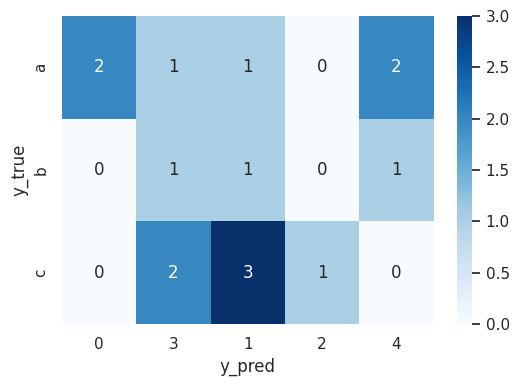

In [ ]:
Serie=list or np.ndarray or pd.Series

def plot_confusion_matrix_heatmap(y_true: Serie,y_pred:Serie, cmap='Blues',figsize=(6,4)):
    """
    plot confusion matrix as heatmap

    Parameters
    ----------
    y_true : labels (number or string list, 1-d array or series)
    y_pred : labels (number or string list, 1-d array or series)
    cmap: colors
    figsize: figure size
    """
    df_cm=conf_matrix_labels(y_true,y_pred)
    plt.figure(figsize=figsize),
    sns.heatmap(df_cm, annot=True, cmap=cmap, fmt='.0f')

#test
plot_confusion_matrix_heatmap(y_true1,y_pred1)

### 1.6.4 Confusion matrix - Approach 2: Associate each predicted cluster with one of the true classesWhen the number of predicted classes is not identical to the number of "true" classes, we can present the confusion matrix between true labels and predicted labels in 2 ways:- Associate each true class with the closest predicted cluster in the diagonal (Approach 1 - "Hungarian clustering algorithm"). Other clusters less close to the true classes are considered as "new" classes - they are ignored for the calculation of the confusion matrix.- Associate each predicted class with the closest true class (approach 2)- it is possible that several predicted classes are associated with a true class (they are treated as a single cluster for the calculation of the confusion matrix),- It can have real classes without any associated clusters.Below are the functions for approach 2

Correspondance des clusters :  [0 2 2 2 0]
new_label  y_pred
0          0         2
           4         3
2          1         5
           2         1
           3         4
Name: count, dtype: int64


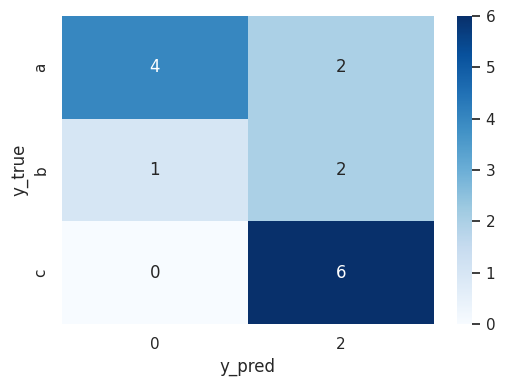

In [ ]:
# from sklearn import metrics
Serie=list or np.ndarray or pd.Series

def conf_mat_transform(y_true:Serie, y_pred:Serie)->pd.Series:
    """
    Associate each y_pred label to closest match of y_true label.
    The returned transformed y_pred series will be labelled numerically,
    corresponding to the index in the sorted set of unique y_true labels
    each y_true label may have 0 to many associated y_pred labels
    Parameters
    ----------
    y_true : labels (number or string list, 1-d array or series)
    y_pred : labels (number or string list, 1-d array or series)
    """
    conf_mat = confusion_matrix_crosstab(y_true, y_pred,False).values
    corresp = np.argmax(conf_mat, axis=0)
    print("Correspondance des clusters : ", corresp)

    y_pred_transform = np.apply_along_axis((lambda x: corresp[x]), 0, y_pred)

    if isinstance(y_pred, pd.Series):
        y_pred_transform=pd.Series(y_pred_transform,name=f'{y_pred.name} (transformed)')
    return y_pred_transform

# test
# besoin de new_labels pour classification_report
new_labels=conf_mat_transform(y_true1,y_pred1)
print(pd.DataFrame({'new_label':new_labels, 'y_pred':y_pred1}).value_counts().sort_index().head())
plot_confusion_matrix_heatmap(y_true1, new_labels)


### 1.6.5 Confusion matrix - Approach 3Approach 1 ensures that KMeans clusters remain the same - this is the approach used to calculate the ARI which remains the same after changing the column orderApproach 2 tries to assign based on the most likely cluster, at the risk of some categories no longer being assigned any clusterWe can get closer to manual heuristics:- Step 1: Maximize the diagonal between true class and predicted cluster (approach 1);- Step 2: Assign the columns that are no longer in the diagonal to the most probable category (approach 2)

[0 3 1 2 4]
Correspondance des clusters : [0 2 2 1 0]
new_label  y_pred
0          0         2
           4         3
1          3         4
2          1         5
           2         1
Name: count, dtype: int64


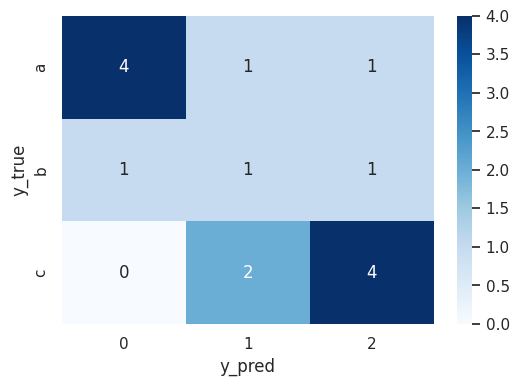

In [ ]:
def conf_matr_relabel(categ_true: Serie, clust_labels: Serie, normalize=False) -> pd.Series:
    df_matr = confusion_matrix_crosstab(
        categ_true, clust_labels, normalize=normalize)

    # L'algorithme a besoin d'une matrice carré
    n_categ = df_matr.shape[0]
    n_labels = df_matr.shape[1]

    square_matr = squarify_df(df_matr).fillna(0)

    # trouve ordre de colonnes et lignes pour maximiser valeurs dans la diagonale
    rows, cols = scipy.optimize.linear_sum_assignment(
        square_matr.values, maximize=True)

    # Supprimer les lignes/colonnes vides après optimisation de la diagonale
    if len(rows) > n_categ:
        rows = [idx for idx in rows if idx < n_categ]
    if len(cols) > n_labels:
        cols = [idx for idx in cols if idx < n_labels]

    print(cols)
    cols_approche_1 = cols[:n_categ]
    cols_approche_2 = np.argmax(df_matr.values, axis=0)
    # corresp = np.argmax(conf_mat, axis=0)
    # print(f'cols_approche_1 : {cols_approche_1}')
    # print(f'cols_approche_2 : {cols_approche_2}')

    corresp = cols_approche_2.copy()
    for i, col_idx in enumerate(cols_approche_1):
        # remplace premières colonnes
        corresp[col_idx] = i

    corresp = np.array(corresp)

    print(f'Correspondance des clusters : { corresp}')
    y_pred_transform = np.apply_along_axis((lambda x: corresp[x]), 0, clust_labels)


    if isinstance(y_pred1, pd.Series):
        y_pred_transform = pd.Series(
            y_pred_transform, name=f'{y_pred.name} (transformed)')
    return y_pred_transform


# besoin de new_labels pour classification_report
new_labels = conf_matr_relabel(y_true1, y_pred1)
print(pd.DataFrame({'new_label': new_labels, 'y_pred': y_pred1}
                   ).value_counts().sort_index().head(10))
plot_confusion_matrix_heatmap(y_true1, new_labels)


### 1.6.6 Displaying the classification report

In [ ]:
# from sklearn.preprocessing import LabelEncoder
# Serie=list or np.ndarray or pd.Series

def print_classification_report(y_true_:Serie,y_pred_:Serie, target_names=None):
    """
    Affiche la classification report, sans besoin d'encoder les labels string en numérique
    """

    if not isinstance(y_pred_, np.ndarray):
        y_pred_= np.array(y_pred_)
    y_true_unique=sorted(list(set(y_true_)))
    if target_names is None:
        target_names= [str(label) for label in y_true_unique]

    is_str_y_true=np.sum([isinstance(label, str) for label in y_true_unique])>0
    is_str_y_pred=np.sum([isinstance(label, str) for label in set(y_pred_)])>0
    mixed_types = (is_str_y_true and not is_str_y_pred) or (is_str_y_pred and not is_str_y_pred)
    if mixed_types:
        # classification report requires y_true and y_pred numeric
        y_encoder=preprocessing.LabelEncoder()
        y_true_num=y_encoder.fit_transform(y_true_)
        print (metrics.classification_report(y_true_num,y_pred_, target_names=target_names, zero_division=0))
    else:
        print (metrics.classification_report(y_true_,y_pred_,target_names=target_names, zero_division=0))

# test
# print_classification_report(y_true_num,y_pred)
# print_classification_report(y_true_num,new_labels)
# print_classification_report(y_true,new_labels)
# print_classification_report(y_true,y_pred)

### 1.6.7 Displaying Classification MetricsTo compare models, we standardize the presentation of metrics- Score ARI- Precision et Recall (Classification Report)- Matrix de Confusion

[0 3 1 2 4]
Correspondance des clusters : [0 2 2 1 0]
ARI = 0.146
              precision    recall  f1-score   support

           a       0.80      0.67      0.73         6
           b       0.25      0.33      0.29         3
           c       0.67      0.67      0.67         6

    accuracy                           0.60        15
   macro avg       0.57      0.56      0.56        15
weighted avg       0.64      0.60      0.61        15

"test_confusion_matrix.png"


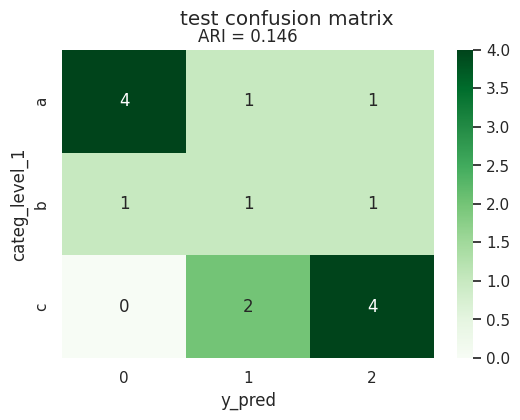

In [ ]:
def calc_ARI(labels_pred, labels_true):
    """Calcul l'Adjusted Rand Index score"""
    return np.round(metrics.adjusted_rand_score(labels_true, labels_pred), 4)

def plot_classification_metrics(y_true_,y_pred_, cmap='Blues', combine=False,target_names=None):
    """
    Plot l'ensemble de classification metrics : score ARI, classification report et confusion matrix
    parameters
    """
    if (len(set(y_true_))<len(set(y_pred_))) or combine:
        # le nombre de clusters y_true et y_pred est different
        # on associe chaque cluster au vrai label la plus proche
        # certain y_true risque d'avoir aucun y_pred associé
        # y_pred_= conf_mat_transform(y_true_, y_pred_)
        y_pred_= conf_matr_relabel(y_true_, y_pred_)
    ari=calc_ARI(y_true_,y_pred_)
    print (f'ARI = {ari:.3f}')
    print_classification_report(y_true_,y_pred_, target_names=target_names)
    plot_confusion_matrix_heatmap(y_true_,y_pred_,cmap=cmap)
    return ari

#test
y_true4=pd.Series(y_true1, name='categ_level_1')
y_pred4=pd.Series(y_pred1, name='labels_LDA')
ari = plot_classification_metrics(y_true4, y_pred4,cmap='Greens')
plt.suptitle('test confusion matrix')
plt.title(f'ARI = {ari:.3f}')
to_png()

15 15
[0 1 2 4 3]
Correspondance des clusters : [0 1 2 4 3]
ARI = -0.018
              precision    recall  f1-score   support

           a       0.50      0.33      0.40         3
           b       0.50      0.67      0.57         3
           c       1.00      0.33      0.50         3
           d       0.50      0.33      0.40         3
           e       0.33      0.67      0.44         3

    accuracy                           0.47        15
   macro avg       0.57      0.47      0.46        15
weighted avg       0.57      0.47      0.46        15



np.float64(-0.0182)

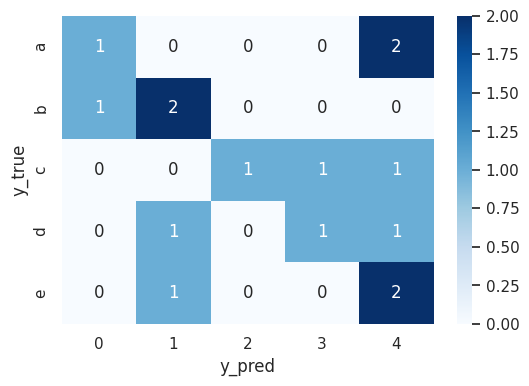

In [ ]:
#test
y_true1=['a','a','a','b','b','b','c','c','c','d','d','d','e','e','e']
y_pred1=[0,3,3,1,0,1,3,2,4,4,3,1,3,1,3]
print(len(y_true1),len(y_pred1))
plot_classification_metrics(y_true1, y_pred1, cmap='Blues', combine=True)

## 1.7 Visualizing clusters on 'reduced_dimensions'

### 1.7.1 KMeans Clustering via TSNE, and ARI Metric CalculationOnce the scores are calculated, the procedures below allow you to visualize

In [ ]:
# from sklearn import decomposition
def reducer_pca(features: pd.Series, n_components=0.99) -> np.ndarray:
    """Reduction de dimensions pour rester avec [99%] de la variance expliquée"""
    print(f'Dimensions avant réduction PCA : { features.shape}')
    pca = decomposition.PCA(n_components=n_components)
    if n_components >= 1:
        param_str = f'(n_components = {n_components})'
    else :
        param_str= f'({n_components*100:.0f} % variance explained)'
    feat_pca = pca.fit_transform(features)
    print(f'Dimensions après réduction PCA {param_str} : {feat_pca.shape}')
    return feat_pca


In [ ]:
# from sklearn import manifold
# import time


def reducer_tsne(features: pd.Series, RANDOM_SEED=42) -> np.ndarray:
    """
    reduction de dimensions par t-SNE

    Parameters
    ---------
    features  numpy array, pd.Series or pd.DataFrame
    """
    time1 = time.time()
    tsne_model = manifold.TSNE(n_components=2, perplexity=30, n_iter=2000,
                               init='random', learning_rate=200, random_state=RANDOM_SEED) # Pass RANDOM_SEED as an argument to the function
    X_tsne = tsne_model.fit_transform(features)
    time2 = np.round(time.time() - time1, 0)
    print(f"t-SNE done! Time elapsed: {time2} seconds")
    return X_tsne


In [ ]:
# from sklearn import cluster, metrics
# import time


def calc_tsne_cluster(features, categories_, y_cat_num_, k=None):
    """
    Calcul Tsne, détermination des clusters et calcul ARI
    entre vraies catégories et n° de clusters
    Parameters
    ----------
    features  les feature vectors, peut-être déjà réduit en dimension par PCA
    categories  les libellés unique des y_true (utilisé seulement pour calculer k si ce n'est pas fourni)
    y_cat_num   les 'vraie' labels (y_true)
    k    le nombre de clusters à calculer

    Returns
    -------
    ARI  si y_cat_num est fourni (-1 sinon)
    X_tsne  les premier 2 composants TSNE (independent de k)
    labels  les cluster.labels_ fitted par KMeans pour k clusters
    """
    X_tsne = reducer_tsne(features)

    if k is None or not k > 0:
        k = len(categories_)

    time1 = time.time()
    # Détermination des clusters à partir des données après Tsne
    cls = cluster.KMeans(n_clusters=k, n_init=100,
                         random_state=RANDOM_SEED)
    cls.fit(X_tsne)
    time2 = np.round(time.time() - time1, 0)
    if len(y_cat_num_) == len(cls.labels_):
        ARI = np.round(metrics.adjusted_rand_score(y_cat_num_, cls.labels_), 4)
        print("ARI : ", ARI, "time : ", time2)
    else:
        ARI = -1
        print('ARI ne peut pas être calculé : len(y_true) != len(y_pred)')

    # ajout cls.cluster_centers_ ?
    return ARI, X_tsne, cls.labels_


### 1.7.2 Visualization on the first 2 reduced dimensions (PCA/t_SNE)

In [ ]:

#
def plot_clusters_sur_2D(X_tsne_, y_cat_num_, labels_, ARI_,
                         bbox_left=-0.05, loc=1,
                         palette='bright',
                         titre1='Représentation des produits par catégories réelles',
                         titre2='Représentation des produits par clusters'):
    """
    Visualisation du Tsne selon les vraies catégories et selon les clusters
    """
    if ARI_ is None:
        ARI_ = calc_ARI(y_cat_num_, labels_)
    df_opt = conf_matrix_labels(y_cat_num_, labels_)

    # s_labels=pd.Series(labels_).map(label_map)
    s_labels = pd.Series(labels_)

    # mettre l'ordre des clusters dans la même ordre que les y_cat
    labels_hue_order = list(df_opt.columns)
    n_labels = len(labels_hue_order)

    categ_hue_order = sorted(list(pd.Series(y_cat_num_).unique()))
    n_categ = len(categ_hue_order)

    n_max = max(n_labels, n_categ)
    colors = sns.color_palette(palette, n_colors=n_max)
    # print (colors)
    labels_palette = colors[:n_labels]
    categ_palette = colors[:n_categ]
    fig = plt.figure(figsize=(15, 6))

    ax1 = fig.add_subplot(121)
    scatter1 = sns.scatterplot(x=X_tsne_[:, 0], y=X_tsne_[:, 1], ax=ax1,
                               hue=y_cat_num_, hue_order=categ_hue_order, palette=categ_palette)
    ax1.legend(title="Catégorie", bbox_to_anchor=(bbox_left, 0.5), loc=loc)
    plt.title(titre1)

    ax2 = fig.add_subplot(122)
    scatter2 = sns.scatterplot(x=X_tsne_[:, 0], y=X_tsne_[:, 1], ax=ax2,
                               hue=s_labels, hue_order=labels_hue_order, palette=labels_palette)
    ax2.legend(loc="best", title="Clusters")
    plt.title(titre2)
    print("ARI : ", ARI_)
    return fig


## 1.8 Sankey Diagram (Confusion Matrix Visualization)

In [ ]:
def add_model_score(df:pd.DataFrame=None,model_name:str='none', ARI:float=0,k:int=0,**kwargs):
    global df_resultats
    if df is None:
        df=df_resultats
    """ajout les resultats d'un model """
    resultats=dict(model=model_name, ARI=ARI,k=k)
    resultats=dict(**resultats,**kwargs)
    # Use pd.concat instead of df.append
    df = pd.concat([df, pd.DataFrame([resultats])], ignore_index=True) # Create a DataFrame from resultats and concatenate
    df['k']=df['k'].astype(int)
    return df

# test
add_model_score(pd.DataFrame(), optimizer='adam',k=7)

,model,ARI,k,optimizer
0,none,0,7,adam


In [ ]:
# import plotly.graph_objects as go
# from IPython import display
# import plotly.io as pio


def add_alpha(color, alpha):
    (r, g, b) = color
    return f'rgba({r},{g},{b},{alpha})'


def plot_sankey_confusion_diagram(source: pd.Series, target: pd.Series = None,
                                  titre='Sankey confusion diagram',
                                  descriptors=['categories', 'clusters'],
                                  figsize=(2, 1), font_size=14,
                                  to_image=True,
                                  palette='nipy_spectral', alpha=0.5):
    """
    Plot confusion matrix as a Sankey diagram
    Accepts data in form of :
    - two series / lists (series names used as descriptors)
    - confusion matrix as a pandas dataframe (axes names used as descriptors)
    - confusion matrix as a numpy array (use parameter descriptors for source and target)

    Requires plotly,kaleido
    """
    # on peut fournir deux series (y_true, y_pred),
    if isinstance(source, pd.DataFrame) or len(source) < 10:
        ct = source.copy()
        if isinstance(ct, np.ndarray):
            print('ct is numpy array')
            ct = pd.DataFrame(ct)
            ct = ct.rename_axis(descriptors[0], axis=0)
            ct = ct.rename_axis(descriptors[1], axis=1)
    else:
        if isinstance(source, np.ndarray):
            source = pd.Series(source, name=descriptors[0])
        if isinstance(target, np.ndarray):
            target = pd.Series(target, name=descriptors[1])
        ct = pd.crosstab(source, target)

    source_col = ct.index.name if ct.index.name else descriptors[0]
    target_col = ct.T.index.name if ct.T.index.name else descriptors[1]
    print(source_col, target_col)

    ct.index = ct.index.astype(str)
    ct.columns = ct.columns.astype(str)

    # replace source and target labels with unique node_ids
    node_labels = list(ct.index)+list(ct.columns)
    node_ids = range(len(node_labels))
    label_map = dict(zip(node_ids, node_labels))

    # create colors for unique nodes (nodes with same name have same color)
    # uniq_nodes = sorted(list(set(node_labels)))
    uniq_nodes = []
    for node in node_labels:
        if not node in uniq_nodes:
            uniq_nodes.append(node)
    colors = sns.color_palette(palette, n_colors=len(uniq_nodes))
    solid_color_map = dict(zip(uniq_nodes, colors.as_hex()))
    node_colors = list(pd.Series(node_labels).map(solid_color_map))

    # create semi-transparent colors for links (link color same as source node)
    alpha_colors = list([add_alpha(color, alpha) for color in colors])
    alpha_color_map = dict(zip(uniq_nodes, alpha_colors))

    # map (possibly duplicate) node_labels to unique node_ids

    ct.index = node_ids[:len(ct.index)]
    ct.index.name = source_col
    ct.columns = node_ids[-len(ct.columns):]

    # create [source,target,value,color] matrix for links
    data = pd.melt(ct.reset_index(), id_vars=source_col)
    print(data.shape)
    print(data.columns)
    data.columns = [source_col, target_col, 'value']
    data = data[data['value'] > 0]
    data['src_color'] = data[source_col].map(label_map).map(alpha_color_map)

    # send data to plotly figure
    fig = go.Figure(data=[
        go.Sankey(node=dict(label=node_labels, color=node_colors),
                  link=dict(source=data[source_col], target=data[target_col],
                    value=data['value'], color=data['src_color'])
                  )
    ])

    titre = f'{titre} : {source_col} vs. {target_col}'
    fig.update_layout(title_text=titre, title_x=0.5, font_size=font_size)

    if to_image:
        # requires package 'kaleido'
        w, h = figsize
        fig_name = sanitize(titre)
        filename = f'{IMAGE_FOLDER}/{fig_name}.png'
        pio.write_image(fig, file=filename, format="png")
        img = fig.to_image(format="png", width=w, height=h, scale=1)
        # from IPython import display
        return display.Image(img)
    else:
        fig.show()


## 1.9 Accumulation of model performance

In [ ]:
df_resultats = pd.DataFrame()
def add_model_score(df:pd.DataFrame=None,model_name:str='none', ARI:float=0,k:int=0,**kwargs):
    global df_resultats
    if df is None:
        df=df_resultats
    """ajout les resultats d'un model """
    resultats=dict(model=model_name, ARI=ARI,k=k)
    resultats=dict(**resultats,**kwargs)
    # Use pd.concat instead of df.append
    df = pd.concat([df, pd.DataFrame([resultats])], ignore_index=True) # Create a DataFrame from resultats and concatenate
    df['k']=df['k'].astype(int)
    return df

# test
add_model_score(pd.DataFrame(), optimizer='adam',k=7)

,model,ARI,k,optimizer
0,none,0,7,adam


#2. Import, cleaning and exploratory analysis of dataA first set of article data with the photo and an associated description:[the link to download](https://s3-eu-west-1.amazonaws.com/static.oc-static.com/prod/courses/files/Parcours_data_scientist/Projet+-+Textimage+DAS+V2/Dataset+projet+pre%CC%81traitement+textes+images.zip)Once downloaded, the data from the zip file (329 MB) is extracted into the folder defined by DATA_FOLDER below.

In [ ]:
ENV = 'local'

if ENV == 'local':
    # local development
    DATA_FOLDER = 'data/raw'
    OUT_FOLDER = 'data/out'
    IMAGE_FOLDER = 'images/cv'

if ENV == 'colab':
    # Colaboratory - uncomment les 2 lignes suivant pour connecter à votre drive
    # from google.colab import drive
    # drive.mount('/content/drive')
    DATA_FOLDER = '/content/drive/MyDrive/data/OC6'
    OUT_FOLDER = '/content/drive/MyDrive/data/OC6'
    IMAGE_FOLDER = '/content/drive/MyDrive/images/OC6/cv'


In [ ]:
# Données (DATA_FOLDER)
ZIPPED_DATA_FILENAME = f'Dataset+projet+prétraitement+textes+images.zip'
RAW_DATA_FILENAME = 'Flipkart/flipkart_com-ecommerce_sample_1050.csv'


def os_make_dir(folder):
    if not os.path.exists(folder):
        os.makedirs(folder)


def os_path_join(folder, file):
    """remplacement pour `os.path.join(folder, file)` sur windows"""
    return f'{folder}/{file}'


os_make_dir(IMAGE_FOLDER)
RAW_DATA = os_path_join(DATA_FOLDER, RAW_DATA_FILENAME)
DATA_ZIPPED = os_path_join(DATA_FOLDER, ZIPPED_DATA_FILENAME)
print(f'data file: {RAW_DATA}')


data file: data/raw/Flipkart/flipkart_com-ecommerce_sample_1050.csv


In [ ]:
def unzip_data_si_besoin(env=ENV):
    """
    procedure pour unzip sur Google Drive via Google Colab
    """
    if os.path.exists(RAW_DATA):
        print(f'data CSV file exists ({RAW_DATA})')
    else:
        print(f'data CSV file does not exist ({RAW_DATA})')
        if env == 'colab' and os.path.exists(DATA_ZIPPED):
            # uncomment les 3 lignes suivantes
            print(f'unzipping {DATA_ZIPPED}')
            !unzip {DATA_ZIPPED} - d {DATA_FOLDER}
            print(f'{DATA_ZIPPED} has been unzipped')
            if os.path.exists(RAW_DATA):
                print(f'data CSV file now exists ({RAW_DATA})')
        else:
            print(f'zipped data does not exist ({DATA_ZIPPED})')


unzip_data_si_besoin(ENV)


data CSV file exists (data/raw/Flipkart/flipkart_com-ecommerce_sample_1050.csv)


## 2.1 Importing text data to retrieve imagesText data is processed in Part 1.We recreate the category columns, then delete the columns not useful for classification

In [ ]:
df_data = pd.read_csv(RAW_DATA, sep=',', header=0, encoding='UTF-8')
print(list(df_data.columns))


['uniq_id', 'crawl_timestamp', 'product_url', 'product_name', 'product_category_tree', 'pid', 'retail_price', 'discounted_price', 'image', 'is_FK_Advantage_product', 'description', 'product_rating', 'overall_rating', 'brand', 'product_specifications']


### 2.1.1 Preparation of categoriesFeatures to create from the `product_category_tree`:- `categ_level_1`: the categories at the root of the tree- `categ_level_2`: subcategories (divisions in `categ_level_1`)- `categ_level_3`: mini-categories (divisions in `categ_level_2`)

In [ ]:
def create_categ_level(df, max_depth=3):
    if not 'product_category_tree' in df.columns:
        return df
    else:
        df_cat = (df_data['product_category_tree']
                  .str.lstrip('["').str.rstrip('"]').str.split(' >>', expand=True))
        df_cat = df_cat[df_cat.columns[range(max_depth)]]
        df_cat.columns = [f'categ_level_{i}' for i in range(1, max_depth+1)]
        return pd.concat([df, df_cat], axis=1)


df_data.pipe(create_categ_level).iloc[:, -3:].head()


,categ_level_1,categ_level_2,categ_level_3
0,Home Furnishing,Curtains & Accessories,Curtains
1,Baby Care,Baby Bath & Skin,Baby Bath Towels
2,Baby Care,Baby Bath & Skin,Baby Bath Towels
3,Home Furnishing,Bed Linen,Bedsheets
4,Home Furnishing,Bed Linen,Bedsheets


### 2.1.2 Elimination of columns not relevant to the problemBefore doing feature engineering, we delete the columns not used for classification

In [ ]:
def drop_unused_columns(df):
    """Supprimer les colonnes qui ne sont pas pertinentes"""
    colonnes_non_pertinentes = ['uniq_id', 'crawl_timestamp', 'product_url', 'product_category_tree',
                                'retail_price', 'discounted_price',
                                'is_FK_Advantage_product', 'product_rating', 'overall_rating', 'product_specifications']
    cols_to_drop = cols_in_df(df, colonnes_non_pertinentes)
    print(f'dropping {len(cols_to_drop)} unused columns')
    return df.drop(columns=cols_to_drop)


df_data = (
    pd.read_csv(RAW_DATA, sep=',', header=0, encoding='UTF-8')
    .pipe(create_categ_level)
    .pipe(drop_unused_columns)
)
print(list(df_data.columns))
print(df_data.shape)


dropping 10 unused columns
['product_name', 'pid', 'image', 'description', 'brand', 'categ_level_1', 'categ_level_2', 'categ_level_3']
(1050, 8)


In [ ]:
df_data.head(2)


,product_name,pid,image,description,brand,categ_level_1,categ_level_2,categ_level_3
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,CRNEG7BKMFFYHQ8Z,55b85ea15a1536d46b7190ad6fff8ce7.jpg,"Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegan...",Elegance,Home Furnishing,Curtains & Accessories,Curtains
1,Sathiyas Cotton Bath Towel,BTWEGFZHGBXPHZUH,7b72c92c2f6c40268628ec5f14c6d590.jpg,"Specifications of Sathiyas Cotton Bath Towel (3 Bath Towel, Red, Yellow, Blue) Bath Towel Featur...",Sathiyas,Baby Care,Baby Bath & Skin,Baby Bath Towels


### 2.1.3 Variables for comparing categories#### Encode level 1 categories

In [ ]:
# from sklearn import preprocessing
cat_encoder = preprocessing.LabelEncoder()

# list des catégories de niveau 1
l_cat = sorted(list(set(df_data['categ_level_1'])))
l_cat_num = cat_encoder.fit_transform(l_cat)

# map de catégories
cat_map = dict(zip(l_cat_num, l_cat))
print("catégories : ", cat_map)
cat_encoder.inverse_transform(l_cat_num)


y_cat_num = cat_encoder.fit_transform(df_data['categ_level_1'])
y_cat_txt = df_data['categ_level_1'].copy()

cat_encoder.inverse_transform([1, 0, 5, 6])


catégories :  {np.int64(0): 'Baby Care', np.int64(1): 'Beauty and Personal Care', np.int64(2): 'Computers', np.int64(3): 'Home Decor & Festive Needs', np.int64(4): 'Home Furnishing', np.int64(5): 'Kitchen & Dining', np.int64(6): 'Watches'}


array(['Beauty and Personal Care', 'Baby Care', 'Kitchen & Dining',
       'Watches'], dtype=object)

#### Encode level 2 categories

In [ ]:
# from sklearn import preprocessing
cat2_encoder = preprocessing.LabelEncoder()

# list des catégories de niveau 1
l_cat2 = sorted(list(set(df_data['categ_level_2'])))
print(len(l_cat2))
l_cat2_num = cat2_encoder.fit_transform(l_cat2)

# map de catégories
cat2_map = dict(zip(l_cat_num, l_cat))
# print("catégories 2: ", cat_map)
cat2_encoder.inverse_transform(l_cat_num)


y_cat2_num = cat2_encoder.transform(df_data['categ_level_2'])
y_cat2_txt = df_data['categ_level_2'].copy()

cat2_encoder.inverse_transform([1, 0, 50, 61])


62


array([' Baby Bath & Skin', ' Baby & Kids Gifts', ' Showpieces',
       ' Wrist Watches'], dtype='<U32')

### 2.1.4 Importing images (reading)The images are unzipped from the zip file into the subfolder `DATA_FOLDER/Flipkart/Images'

In [ ]:
# import os
IMG_FOLDER = f'{DATA_FOLDER}/Flipkart/Images' # remove /cv from the path

os.listdir(IMG_FOLDER)[:5]


['9823c07cc256788556e424307f5ae9b6.jpg',
 '4451f1b01168b6a085738d0b0f2f02aa.jpg',
 'c7d81193e868b50355412ced7a67f8f3.jpg',
 '5e52d6ce133e5307814f9f3eedc5806d.jpg',
 'd86f260ff28af531443f822c11746521.jpg']

In [ ]:
# import os
path = IMG_FOLDER
LIST_PHOTOS = [file for file in os.listdir(path)]
print(len(LIST_PHOTOS))


1051


In [ ]:
# import os

def add_image_idx(df: pd.DataFrame, path=IMG_FOLDER):
    """Faire un lien entre l'ordre des images dans dossier"""
    df = df.copy()
    list_photos = [file for file in os.listdir(path)]
    for i, file_name in enumerate(list_photos):
        image_name = ' '.join(file_name.split('/')[-1:])
        image_name = ' '.join(image_name.split('\\')[-1:])
        filtre = df['image'].str.contains(image_name, case=False, regex=False)
        df.loc[filtre, 'image_idx'] = i
    df['image_idx'] = df['image_idx'].astype(int)
    return df


df_data = df_data.pipe(add_image_idx)


In [ ]:
print(df_data['image_idx'].isna().sum())
df_data[['product_name', 'image_idx']].head()


0


,product_name,image_idx
0,Elegance Polyester Multicolor Abstract Eyelet Door Curtain,187
1,Sathiyas Cotton Bath Towel,101
2,Eurospa Cotton Terry Face Towel Set,373
3,SANTOSH ROYAL FASHION Cotton Printed King sized Double Bedsheet,958
4,Jaipur Print Cotton Floral King sized Double Bedsheet,61


### Find image by product_name

In [ ]:
def image_idx(image_filename='a3dea07b2f7bf48276d32513091be717.jpg'):
    for i, filepath in enumerate(LIST_PHOTOS):
        if image_filename in filepath:
            return i
    return -1


image_idx('6329ddb46087cb8c09ced')


284

In [ ]:
def get_image_from_product_name(df: pd.DataFrame = df_data, name='BFT 6 W LED Bulb', nb=50):
    if name is None:
        return
    products = df[df['product_name'].str.contains(
        name, case=False, regex=True)]
    if len(products) > 0:
        print(len(products))
        nb = min(nb, len(products))
        return products[['product_name', 'image']][:nb]


get_image_from_product_name(name='USB fan')


7


,product_name,image
53,JRB 1038 Smallest Mobile Powered By OTG Enabled Android Smart Phone Portable 1038 USB Fan,6329ddb46087cb8c09ced95471dd9643.jpg
54,JRB 1033 Smallest Mobile Powered By OTG Enabled Android Smart Phone Portable 1033 USB Fan,7e6ae1b372e8e0b509b83ba3658b8107.jpg
55,JRB 1042 Smallest Mobile Powered By OTG Enabled Android Smart Phone Portable 1042 USB Fan,e2ae2af58ac50adf4881751ae84a9d8a.jpg
843,Epresent Mfan 1 Fan USB USB Fan,e86daf9ebcdfc5c5dd088cdb7f8f8db6.jpg
849,QP360 Kid Fan 01 MLY2015 USB USB Fan,c612bdfa459e1e2f20d57348336c24be.jpg
856,Lifestyle-You IG43_04 USB USB Fan,568f331e1039bf2e0635b899c2b3248f.jpg
860,Dizionario Mini Perfume Fan Cooling Fancoolerbl USB USB Fan,6136976dc5a433cdf8e2559b8510bdce.jpg


In [ ]:
def short_name(name, maxchars=20):
    # return ' '.join(str(name).split(' ')[-2:])
    while len(name) > maxchars:
        name_w = str(name).split(' ')
        name = ' '.join(str(name).split(' ')[-(len(name_w)-1):])
    return name


def get_product_name_from_filename(df=df_data, filename='32513091be717.jpg', short=False):
    if filename is None:
        return
    image_name = ' '.join(filename.split('/')[-1:])
    image_name = ' '.join(image_name.split('\\')[-1:])
    products = df[df['image'].str.contains(
        image_name, case=False, regex=False)]
    if len(products) > 0:
        name = ','.join(products['product_name'].values)
        return short_name(name) if short else name


get_product_name_from_filename(short=True)


'BFT 6 W LED Bulb'

### Reading an image

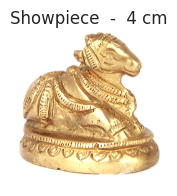

In [ ]:
# from PIL import Image
# import os


def preview_image(filename=None, img=None, seed=None, ax=None, titre=None,
                  preprocess_fct=None,
                  preprocess_params={},
                  file_path=IMG_FOLDER):
    if img is None:
        if filename is None:
            if seed is None:
                seed = np.random.randint(0, 1050)
            # seed = 352
            filename = os.listdir(IMG_FOLDER)[seed]

        # Charger l'image
        if file_path is None:
            img = Image.open(filename)
        else:
            img = Image.open(f'{IMG_FOLDER}/{filename}')

    if not preprocess_fct is None:
        img = preprocess_fct(img, preprocess_params)

    # Afficher l'image chargée dans jupyter
    if ax is None:
        fig = plt.figure(figsize=(2, 2))
        ax = plt.gca()
    ax.imshow(img, cmap='gray')
    ax.set_axis_off()

    if titre is None:
        titre = get_product_name_from_filename(filename=filename, short=True)
    ax.set_title(titre)


preview_image(seed=598)


### Displaying sample images by label (category level 1)

"Test_Preview_Images.png"


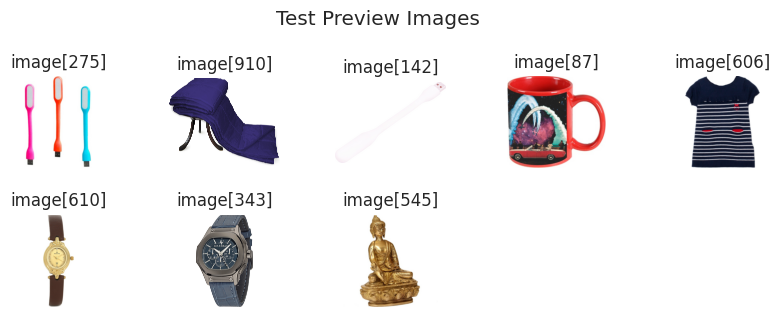

In [ ]:
def preview_images(filenames, titles, titre,
                   preprocess_fct=None,
                   preprocess_params={}):
    n_cols = min(5,len(filenames))
    n_rows = len(filenames) // n_cols + (len(filenames) % n_cols > 0)
    fig = plt.figure(figsize=(n_cols*2, n_rows+1))
    for n, filename in enumerate(filenames):
        if len(titles) > n:
            image_title = short_name(' '.join(str(titles[n]).split(' ')))
        else:
            image_title = get_product_name_from_filename(
                filename=filename, short=True)
        ax = plt.subplot(n_rows, n_cols, n + 1)
        preview_image(filename, titre=image_title, ax=ax,
                      preprocess_fct=preprocess_fct, preprocess_params=preprocess_params)
    plt.subplots_adjust(hspace=0.5, wspace=0.5)
    fig.suptitle(titre, y=1.1)
    to_png()
    plt.show()

SAVE_IMAGES = True
IMAGE_FOLDER = 'images/cv'
if not os.path.exists(IMAGE_FOLDER):
    os.makedirs(IMAGE_FOLDER) # This line creates the directory if it doesn't exist
# seeds= np.random.randint(0, 1050,8)
seeds = [275, 910, 142, 87, 606, 610, 343, 545]
filenames = [os.listdir(IMG_FOLDER)[seed] for seed in seeds]
titles = [f'image[{seed}]' for seed in seeds]
preview_images(filenames, titles, titre='Test Preview Images')


"Home_Furnishing.png"


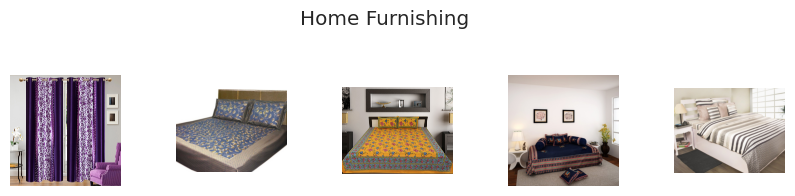

"Baby_Care.png"


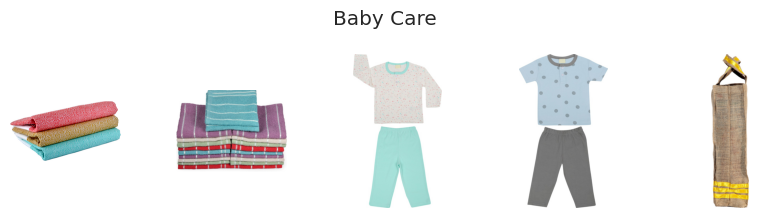

"Watches.png"


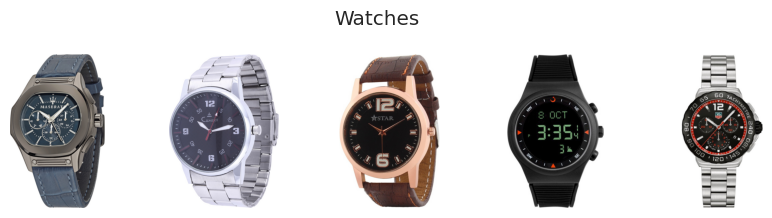

"Home_Decor_&_Festive_Needs.png"


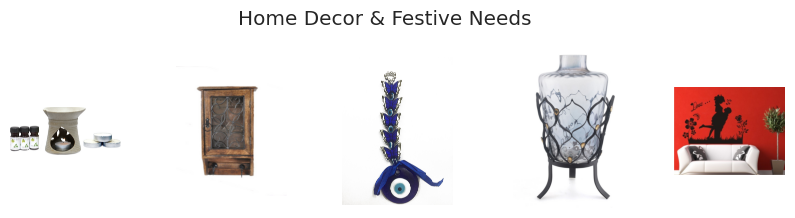

"Kitchen_&_Dining.png"


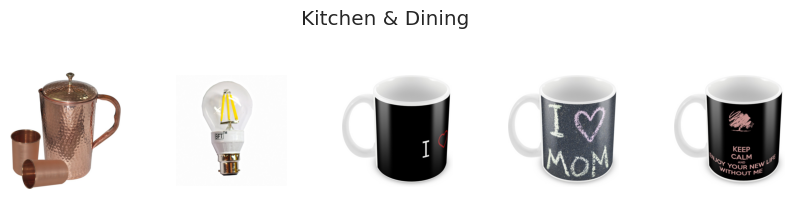

"Beauty_and_Personal_Care.png"


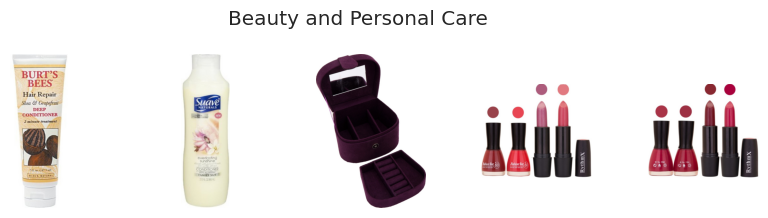

"Computers.png"


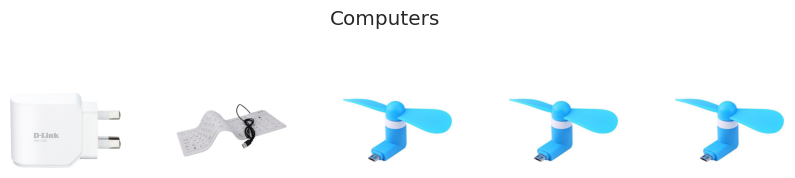

In [ ]:
def preview_images_by_category(df, categ_col='categ_level_1',
                               feature='image', nb=5,
                               preprocess_fct=None,
                               preprocess_params={},
                               show_titles=False
                               ):
    """Echantillon d'images par catégorie"""
    categories = df[categ_col].unique()
    for n, category in enumerate(categories):
        filenames = df[df[categ_col] == category][feature]
        product_names = df[df[categ_col] == category]['product_name']
        nb_im = min(nb, len(filenames))
        filenames = list(filenames[:nb_im])
        product_names = list(product_names[:nb_im]) if show_titles else ['' for i in range(nb_im)]
        preview_images(filenames, titles=product_names, titre=category,
                       preprocess_fct=preprocess_fct, preprocess_params=preprocess_params)


preview_images_by_category(df_data, nb=5)


In [ ]:
df_data.duplicated(subset=['image']).sum()


np.int64(0)

There is a unique image for each product, although the images may be identical.

## 2.2 Cleaning (preprocessing) of image dataImages may need preprocessing, which depends on the machine learning model- conversion de FileFormat- Egalisation d'exposition (`PIL.ImageOps.autocontrast`)- Egalisation de contrast (`PIL.ImageOps.equalize` )- Noise filtering (`PIL.Image.filter.GaussianBlur`)- Noise filtering (`PIL.Image.filter.MedianFilter`)- conversion to gray (reduction of color dimensions)- size reduction (square, fill)We create procedures below

### Witness image- images to test preprocessing procedures> Seeds: [854 ,393, 203, 902, 756 ]

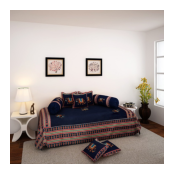

In [ ]:

def get_image(seed=None):
    """Fonction pour récupérer une image témoin à tester"""
    if seed is None:
        nb_files = len(os.listdir(IMG_FOLDER))
        seed = np.random.randint(0, nb_files)
        print(f'get_image {seed}')
    filename = os.listdir(IMG_FOLDER)[seed]
    # Charger l'image
    return Image.open(f'{IMG_FOLDER}/{filename}')


# image témoins pour tester
IMG_FAN = get_image(393)  # USB fan
IMG_BULB = get_image(695)  # light bulb
IMG_PIZZA = get_image(854)  # pizza cutter
IMG_LIP = get_image(225)  # lipsticks
IMG_BED = get_image(909)  # dark bed

TEMOINS = [225, 393, 695, 854, 225, 909]
# IMG = get_image()
IMG = IMG_BED
preview_image(img=IMG_FAN)


### Visualization of an image and its histogram- <https://datacarpentry.org/image-processing/05-creating-histograms/>

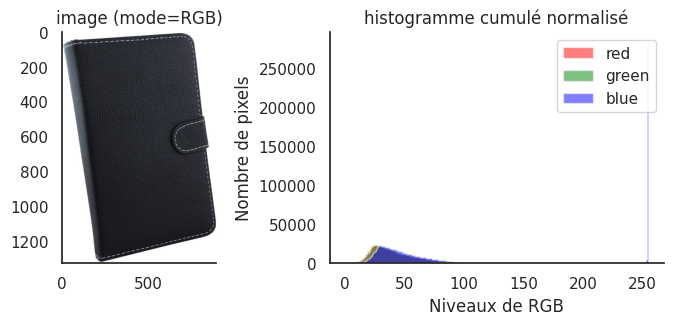

In [ ]:
# from PIL import Image
def plot_image_histogram(img, cumul_=False, density_=False, histtype_='stepfilled'):
    if type(img) == np.ndarray:
        img_ = img
        img = Image.fromarray(img)
    else:
        img_ = np.array(img)
        img = img
    fig = plt.figure(figsize=(8, 3))
    gs = fig.add_gridspec(1,9)
    ax = plt.subplot(gs[:, :3])
    ax.imshow(img_, cmap='gray')
    ax.set_title(f'image (mode={img.mode})')

    # Générer et afficher l'histogramme
    # Pour le normaliser : argument density=True dans plt.hist
    # Pour avoir l'histogramme cumulé : argument cumulatif=True
    ax = plt.subplot(gs[:, 4:])
    if len(img_.shape) == 3:
        for channel_id, color in enumerate(['red', 'green', 'blue']):
            plt.hist(img_[:, :, channel_id].flatten(), bins=range(256), cumulative=cumul_,
                     color=color, alpha=0.5, label=color, density=density_, histtype=histtype_)
        plt.legend(loc='upper right')
    else:
        # n, bins, patches =
        color = 'gray'
        plt.hist(img_.flatten(), bins=range(256), cumulative=cumul_,
                 color=color, alpha=0.5, label=color, density=density_, histtype=histtype_)
        plt.legend(loc='upper right')

    xlabel = 'RGB' if img.mode == 'RGB' else 'gris'
    ax.set_xlabel(f'Niveaux de {xlabel}')

    if cumul_:
        ax.set_ylabel('Nombre de pixels cumulé')
    else:
        ax.set_ylabel('Nombre de pixels')

    ax.set_title('histogramme cumulé normalisé')
    sns.despine()
    plt.subplots_adjust(wspace=0.5)


# plot_image_histogram(IMG)
# plot_image_histogram(IMG,histtype_='step')
plot_image_histogram(IMG, histtype_='stepfilled')


### Convert to gray (reduce color dimensions)

In [ ]:
# from PIL import Image


def get_image_mode(img):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    mode = img.mode
    print(f'Image mode : {mode}')
    return mode


get_image_mode(IMG)


Image mode : RGB


'RGB'

"histogram_-_grayscale.png"


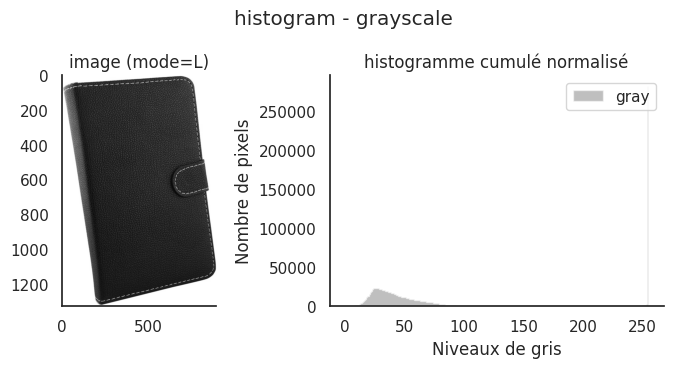

In [ ]:
# from PIL import Image
# from PIL.ImageOps import grayscale


def img_to_gray(img):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return ImageOps.grayscale(img)


plot_image_histogram(img_to_gray(IMG))
plt.suptitle('histogram - grayscale', y=1.1)
to_png()

"histogram_-_opaque.png"


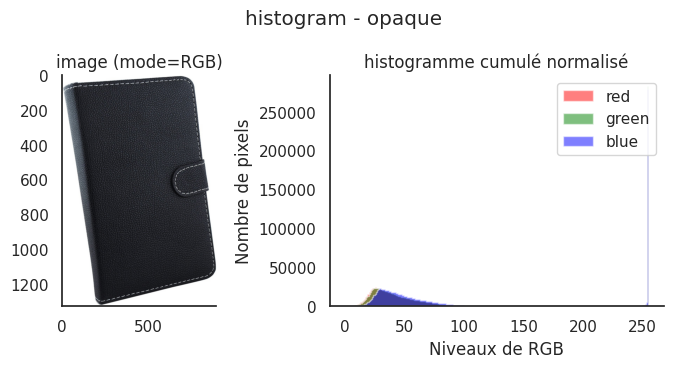

In [ ]:
# from PIL import Image


def img_opaque(img, bg_colour=(255, 255, 255)):
    """Remove image transparency (https://stackoverflow.com/a/35859140/)"""
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    if img.mode in ('RGBA', 'LA') or (img.mode == 'P' and 'transparency' in img.info):
        print('image has transparency')
        # Need to convert to RGBA if LA format due to a bug in PIL (http://stackoverflow.com/a/1963146)
        alpha = img.convert('RGBA').split()[-1]

        # Create a new background image of our matt color.
        # Must be RGBA because paste requires both images have the same format
        # (http://stackoverflow.com/a/8720632  and  http://stackoverflow.com/a/9459208)
        bg = Image.new("RGBA", img.size, bg_colour + (255,))
        bg.paste(img, mask=alpha)
        return bg
    return img


plot_image_histogram(img_opaque(IMG))
plt.suptitle('histogram - opaque', y=1.1)
to_png()

### Exposure EqualizationUsing (`PIL.ImageOps.autocontrast`)

"histogram_-_autocontrast.png"


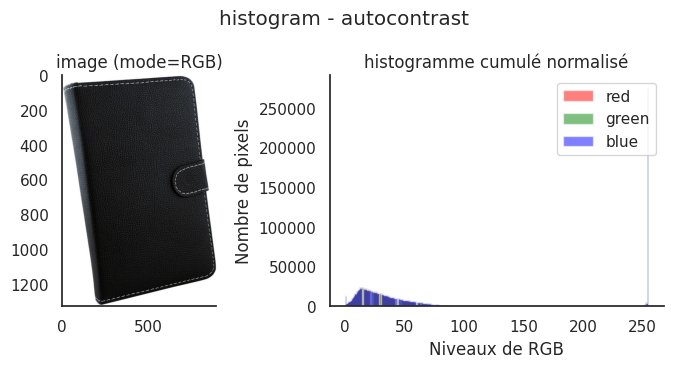

In [ ]:
# from PIL.ImageOps import autocontrast
# from PIL import Image


def img_contrast(img, cutoff=1):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    img_etire = ImageOps.autocontrast(img, cutoff=cutoff)
    return img_etire


plot_image_histogram(img_contrast(IMG))
plt.suptitle('histogram - autocontrast', y=1.1)
to_png()

### Contrast equalization with PIL(`PIL.ImageOps.equalize` )

"histogram_-_equalize_(PIL).png"


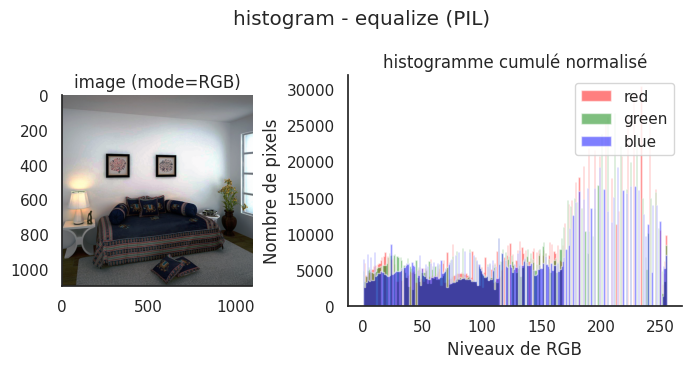

In [ ]:
# from PIL.ImageOps import equalize
# from PIL import Image

def img_equalize_pil(img):
    """equalize histogram using PIL"""
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return ImageOps.equalize(img)


# IMG_FAN et IMG_BULB ne marche pas bien
plot_image_histogram(img_equalize_pil(IMG_FAN))
plt.suptitle('histogram - equalize (PIL)', y=1.1)
to_png()

### Contrast equalization with openCV(`cv2.equalizeHist` )- <https://pythonmana.com/2021/10/20211007114859814f.html>

"histogram_-_equalize_(openCV).png"


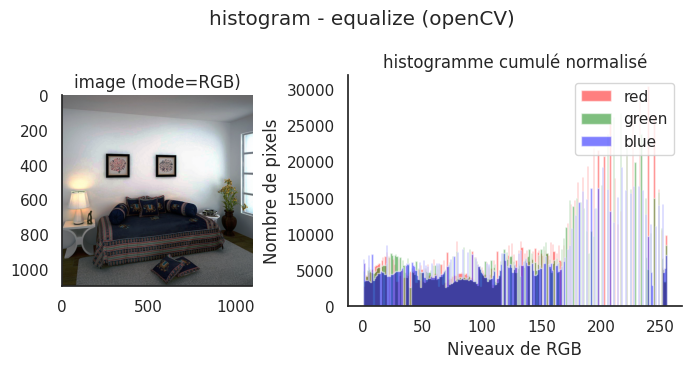

In [ ]:

# import cv2


def img_equalize_hist(img):
    """equalize histogram using openCV"""
    # else : # use cv2
    if type(img) != np.ndarray:
        img = np.array(img)

    if len(img.shape) == 3:
        channels = cv2.split(img)
        eq_channels = []
        for ch in channels:
            eq_channels.append(cv2.equalizeHist(ch))
        eq_image = cv2.merge(eq_channels)
        return eq_image
    else:
        return cv2.equalizeHist(img)


plot_image_histogram(img_equalize_hist(IMG_FAN))
plt.suptitle('histogram - equalize (openCV)', y=1.1)
to_png()

### Contrast equalization with CLAHEContrast Limited Adaptive Histogram Equalization(`cv2.ImageOps.equalize` )- <https://pythonmana.com/2021/10/20211007114859814f.html#3__169>

"histogram_-_equalize_(CLAHE).png"


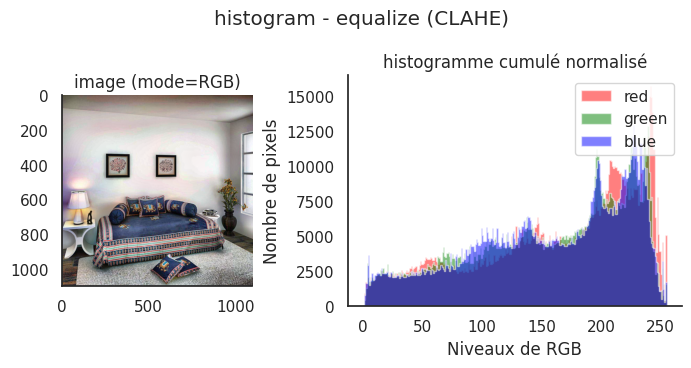

In [ ]:
# import cv2


def img_equalize_clahe(img, clip_limit=4.0):
    """equalize histogram using CLAHE"""
    if type(img) != np.ndarray:
        img = np.array(img)

    clahe = cv2.createCLAHE(clipLimit=clip_limit)

    if len(img.shape) == 3:
        channels = cv2.split(img)
        eq_channels = []
        for ch in channels:
            eq_channels.append(clahe.apply(ch))
        eq_image = cv2.merge(eq_channels)
        return eq_image
    else:
        return clahe.apply(img)


plot_image_histogram(img_equalize_clahe(IMG_FAN))
plt.suptitle('histogram - equalize (CLAHE)', y=1.1)
to_png()

### Noise Filtering- (`PIL.Image.filter.GaussianBlur`)

"histogram_-_gaussian_blur_(radius=20).png"


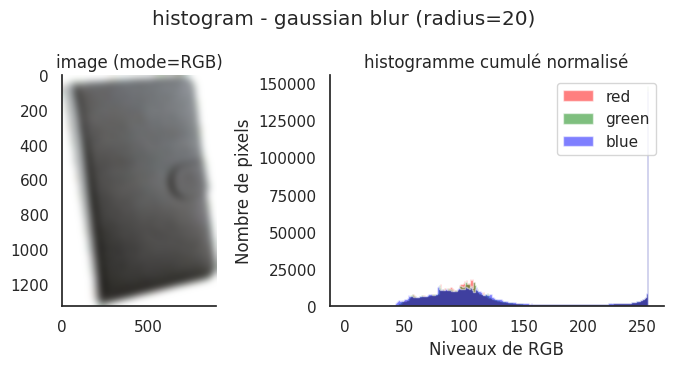

In [ ]:
# from PIL.ImageFilter import GaussianBlur


def img_gaussian_blur(img, radius=3):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    return img.filter(ImageFilter.GaussianBlur(radius))


plot_image_histogram(img_gaussian_blur(
    img_equalize_hist(img_contrast(IMG)), radius=20))
plt.suptitle('histogram - gaussian blur (radius=20)', y=1.1)
to_png()


### Noise filtering (`PIL.Image.filter.MedianFilter`)This filter is non-linear which gives the best results but takes more time.

Text(0.5, 1.1, 'histogram - equalized median blur (size=3)')

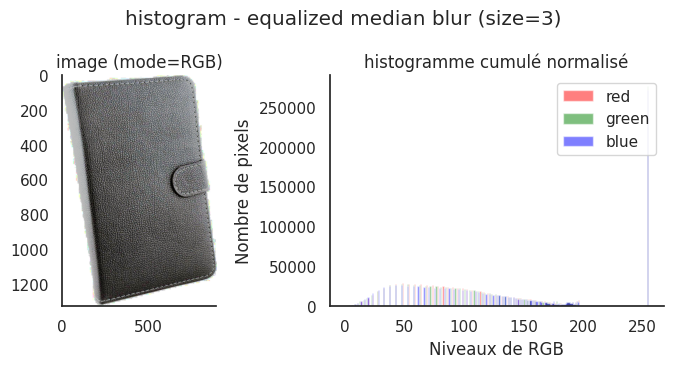

In [ ]:
# from PIL import Image
# from PIL.ImageFilter import MedianFilter


def img_median_blur(img:Image or np.ndarray, size=3)->Image:
    if isinstance(img,np.ndarray):
        img = Image.fromarray(img)
    return img.filter(ImageFilter.MedianFilter(size=size))


plot_image_histogram(img_median_blur(img_equalize_hist(IMG)))
plt.suptitle('histogram - equalized median blur (size=3)', y=1.1)


### Change to square shape (fills)

In [ ]:
# from PIL import Image


def get_image_size(img):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    return w, h


w, h = get_image_size(IMG)
print(f'Largeur : {w} px, hauteur : {h} px')


Largeur : 888 px, hauteur : 1328 px


(1328, 1328)
"histogram_-_squarify_(size=3).png"


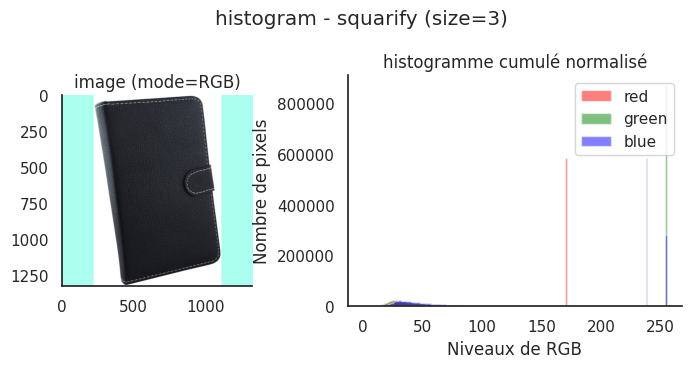

In [ ]:
# from PIL import Image


def img_squarify(img, bgcolor='white'):
    """
    Change en carré pour entrer dans un algorithme qui attend des images carrées
    La plupart des algorithmes sont invariants au stretch, donc pas
    """
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    if w != h:
        max_hw = max(h, w)
        img_square = Image.new(img.mode, (max_hw, max_hw), bgcolor)
        img_square.paste(img, ((max_hw-w)//2, (max_hw-h)//2))
        img = img_square
    return img


sqr_img = img_squarify(IMG, bgcolor='#AAFFEE')
print(get_image_size(sqr_img))
plot_image_histogram(sqr_img)
plt.suptitle('histogram - squarify (size=3)', y=1.1)
to_png()


### Size reduction

(149, 224)


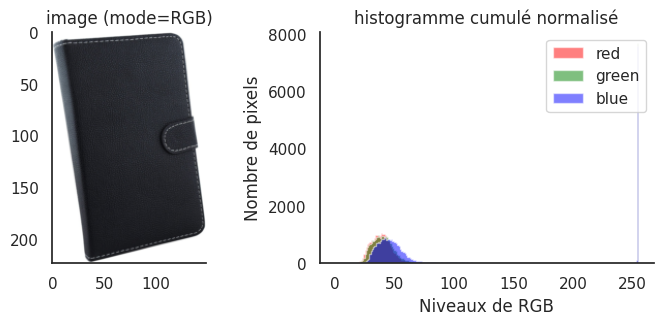

In [ ]:
# from PIL import Image

def img_resize_pil(img, sq_size=224, resample=Image.BILINEAR):
    # resample = Image.LINEAR, BILINEAR, BICUBIC, ou LANCZOS
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    max_hw = max(h, w)
    scale = sq_size/max_hw
    new_w = sq_size if w >= h else int(w*scale)
    new_h = sq_size if h >= h else int(h*scale)
    return img.resize((new_w, new_h), resample=resample)


res_img = img_resize_pil(IMG)
print(get_image_size(res_img))
plot_image_histogram(res_img)


(888, 1328)
(149, 224)


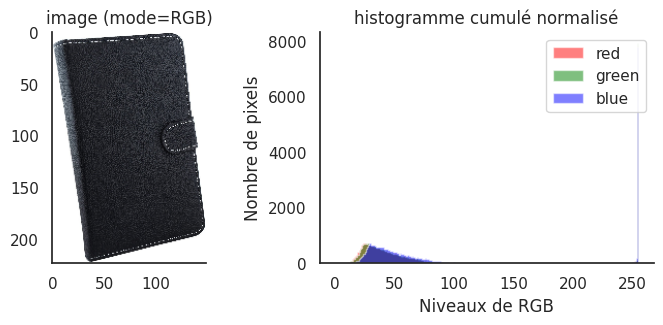

In [ ]:
def img_resize(img, sq_size=224, interpolation=Image.Resampling.LANCZOS):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    w, h = img.size
    max_hw = max(h, w)
    scale = sq_size/max_hw
    new_w = sq_size if w >= h else int(w*scale)
    new_h = sq_size if h >= h else int(h*scale)
    return cv2.resize(np.asarray(img), (new_w, new_h), interpolation)


res_img = img_resize(IMG)
print(get_image_size(IMG))
print(get_image_size(res_img))
plot_image_histogram(res_img)


## 2.3 Image preprocessing pipeline

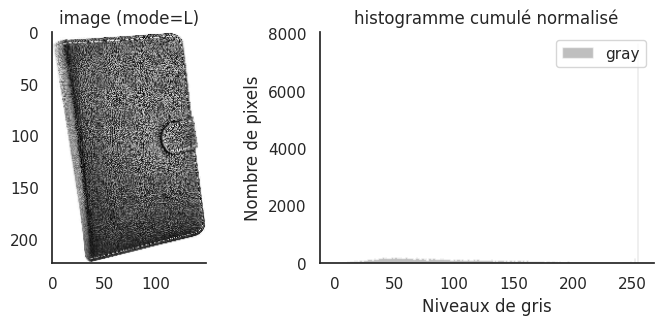

In [ ]:
preprocess_params={
    'resize':{'sq_size':224},
     'gray':True,
     'squarify':False,
     'equalize':True,
     'contrast':False,
    #  'filter_gauss':{'radius':1},
    #  'filter_median':{'size':1},
}


def img_preprocess(img, params=preprocess_params):
    if type(img) == np.ndarray:
        img = Image.fromarray(img)
    if params.get('gray'):
        img=img_to_gray(img)
    if params.get('squarify'):
        img = img_squarify(img)
    if params.get('resize'):
        img = img_resize(img, sq_size=params.get('resize').get('sq_size',24))
    if params.get('contrast'):
        img=img_contrast(img)
    if params.get('equalize'):
        img = img_equalize_clahe(img)
    if params.get('filter_gauss'):
        img = img_gaussian_blur(img,radius=params.get('filter_gauss').get('radius',1))
    if params.get('filter_median'):
        img = img_median_blur(img, size=params.get('filter_median').get('size',1))



    return img

img_processed = img_preprocess(IMG)
plot_image_histogram(img_processed)


In [ ]:
# Ajuste manuelle des prétraitements


"Home_Furnishing.png"


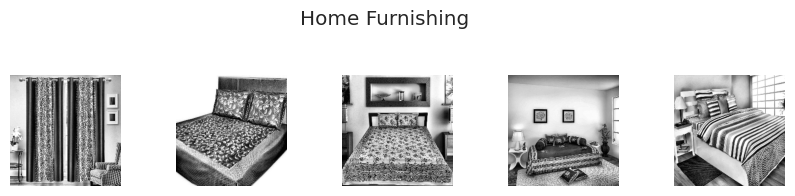

"Baby_Care.png"


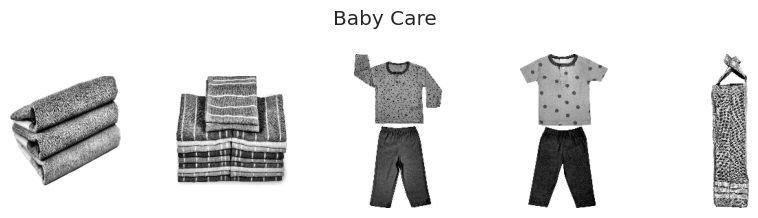

"Watches.png"


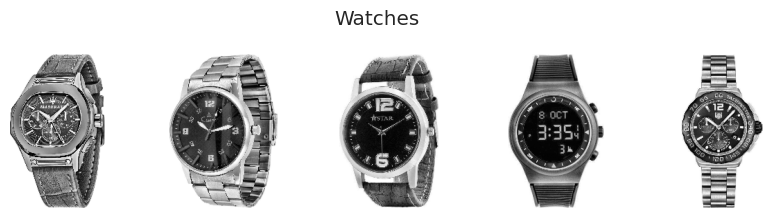

"Home_Decor_&_Festive_Needs.png"


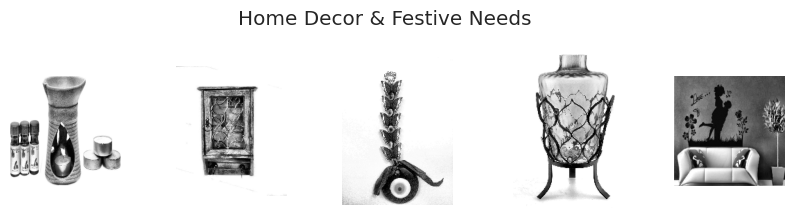

"Kitchen_&_Dining.png"


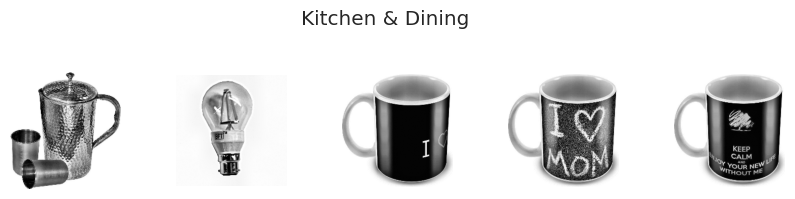

"Beauty_and_Personal_Care.png"


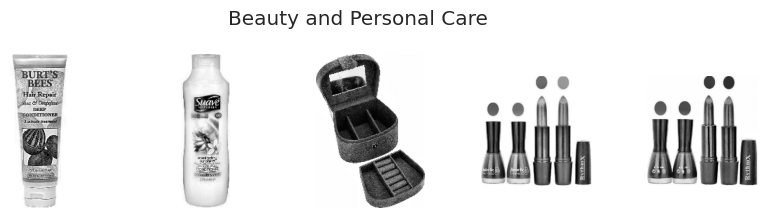

"Computers.png"


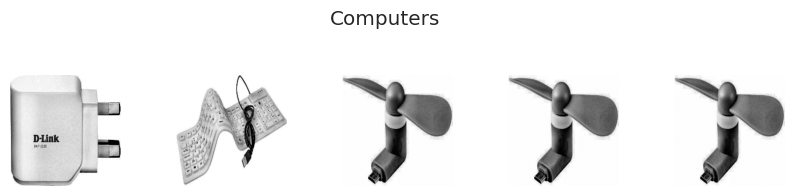

In [ ]:
preprocess_params = {
    'resize': {'sq_size': 224},
    'gray': True,
    'contrast':True,
    'equalize': True,
    # 'squarify': False,

    #  'filter_gauss':{'radius':1},
    #  'filter_median':{'size':1},
}

preview_images_by_category(
    df_data, preprocess_fct=img_preprocess, preprocess_params=preprocess_params, show_titles=False)


### Saves preprocessed images- If the number of images is large or the preprocessing takes time, one can save the images ready for feature extraction- For the current task, the number of images is small and the preprocessing is fast

#### Cleaning up global variables

In [ ]:

# %who DataFrame
del df_test_cols
del df_test_rows


# 3. SIFT - (Scale-Invariant Feature Transform)Visual feature extraction:- <https://docs.opencv.org/4.x/da/df5/tutorial_py_sift_intro.html>

In [ ]:
# from sklearn import preprocessing

# Création des labels des photos à partir de la catégorie niveau 1
df_data['label_name'] = df_data['categ_level_1']


le = preprocessing.LabelEncoder()
df_data['label'] = le.fit_transform(df_data['categ_level_1'])
print(sorted(list(df_data['label'].unique())))
(df_data[['label', 'categ_level_1']].value_counts()
 .to_frame('count').reset_index()
 .sort_values(by='label'))


[np.int64(0), np.int64(1), np.int64(2), np.int64(3), np.int64(4), np.int64(5), np.int64(6)]


,label,categ_level_1,count
0,0,Baby Care,150
1,1,Beauty and Personal Care,150
2,2,Computers,150
3,3,Home Decor & Festive Needs,150
4,4,Home Furnishing,150
5,5,Kitchen & Dining,150
6,6,Watches,150


### Determining and displaying SIFT descriptors

644
"SIFT_no_keypoints.png"


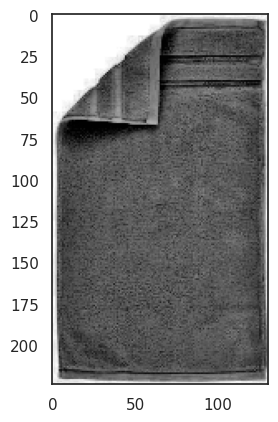

"SIFT_with_keypoints.png"


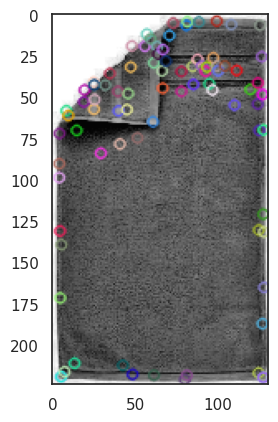

Descripteurs :  (87, 128)
[[  5.   3.   3.   1.   1.   1.   2.   3. 124.   4.   1.   0.   0.   0.
    1.  10. 208.   5.   0.   0.   0.   0.   0.   5.  53.   1.   0.   0.
    0.   0.   0.   1.   6.   3.   0.   0.   1.   2.   1.   4. 151.  13.
    0.   0.   0.   0.   0.   7. 208.  12.   0.   0.   0.   0.   0.   1.
   72.   2.   0.   0.   0.   0.   0.   0.   4.   1.   0.   0.   3.   3.
    3.  10. 143.   6.   0.   0.   0.   0.   3.  15. 208.   3.   0.   0.
    0.   0.   0.  12.  73.   1.   0.   0.   0.   0.   0.   4.   4.   1.
    1.   0.   0.   4.   6.   6. 107.   1.   0.   0.   0.   1.   6.  17.
  208.   2.   0.   0.   0.   0.   0.  20.  58.   0.   0.   0.   0.   0.
    0.   7.]
 [  5.   2.   2.   0.   0.   4.   6.   6. 108.   2.   0.   0.   0.   1.
    7.  18. 208.   2.   0.   0.   0.   0.   0.  21.  56.   0.   0.   0.
    0.   0.   0.   6.   8.  17.   8.   5.   1.   0.   0.   1. 138.  24.
    1.   0.   0.   0.   1.   4. 208.  22.   0.   0.   0.   0.   0.   3.
   78.   5.   0.   0.   0

In [ ]:


# import cv2
seed = np.random.randint(0, 1050)
# seed= 396
seed = 644
print(seed)
sift = cv2.xfeatures2d.SIFT_create()
image = cv2.imread(f'{path}/{LIST_PHOTOS[seed]}', 0)  # convert in gray

image = np.array(img_preprocess(image, preprocess_params))

plt.imshow(image, cmap='gray')
to_png('SIFT_no_keypoints')
plt.show()
# image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY) # already grey
# image = cv2.equalizeHist(image)   # equalize image histogram
kp, descripteurs = sift.detectAndCompute(image, None)
img = cv2.drawKeypoints(image, kp, image)
plt.imshow(img)
to_png('SIFT_with_keypoints')
plt.show()
print("Descripteurs : ", descripteurs.shape)
print(descripteurs[:2])


- The image contains 319 descriptors- Each descriptor is a vector of length 128

## 3.1 Image pre-processing via SIFT

### Creation of descriptors for each image- For each image, gray transition and equalization- creation of a list of descriptors per image ("sift_keypoints_by_img") which will be used to produce the histograms per image- creation of a list of descriptors for all images ("sift_keypoints_all") which will be used to create the descriptor clusters

In [ ]:
# identification of key points and associated descriptors
# 15 minutes sans preprocessing (517351 descriptors)
# 40 seconds avec preprocessing (265713 descriptors)
# import time
# import cv2

# SIFT est très lent si on ne réduit pas la taille des images (resize)
preprocess_params = {
    'resize': {'sq_size': 224},
    #  'gray':True,
    #  'squarify':False,
    'equalize': True,
    'contrast': True,
    #  'filter_gauss':{'radius':1},
    'filter_median': {'size': 3},
}

sift_keypoints = []
temps1 = time.time()
sift = cv2.xfeatures2d.SIFT_create(500)

image_files = list(df_data['image'])
for image_num, image_filename in enumerate(image_files):
    if image_num % 100 == 0:
        print(image_num)
    image = cv2.imread(f'{path}/{image_filename}', 0)  # convert in gray
    res = np.array(img_preprocess(image, preprocess_params))
    # image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY)
    # res = cv2.equalizeHist(image)   # equalize image histogram
    kp, des = sift.detectAndCompute(res, None)
    if des is None:
        print('no descriptors found for image_num {image_num}')
        des = [np.zeros((128,))]
    sift_keypoints.append(des)

sift_keypoints_by_img = np.asarray(sift_keypoints, dtype=object)
sift_keypoints_all = np.concatenate(sift_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

duration1 = time.time()-temps1
print("temps de traitement SIFT descriptor : ",
      "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000

Nombre de descripteurs :  (330157, 128)
temps de traitement SIFT descriptor :            42.47 secondes


## 3.2 Creating descriptor clusters- Using MiniBatchKMeans to achieve reasonable processing times

In [ ]:
# from sklearn import cluster

# Determination number of clusters
temps1 = time.time()

k = int(round(np.sqrt(len(sift_keypoints_all)), 0))
print("Nombre de clusters estimés : ", k)
print("Création de", k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(
    n_clusters=k, init_size=3*k, batch_size=2048, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1 = time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")


Nombre de clusters estimés :  575
Création de 575 clusters de descripteurs ...
temps de traitement kmeans :             7.63 secondes


## 3.3 Creating image features- For each image:- prediction of cluster numbers of each descriptor- creation of a histogram = counting for each cluster number the number of descriptors of the image

Features of an image = Histogram of an image = Count for an image of the number of descriptors per cluster

In [ ]:
# Creation of histograms (features)
temps1 = time.time()


def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des = len(des)
    if nb_des == 0:
        print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors = []

for i, image_desc in enumerate(sift_keypoints_by_img):
    if i % 100 == 0:
        print(i)
    hist = build_histogram(kmeans, image_desc, i)  # calculates the histogram
    hist_vectors.append(hist)  # histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1 = time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :             1.89 secondes


## 3.4 Dimension Reductions

### PCA dimension reduction- PCA reduction allows to create features that are unrelated to each other, and to reduce their dimension, while maintaining a high level of explained variance (99%)- The impact is better data separation via T-SNE and reduced T-SNE processing time

In [ ]:
feat_pca = reducer_pca(im_features)


Dimensions avant réduction PCA : (1050, 575)
Dimensions après réduction PCA (99 % variance explained) : (1050, 468)


### T-SNE dimension reduction- 2-component T-SNE dimension reduction for 2D image display

In [ ]:
# from sklearn import manifold

tsne = manifold.TSNE(n_components=2, perplexity=30, learning_rate=200,
                     n_iter=2000, init='random', random_state=6)
X_tsne = tsne.fit_transform(feat_pca)

df_tsne = pd.DataFrame(X_tsne[:, 0:2], columns=['tsne1', 'tsne2'])

df_tsne["class"] = df_data["label_name"]
print(df_tsne.shape)


(1050, 3)


## 3.5 KMeans: determining the number of clusters in images

In [ ]:
search_params = {'n_clusters': range(4, 15)}
scores_sift, labels_sift = score_kmeans(
    X_tsne, param_grid=search_params, labels_true=df_data['categ_level_1'])
scores_sift.head()


k=4, fit: 0.01 s, silhouette= 0.341, ARI = 0.017, cluster sizes = [30 24 24 20]
k=5, fit: 0.04 s, silhouette= 0.355, ARI = 0.035, cluster sizes = [26 21 18 16 16]
k=6, fit: 0.03 s, silhouette= 0.367, ARI = 0.038, cluster sizes = [23 19 15 14 13 13]
k=7, fit: 0.03 s, silhouette= 0.356, ARI = 0.044, cluster sizes = [22 15 14 13 12 11  9]
k=8, fit: 0.03 s, silhouette= 0.371, ARI = 0.047, cluster sizes = [20 15 12 12 10 10 10  8]
k=9, fit: 0.01 s, silhouette= 0.357, ARI = 0.047, cluster sizes = [21 11 11 10 10 10 10  9  6]
k=10, fit: 0.01 s, silhouette= 0.356, ARI = 0.038, cluster sizes = [14 12 11 10 10 10  9  7  6  6]
k=11, fit: 0.01 s, silhouette= 0.345, ARI = 0.041, cluster sizes = [11 10 10  9  9  9  8  8  7  7  6]
k=12, fit: 0.06 s, silhouette= 0.34, ARI = 0.042, cluster sizes = [12 12  8  8  8  8  7  7  7  6  6  4]
k=13, fit: 0.05 s, silhouette= 0.35, ARI = 0.042, cluster sizes = [11 10  9  9  9  8  7  6  5  5  5  5  5]
k=14, fit: 0.04 s, silhouette= 0.339, ARI = 0.033, cluster size

,k,min_cluster_pct,distortion_score,davies_bouldin,calinski_harabasz,silhouette_score,fit_time_cluster,ARI,classifier
0,4,20.38,66966.00,0.90,749.49,0.34,0.01,0.02,KMeans
1,5,16.57,54098.00,0.88,757.38,0.35,0.04,0.04,KMeans
2,6,13.24,43216.00,0.80,810.27,0.37,0.03,0.04,KMeans
3,7,9.62,37601.00,0.82,801.26,0.36,0.03,0.04,KMeans
4,8,8.10,31462.00,0.80,849.02,0.37,0.03,0.05,KMeans


In [ ]:
def angle_between_vectors(v1, v2):
    """
    calculate angle between 2 vectors.
    use to find elbows
    """
    ang1 = np.arctan2(*v1[::-1])
    ang2 = np.arctan2(*v2[::-1])
    ang = np.rad2deg(abs(ang1 - ang2) % (2 * np.pi))
    if ang > 180:
        ang = ang-180
    return ang


def find_elbow(df: pd.DataFrame, x_col='k', y_col='distortion_score'):
    """find sharpest difference in angle for [k, score]"""
    df = df.copy().reset_index()
    # standardise scale to maximise angles between points

    x_scale = df[x_col].max()-df[x_col].min()
    y_min = df[y_col].min()
    y_mult = (df[y_col].max()-y_min)/x_scale
    df['y_scaled'] = (df[y_col]-y_min)/y_mult

    # calculate angles between consecutive points
    n = len(df)
    for i in range(0, n-2):
        point1 = df.loc[i, [x_col, 'y_scaled']]
        point2 = df.loc[i+1, [x_col, 'y_scaled']]
        point3 = df.loc[i+2, [x_col, 'y_scaled']]
        vec1 = point2-point1
        vec2 = point3-point2
        df.loc[i+1, 'angle'] = angle_between_vectors(vec1, vec2)
    # elbow is at highest difference in angle (assume monotonic function)
    row = df['angle'].idxmax()
    x_elbow = df.loc[row, x_col]
    y_score = df.loc[row, y_col]
    return x_elbow, y_score

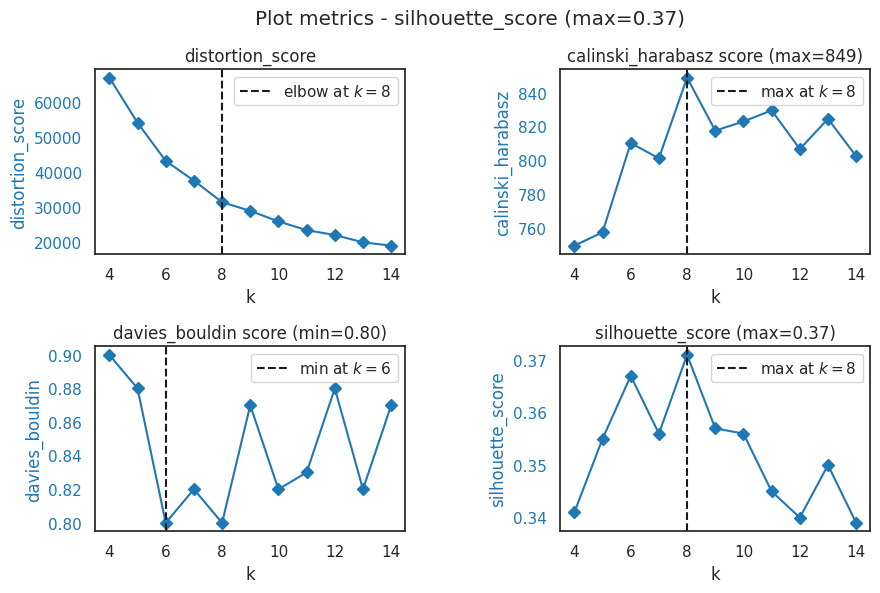

In [ ]:
plot_metrics(scores_sift)


## 3.6 Visual analysis: T-SNE display according to image categories- We check if the t-SNE shows the categories not partially separated

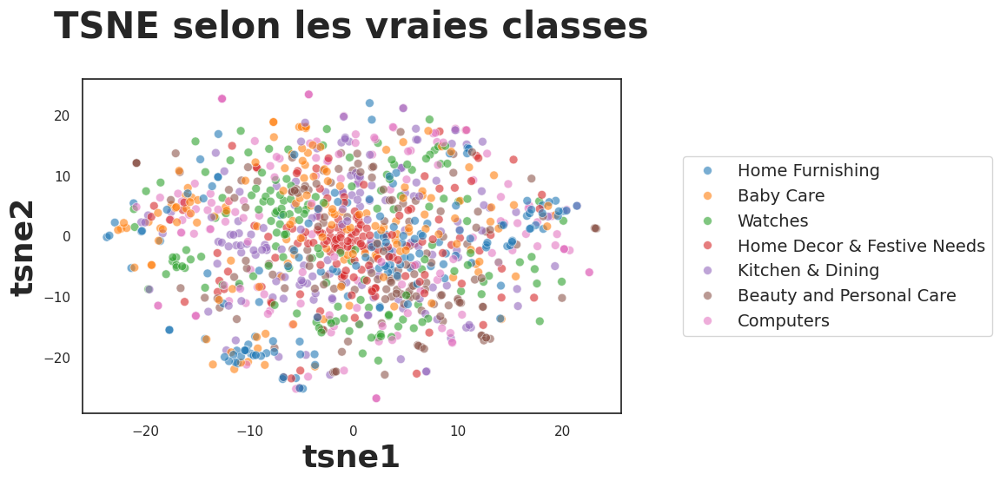

In [ ]:
def plot_tsne_by_group(df_tsne_, hue='class'):
    plt.figure(figsize=(8, 5))
    sns.scatterplot(data=df_tsne_, x="tsne1", y="tsne2", hue="class", legend="brief",
                    palette=sns.color_palette('tab10', n_colors=7), s=50, alpha=0.6)

    plt.title('TSNE selon les vraies classes',
              fontsize=30, pad=35, fontweight='bold')
    plt.xlabel('tsne1', fontsize=26, fontweight='bold')
    plt.ylabel('tsne2', fontsize=26, fontweight='bold')
    plt.legend(prop={'size': 14}, loc=6, bbox_to_anchor=(1.1, 0.5))


plot_tsne_by_group(df_tsne, hue='class')


## 3.7 Analysis of similarity between categories and clusters

### Creating clusters from T-SNE

In [ ]:
# from sklearn import cluster
categories = df_data['label_name'].unique()
nb_clusters = 10
cls = cluster.KMeans(n_clusters=nb_clusters, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)


(1050, 4)


### Display of images according to clusters and ARI calculation of similarity between image categories / clusters- The ARI score (0.04) remains low

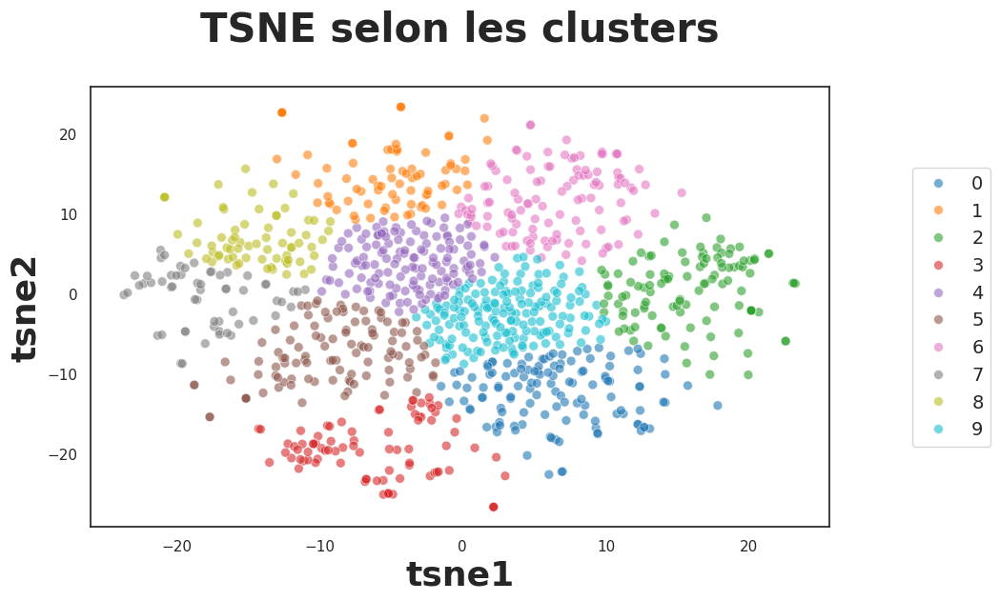

ARI :  0.038334647770332984


In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=nb_clusters), s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")

plt.title('TSNE selon les clusters', fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14}, loc=6, bbox_to_anchor=(1.1, 0.5))

plt.show()

labels = df_data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))


### Analysis by classes- The confusion matrix must be transformed to have the same order of the supposed categories in the column as in the row- This transformation reaches its limits for the 2 categories "shine" and "sunshine" which are not very separated (so it was done manually instead of using the "argmax" function)

In [ ]:
df_tsne.groupby("cluster").count()["class"]


,class
cluster,
0,124
1,81
2,111
3,83
4,135
5,107
6,115
7,58
8,69


[1 0 2 9 3 5 4 6 7 8]
Correspondance des clusters : [1 0 2 4 6 5 5 0 0 3]
ARI = 0.042
              precision    recall  f1-score   support

           0       0.25      0.35      0.29       150
           1       0.33      0.27      0.30       150
           2       0.24      0.18      0.21       150
           3       0.32      0.35      0.33       150
           4       0.36      0.20      0.26       150
           5       0.25      0.37      0.30       150
           6       0.21      0.19      0.20       150

    accuracy                           0.27      1050
   macro avg       0.28      0.27      0.27      1050
weighted avg       0.28      0.27      0.27      1050

"Clustering_sur_SIFT_features_-_confusion_matrix_(ARI=0-042).png"


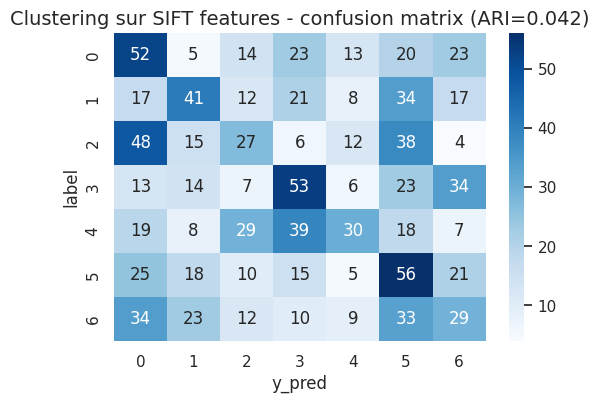

In [ ]:

ari_sift=plot_classification_metrics(labels, cls.labels_)
plt.title(f'Clustering sur SIFT features - confusion matrix (ARI={ari_sift:.3f})', fontsize=14)
to_png()
df_resultats=add_model_score(model_name='SIFT',ARI=ari_sift, k=len(set(cls.labels_)))

In [ ]:
conf_matrix_labels(df_data['categ_level_1'], cls.labels_).style.background_gradient(axis=1)


y_pred,1,0,2,9,3,5,4,6,7,8
categ_level_1,,,,,,,,,,
Baby Care,21,5,14,23,13,7,23,13,14,17
Beauty and Personal Care,6,41,12,21,8,18,17,16,0,11
Computers,25,15,27,6,12,17,4,21,8,15
Home Decor & Festive Needs,7,14,7,53,6,12,34,11,3,3
Home Furnishing,4,8,29,39,30,10,7,8,8,7
Kitchen & Dining,8,18,10,15,5,31,21,25,11,6
Watches,10,23,12,10,9,12,29,21,14,10


## 3.8 View images by cluster found by SIFT### View examples in each group- uncomment the following cell

In [ ]:
# df_data['label_sift'] = cls.labels_
# preview_images_by_category(df_data, categ_col='label_sift', nb=5)

### View images on t-SNE- https://nextjournal.com/ml4a/image-t-sne- https://www.kaggle.com/code/gaborvecsei/plants-t-sne/notebook

In [ ]:
# from PIL import Image
# import random


def plot_scatter_with_images(X_2d_data, filelist, figsize=(20, 20), sample_size=1000, filepath=IMG_FOLDER):
    """visualise images sur t-SNE
    Parameters
    ----------
    X_2d_data np.array or pd.DataFrame of shape [m, n>=2]
    filelist   list of filenames in filepath, or full path to file if filepath is None
    """
    if len(filelist) > sample_size:
        sort_order = sorted(random.sample(range(len(filelist)), sample_size))
        filelist = [filelist[i] for i in sort_order]
        X_2d_data = X_2d_data[sort_order]

    tx, ty = X_2d_data[:, 0], X_2d_data[:, 1]
    tx = (tx-np.min(tx)) / (np.max(tx) - np.min(tx))
    # 0 is top, so invert ty position for same form as a scatterplot
    ty = (np.max(ty)-ty) / (np.max(ty) - np.min(ty))

    width = 2000
    height = 1500
    max_dim = 100

    # Disable DecompressionBombWarning:
    # Image size (93680328 pixels) exceeds limit of 89478485 pixels
    max_pixels = Image.MAX_IMAGE_PIXELS
    Image.MAX_IMAGE_PIXELS = 93680328+1
    full_image = Image.new('RGBA', (width, height))
    for filename, x, y in zip(filelist, tx, ty):
        if filepath is None:
            tile = Image.open(filename)
        else:
            tile = Image.open(f'{filepath}/{filename}')
        tile = Image.fromarray(img_resize(tile))
        # tile = Image.fromarray(img)
        rs = max(1, tile.width/max_dim, tile.height/max_dim)
        # Replace Image.ANTIALIAS with Image.Resampling.LANCZOS
        tile = tile.resize(
            (int(tile.width/rs), int(tile.height/rs)), Image.Resampling.LANCZOS)
        full_image.paste(tile, (int((width-max_dim)*x),
                         int((height-max_dim)*y)), mask=tile.convert('RGBA'))

    Image.MAX_IMAGE_PIXELS = max_pixels
    plt.figure(figsize=figsize)
    plt.imshow(full_image)

In [ ]:
# list variables
# %who


In [ ]:
# delete variables used by sift

del df_tsne
del sift_keypoints_all
del sift_keypoints_by_img
del sift_keypoints
del sift


# 4. ORB (Oriented FAST and Rotated BRIEF)ORB was created in 2011, and is open source (SIFT no longer has a patent since 2021)- https://docs.opencv.org/3.4/d1/d89/tutorial_py_orb.html

644
"ORB_no_keypoints.png"


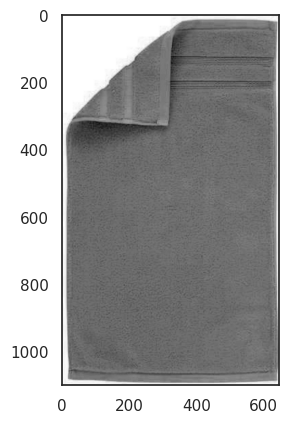

"ORB_with_keypoints.png"


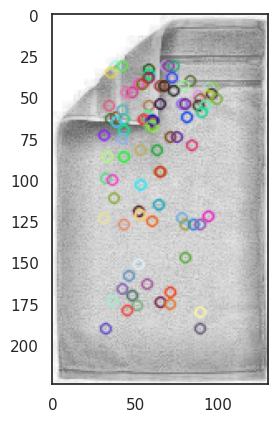

Descripteurs :  (99, 32)
[[123 121 102 228 108  24 254 112 169 248 190 175 255  63 151  87 238 245
  255 231 204  99 231 233 246 249 230 184 103 190 115 219]
 [ 91  30 124 237  53 222  90  54 109  72 190 231 255  31 150 240 238 181
  157 237 205 169  37 255 242 255 162 147 127 142 121  91]
 [ 35 135   8 138 252 133 142 127 143  29 217 215 160 202 190 196 204  11
   27 141 214  11  74 247  36  60 138 250  20  14 185 197]]


In [ ]:
import cv2
seed = np.random.randint(0, 1050)
# seed= 396 # mug
seed = 644  # watch
# seed = 491
print(seed)
orb = cv2.ORB_create(nfeatures=500)
image = cv2.imread(f'{path}/{LIST_PHOTOS[seed]}', 0)  # convert in gray
# image= np.array(img_preprocess(image,preprocess_params))
# image = np.array(img_resize(image,sq_size=288))
plt.imshow(image, cmap='gray')
to_png('ORB_no_keypoints')
plt.show()
# image = cv2.cvtColor(image,cv2.COLOR_BGR2GRAY) # already grey
image = img_resize(image, sq_size=224)
image = img_equalize_clahe(image)   # equalize image histogram
kp, des = orb.detectAndCompute(image, None)
img = cv2.drawKeypoints(image, kp, image)
plt.imshow(img)
to_png('ORB_with_keypoints')
plt.show()
print("Descripteurs : ", des.shape)
print(des[:3])


In [ ]:
image_idx(df_data['image'][30])


574

## 4.1 Image pre-processing via ORB

### Creation of descriptors for each image- For each image, gray transition and equalization- creation of a list of descriptors per image ("sift_keypoints_by_img") which will be used to produce the histograms per image- creation of a list of descriptors for all images ("sift_keypoints_all") which will be used to create the descriptor clusters

In [ ]:
# identification of key points and associated descriptors
# 15 minutes sans preprocessing (517351 descriptors)
# 40 seconds avec preprocessing (265713 descriptors)
import time
import cv2

preprocess_params = {
    # 'resize': {'sq_size': 224},
    #  'gray':True,
    #  'squarify':False,
    'equalize': True,
    'contrast': True,
    #  'filter_gauss':{'radius':1},
    #  'filter_median':{'size':1},
}

orb_keypoints = []
temps1 = time.time()
orb = cv2.ORB_create()

image_files = list(df_data['image'])
for image_num, image_filename in enumerate(image_files):
    if image_num % 100 == 0:
        print(image_num)
    image = cv2.imread(f'{path}/{image_filename}', 0)  # convert in gray
    res= np.array(img_preprocess(image,preprocess_params))
    # res = cv2.equalizeHist(image)
    # res = img_equalize_clahe(image) # equalize image histogram
    kp, des = orb.detectAndCompute(res, None)
    if des is None:
        print(f'no descriptors found for image_num {image_num}')
        des = [np.zeros((128,))]
    orb_keypoints.append(des)

orb_keypoints_by_img = np.asarray(orb_keypoints, dtype=object)
orb_keypoints_all = np.concatenate(orb_keypoints_by_img, axis=0)

print()
print("Nombre de descripteurs : ", orb_keypoints_all.shape)

duration1 = time.time()-temps1
print("temps de traitement ORB descriptor : ",
      "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000

Nombre de descripteurs :  (519444, 32)
temps de traitement ORB descriptor :            82.99 secondes


## 4.2 Creating descriptor clusters- Using MiniBatchKMeans to achieve reasonable processing times

In [ ]:
# from sklearn import cluster

# Determination number of clusters
temps1 = time.time()

k = int(round(np.sqrt(len(orb_keypoints_all)), 0))
print("Nombre de clusters estimés : ", k)
print("Création de", k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(
    n_clusters=k, init_size=3*k, batch_size=2048, random_state=0)
kmeans.fit(orb_keypoints_all)

duration1 = time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")


Nombre de clusters estimés :  721
Création de 721 clusters de descripteurs ...
temps de traitement kmeans :            11.30 secondes


## 4.3 Creating image features- For each image:- prediction of cluster numbers of each descriptor- creation of a histogram = counting for each cluster number the number of descriptors of the image

Features of an image = Histogram of an image = Count for an image of the number of descriptors per cluster

In [ ]:
# Creation of histograms (features)
temps1 = time.time()


def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des = len(des)
    if nb_des == 0:
        print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors = []

for i, image_desc in enumerate(orb_keypoints_by_img):
    if i % 100 == 0:
        print(i)
    hist = build_histogram(kmeans, image_desc, i)  # calculates the histogram
    hist_vectors.append(hist)  # histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1 = time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")


0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :             2.52 secondes


## 4.4 Dimension Reductions

### PCA dimension reduction- PCA reduction allows to create features that are unrelated to each other, and to reduce their dimension, while maintaining a high level of explained variance (99%)- The impact is better data separation via T-SNE and reduced T-SNE processing time

In [ ]:
feat_pca = reducer_pca(im_features)


Dimensions avant réduction PCA : (1050, 721)
Dimensions après réduction PCA (99 % variance explained) : (1050, 594)


### T-SNE dimension reduction- 2-component T-SNE dimension reduction for 2D image display

In [ ]:
X_tsne=reducer_tsne(feat_pca)
df_tsne = pd.DataFrame(X_tsne[:, 0:2], columns=['tsne1', 'tsne2'])
df_tsne["class"] = df_data["label_name"]
print(df_tsne.shape)


t-SNE done! Time elapsed: 21.0 seconds
(1050, 3)


## 4.5 KMeans: determining the number of clusters in images

In [ ]:
search_params = {'n_clusters': range(4, 15)}
scores_orb, labels_orb = score_kmeans(
    X_tsne, param_grid=search_params, labels_true=df_data['categ_level_1'])
scores_orb.head()


k=4, fit: 0.01 s, silhouette= 0.404, ARI = 0.051, cluster sizes = [32 29 21 16]
k=5, fit: 0.0 s, silhouette= 0.374, ARI = 0.045, cluster sizes = [25 22 17 17 16]
k=6, fit: 0.0 s, silhouette= 0.373, ARI = 0.04, cluster sizes = [21 18 18 17 13 11]
k=7, fit: 0.01 s, silhouette= 0.362, ARI = 0.041, cluster sizes = [17 15 15 14 14 11 10]
k=8, fit: 0.01 s, silhouette= 0.352, ARI = 0.041, cluster sizes = [16 16 14 13 11  9  9  8]
k=9, fit: 0.01 s, silhouette= 0.363, ARI = 0.038, cluster sizes = [15 14 12 12  9  9  9  9  8]
k=10, fit: 0.01 s, silhouette= 0.348, ARI = 0.041, cluster sizes = [14 14 11 11  9  8  8  8  7  6]
k=11, fit: 0.01 s, silhouette= 0.345, ARI = 0.037, cluster sizes = [12 11 10 10  9  8  8  8  7  6  5]
k=12, fit: 0.01 s, silhouette= 0.345, ARI = 0.037, cluster sizes = [11 11 10 10  8  8  8  7  6  5  5  4]
k=13, fit: 0.01 s, silhouette= 0.34, ARI = 0.036, cluster sizes = [12 10  8  8  8  7  7  7  6  6  6  5  3]
k=14, fit: 0.02 s, silhouette= 0.339, ARI = 0.036, cluster sizes 

,k,min_cluster_pct,distortion_score,davies_bouldin,calinski_harabasz,silhouette_score,fit_time_cluster,ARI,classifier
0,4,16.67,80649.00,0.84,1133.77,0.40,0.01,0.05,KMeans
1,5,16.86,66056.00,0.87,1094.91,0.37,0.00,0.04,KMeans
2,6,11.24,55424.00,0.84,1083.08,0.37,0.00,0.04,KMeans
3,7,10.29,48421.00,0.86,1057.20,0.36,0.01,0.04,KMeans
4,8,8.86,43253.00,0.89,1031.30,0.35,0.01,0.04,KMeans


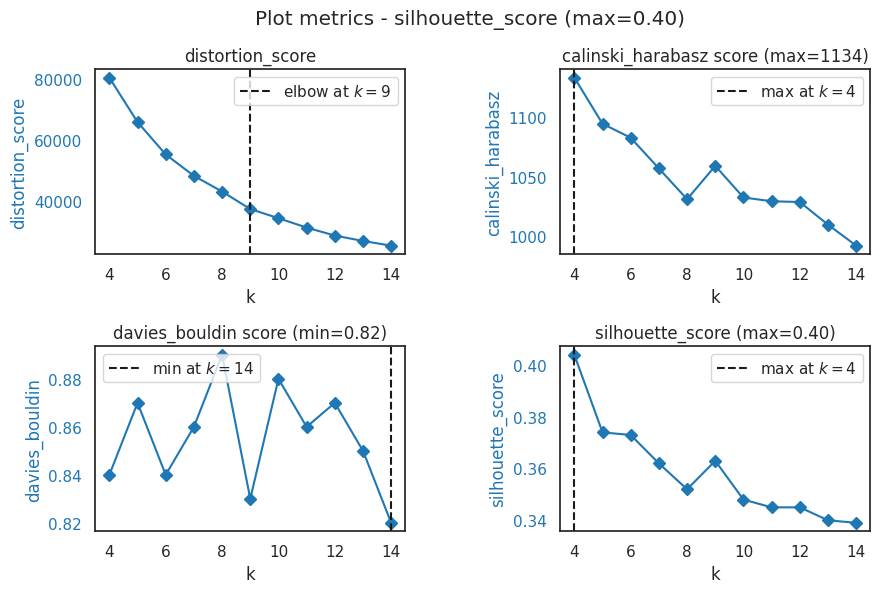

In [ ]:
plot_metrics(scores_orb)


## 4.6 Visual analysis: T-SNE display according to image categories- We don't see much separation

"tsne_orb_vraie_classes-png.png"


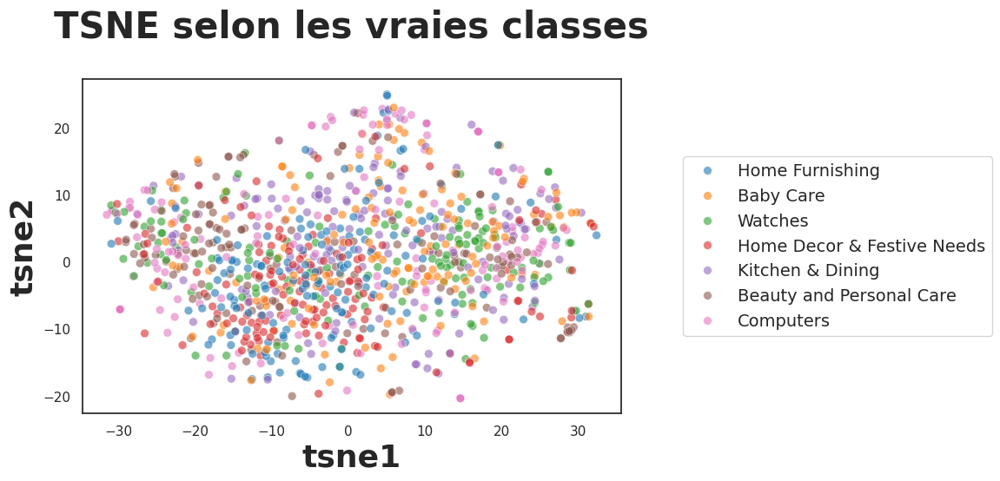

In [ ]:
plot_tsne_by_group(df_tsne, hue='class')
to_png('tsne_orb_vraie_classes.png')


## 4.7 Analysis of similarity between categories and clusters

### Creating clusters from T-SNE

In [ ]:
# from sklearn import cluster
categories = df_data['label_name'].unique()
nb_clusters = 10
cls = cluster.KMeans(n_clusters=nb_clusters, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)


(1050, 4)


### Display of images according to clusters and ARI calculation of similarity between image categories / clusters- The ARI score of 0.04 is very low

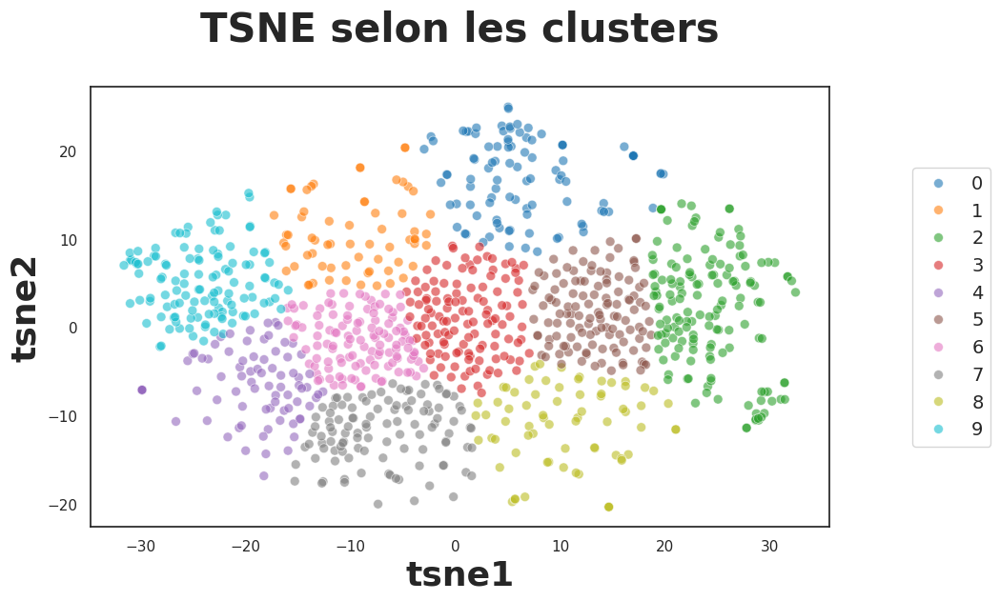

ARI :  0.035727053913192024


In [ ]:
plt.figure(figsize=(10, 6))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=nb_clusters), s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")


plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14}, loc=6, bbox_to_anchor=(1.1, 0.5))
plt.title('TSNE selon les clusters', fontsize=30, pad=35, fontweight='bold')
plt.show()

labels = df_data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))


### Analysis by classes- The confusion matrix must be transformed to have the same order of the supposed categories in the column as in the row- This transformation reaches its limits for the 2 categories "shine" and "sunshine" which are not very separated (so it was done manually instead of using the "argmax" function)

In [ ]:
df_tsne.groupby("cluster").count()["class"]


,class
cluster,
0,99
1,65
2,150
3,122
4,78
5,120
6,118
7,109
8,70


[3 9 0 7 6 2 5 1 4 8]
Correspondance des clusters : [2 5 5 0 4 6 4 3 0 1]
ARI = 0.034
                            precision    recall  f1-score   support

                 Baby Care       0.17      0.21      0.19       150
  Beauty and Personal Care       0.32      0.25      0.28       150
                 Computers       0.31      0.21      0.25       150
Home Decor & Festive Needs       0.33      0.24      0.28       150
           Home Furnishing       0.23      0.30      0.26       150
          Kitchen & Dining       0.21      0.31      0.25       150
                   Watches       0.33      0.26      0.29       150

                  accuracy                           0.25      1050
                 macro avg       0.27      0.25      0.26      1050
              weighted avg       0.27      0.25      0.26      1050

"Clustering_sur_ORB_features_-_confusion_matrix_(ARI=0-034).png"


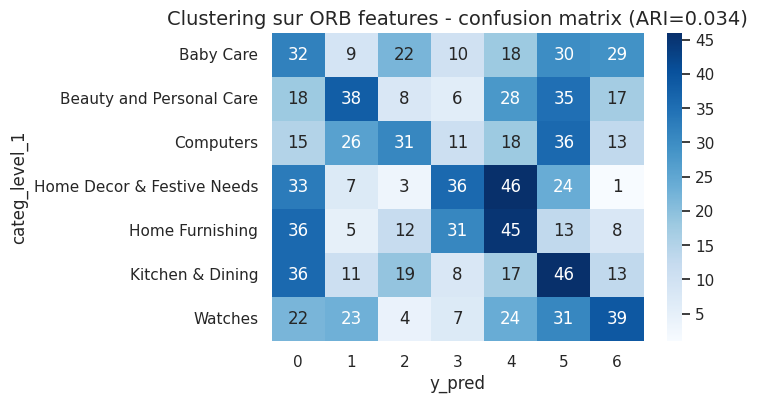

In [ ]:
df_data['label_orb'] = cls.labels_
ari_orb =plot_classification_metrics(df_data['categ_level_1'], cls.labels_)
plt.title(f'Clustering sur ORB features - confusion matrix (ARI={ari_orb:.3f})', fontsize=14)
to_png()
df_resultats=add_model_score(model_name='ORB',ARI=ari_orb, k=len(set(cls.labels_)))


## 4.8 View categories found by ORB### Visualize examples by clusterUncomment the code below

In [ ]:
# preview_images_by_category(df_data, categ_col='label_orb', nb=10)


### View images on t-SNE

"visualisation_des_produits_sur_TSNE_pour_les_top_PCA_des_features_ORB.png"


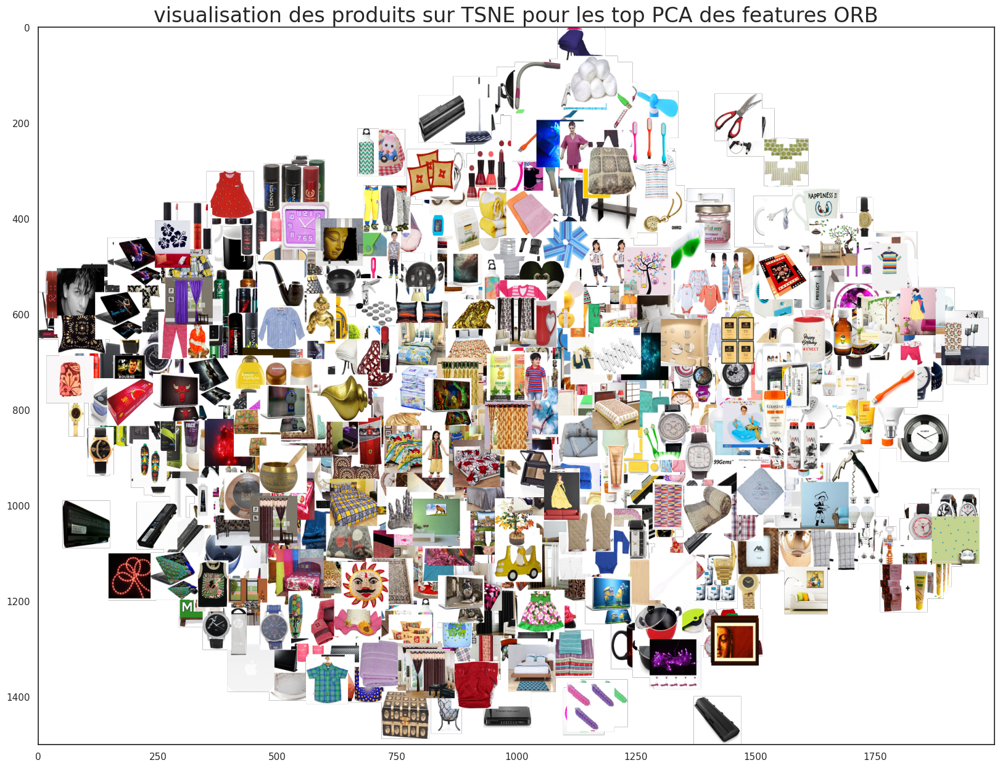

In [ ]:
plot_scatter_with_images(X_tsne[:, 0:2], df_data['image'])
plt.title(
    'visualisation des produits sur TSNE pour les top PCA des features ORB', fontsize=24)
to_png()


We see that some sectors of the scatter are darker than others, but it does not appear that we have distinct clusters.

In [ ]:
# supprime les variables utilisé par ORB
del df_tsne
del orb_keypoints_by_img
del orb_keypoints_all
del feat_pca


#5. Image Classification: CNN Method

## 5.1 Building a CNN from A to Z with Tensorflow / KerasImplementation of a VGG-16 from A to Z<!-- <img src="https://cdn-images-1.medium.com/max/1000/1*3-TqqkRQ4rWLOMX-gvkYwA.png"> --><img src="./img/Picture1.png">[Source](https://arxiv.org/abs/1409.1556v6)<p><img src="./img/Picture2.png">Implementing a neural network with Keras involves creating a Sequential model and enriching it with the corresponding layers in the correct order.The most difficult step is to correctly define the parameters of each of the layers – hence the importance of understanding the network architecture!The convolution, pooling and fully-connected layers correspond to instances of the respective `Conv2D`, `MaxPooling2D` and `Dense` classes of the `keras.layers` module. A ReLU layer can be created either by instantiating the `Activation` class or by adding an argument to the constructor of the layer preceding it.

In [ ]:
# import tensorflow as tf
# from tensorflow.keras.models import Sequential
# from tensorflow.keras.layers import InputLayer, Conv2D, MaxPooling2D, Flatten, Dense


def create_VGG16(nb_classes=1000):
    # Création d'un réseau de neurones vide
    model = tf.keras.models.Sequential()

    # Ajout InputLayer pour clarté
    model.add(tf.keras.layers.InputLayer(
        name='INPUT', input_shape=[224, 224, 3]))

    # -------- Block 1 ----------
    # Ajout de la première couche de convolution, suivie d'une couche ReLU
    # model.add(Conv2D(name='B1_CONV1',input_shape=(224, 224, 3),filters=64, kernel_size=(3, 3), padding='same', activation='relu'))
    model.add(tf.keras.layers.Conv2D(name='B1_CONV1', filters=64, kernel_size=(
        3, 3), padding='same', activation='relu'))

    # Ajout de la deuxième couche de convolution, suivie d'une couche ReLU
    model.add(tf.keras.layers.Conv2D(name='B1_CONV2', filters=64, kernel_size=(
        3, 3), padding='same', activation='relu'))

    # Ajout de la première couche de pooling
    model.add(tf.keras.layers.MaxPooling2D(
        name='B1_POOL', pool_size=(2, 2), strides=(2, 2)))

    # -------- Block 2 ----------
    model.add(tf.keras.layers.Conv2D(name='B2_CONV1', filters=128, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.Conv2D(name='B2_CONV2', filters=128, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.MaxPooling2D(
        name='B2_POOL', pool_size=(2, 2), strides=(2, 2)))

    # -------- Block 3 ----------
    model.add(tf.keras.layers.Conv2D(name='B3_CONV1', filters=256, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.Conv2D(name='B3_CONV2', filters=256, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.MaxPooling2D(
        name='B3_POOL', pool_size=(2, 2), strides=(2, 2)))

    # -------- Block 4 ----------
    model.add(tf.keras.layers.Conv2D(name='B4_CONV1', filters=512, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.Conv2D(name='B4_CONV2', filters=512, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.MaxPooling2D(
        name='B4_POOL', pool_size=(2, 2), strides=(2, 2)))

    # -------- Block 5 ----------
    model.add(tf.keras.layers.Conv2D(name='B5_CONV1', filters=512, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.Conv2D(name='B5_CONV2', filters=512, kernel_size=(
        3, 3), padding="same", activation="relu"))
    model.add(tf.keras.layers.MaxPooling2D(
        name='B5_POOL', pool_size=(2, 2), strides=(2, 2)))

    # -------- Les couches fully-connected ----------
    # Conversion des matrices 3D en vecteur 1D
    model.add(tf.keras.layers.Flatten())

    # Ajout de la première couche fully-connected, suivie d'une couche ReLU
    model.add(tf.keras.layers.Dense(4096, activation='relu'))

    # Ajout de la deuxième couche fully-connected, suivie d'une couche ReLU
    model.add(tf.keras.layers.Dense(4096, activation='relu'))

    # Ajout de la dernière couche fully-connected qui permet de classifier
    model.add(tf.keras.layers.Dense(nb_classes, activation='softmax'))
    return model


model = create_VGG16(nb_classes=7)
model.summary()


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


Model: "sequential_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ B1_CONV1 (Conv2D)               │ (None, 224, 224, 64)   │         1,792 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B1_CONV2 (Conv2D)               │ (None, 224, 224, 64)   │        36,928 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B1_POOL (MaxPooling2D)          │ (None, 112, 112, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B2_CONV1 (Conv2D)               │ (None, 112, 112, 128)  │        73,856 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B2_CONV2 (Conv2D)               │ (None, 112, 112, 128)  │       147,584 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B2_POOL (MaxPooling2D)          │ (None, 56, 56, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B3_CONV1 (Conv2D)               │ (None, 56, 56, 256)    │       295,168 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B3_CONV2 (Conv2D)               │ (None, 56, 56, 256)    │       590,080 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B3_POOL (MaxPooling2D)          │ (None, 28, 28, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B4_CONV1 (Conv2D)               │ (None, 28, 28, 512)    │     1,180,160 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B4_CONV2 (Conv2D)               │ (None, 28, 28, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B4_POOL (MaxPooling2D)          │ (None, 14, 14, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B5_CONV1 (Conv2D)               │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B5_CONV2 (Conv2D)               │ (None, 14, 14, 512)    │     2,359,808 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ B5_POOL (MaxPooling2D)          │ (None, 7, 7, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_1 (Flatten)             │ (None, 25088)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_3 (Dense)                 │ (None, 4096)           │   102,764,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_4 (Dense)                 │ (None, 4096)           │    16,781,312 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_5 (Dense)                 │ (None, 7)              │        28,679 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 128,979,527 (492.02 MB)

 Trainable params: 128,979,527 (492.02 MB)

 Non-trainable params: 0 (0.00 B)

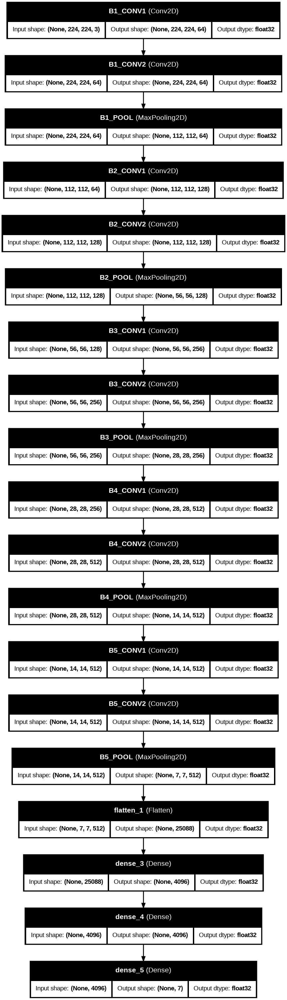

In [ ]:
import os
import tensorflow as tf

# Create the 'img' directory if it doesn't exist
if not os.path.exists('./img'):
    os.makedirs('./img')

tf.keras.utils.plot_model(
    model,
    to_file='./img/model_VGG16.png',
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=False,
    dpi=96,
    layer_range=None,
    show_layer_activations=False
)

## 5.2 Training a baseline CNN modelThe VGG-16 model is a 'deep' learning model, which takes a long time for each epoch, is a lot of memory for each batch.Before training on VGG-16, we quickly test the preprocessing hyperparameters by measuring the performance of each preprocessing configuration on a simpler model.- [Image Classification Using Convolutional Neural Networks: A step by step guide](https://www.analyticsvidhya.com/blog/2021/01/image-classification-using-convolutional-neural-networks-a-step-by-step-guide/)

In [ ]:
# import tensorflow as tf


def create_CNN_simple(nb_classes=7):
    model_ = tf.keras.Sequential([
        tf.keras.layers.Conv2D(32, (3, 3), padding='same', activation=tf.nn.relu,
                               input_shape=(224, 224, 3)),
        tf.keras.layers.MaxPooling2D((2, 2), strides=4),
        tf.keras.layers.Conv2D(
            32, (3, 3), padding='same', activation=tf.nn.relu),
        tf.keras.layers.MaxPooling2D((2, 2), strides=4),
        tf.keras.layers.Dropout(0.5),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(128, activation=tf.nn.relu),
        tf.keras.layers.Dense(nb_classes,  activation=tf.nn.softmax)
    ])
    return model_


model = create_CNN_simple(len(le.classes_))
model.summary()


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d (Conv2D)                 │ (None, 224, 224, 32)   │           896 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d (MaxPooling2D)    │ (None, 56, 56, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 56, 56, 32)     │         9,248 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ max_pooling2d_1 (MaxPooling2D)  │ (None, 14, 14, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout (Dropout)               │ (None, 14, 14, 32)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_2 (Flatten)             │ (None, 6272)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_6 (Dense)                 │ (None, 128)            │       802,944 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_7 (Dense)                 │ (None, 7)              │           903 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 813,991 (3.11 MB)

 Trainable params: 813,991 (3.11 MB)

 Non-trainable params: 0 (0.00 B)

## 5.3 Preparation d'images pour CNNThere are several ways to provide image data to a Keras model, depending on the size of the data and the preprocessing required:1. **Load into memory** the images (np.array) and their classifications (image_label), then train and predict with these arrays. This method is the simplest (and fastest), because there is no need to manage streams.2. **Put images into subfolders** according to their class (image_label), and use Keras specialized functions like `tf.keras.utils.image_dataset_from_directory`. This method is useful when you need to increase the number of training images, or you need to train a model with large images that cannot all be loaded into memory. But you have to move the images into subfolders according to their classification.3. **Create tensorflow pipelines** to process images in streams. This method is the most complex, because you have to manipulate the tensor streams with specialized tensorflow functions. It has the advantage that you can create data augmentation pipelines, for example.4. **Create a "preprocess_layer" in the model**: Do the preprocessing in one or more layers of the model. The advantage of this option is that the model can be easily transported, because it processes raw images (no need to create a separate preprocessing pipeline: we simply call `model.predict(img_brute)`)For this example, to avoid the preprocessing time in each fit, we create already preprocessed data.In general, it is recommended to develop models that take **raw data as input**, as opposed to models that take already pre-processed data.- If your model expects preprocessed data, every time you export your model to use it elsewhere (in a web browser, in a mobile app), you will have to reimplement the exact same preprocessing pipeline.This quickly becomes very tricky.**Sources :**- <https://keras.io/guides/transfer_learning/>- [Comparison des méthodes (avec exemples)](https://towardsdatascience.com/what-is-the-best-input-pipeline-to-train-image-classification-models-with-tf-keras-eb3fe26d3cc5)- [Fine tuning pipeline](https://towardsdatascience.com/input-pipeline-for-images-using-keras-and-tensorflow-c5e107b6d7b9)

### References#### Image Arrays in memory- [Image Classification Using Convolutional Neural Networks: A step by step guide](https://www.analyticsvidhya.com/blog/2021/01/image-classification-using-convolutional-neural-networks-a-step-by-step-guide/)- [Tutorial using tensorflow datasets](https://www.tensorflow.org/tutorials/images/cnn)#### From flow / image augmentation- [Codelab : Use convolutional neural networks (CNNs) with complex images](https://developers.google.com/codelabs/tensorflow-5-compleximages)- [Tutorial Flow from directory (train, test, validation)](https://www.learndatasci.com/tutorials/convolutional-neural-networks-image-classification/)- [CNN – Image data pre-processing with generators](https://www.geeksforgeeks.org/cnn-image-data-pre-processing-with-generators/)- <https://algoritmaonline.com/image-classification-cnn/>- <https://www.tensorflow.org/api_docs/python/tf/keras/utils/image_dataset_from_directory>#### Creation de custom tensor flow pipelines- https://www.tensorflow.org/tutorials/load_data/images- https://www.tensorflow.org/api_docs/python/tf/data/Dataset- https://www.tensorflow.org/datasets/splits- https://www.tensorflow.org/guide/data- https://www.aitude.com/build-an-image-dataset-in-tensorflow/

### 5.4 Creating the pipeline (preprocess, model, )Pipeline = DATA (preprocess) + MODEL + HYPERPARAMETERSWe want to create a pipeline where we can configure:- **preprocess_params** : parameters for preprocessing images before input to the model- **model_params**: parameters to build a model (input shape, preprocessor_layer, nb_classes, nb_layers etc)- **hyper_params**: parameters to run a model (batch size, optimizer, loss function, metrics, trainable layers etc)Note: Image processing can be done:- before input to the model (example: noise reduction, size or image augmentation)- by the first layers of the model - (preprocessor layers), before transformation by machine learning- by adjusting hyperparametersWith a generic pipeline, one can try multiple preprocessing, multiple models, and finetuning of parameters

In [ ]:
def run_model_config(df: pd.DataFrame = None,
                     preprocess_fct=None, preprocess_params: dict = None,
                     create_model_fct=None, model_params: dict = None,
                     run_model_fct=None, hyper_params: dict = None):
    data, model, history = None, None, None
    if not preprocess_fct is None:
        # preprocess data, based on preprocess configuration dictionary
        data = preprocess_fct(df, **preprocess_params)
    if not create_model_fct is None:
        # create model, based on model_params
        model = create_model_fct(**model_params)
    if not run_model_fct is None:
        # fit model, based on
        model, history = run_model_fct(model, **hyper_params)

    return data, model, history


In [ ]:
# Example

_, model, _ = run_model_config(
    create_model_fct=create_VGG16, model_params=dict(nb_classes=7))
print(model.layers[0].input)
print(model.layers[-1].output)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/core/input_layer.py:27: UserWarning: Argument `input_shape` is deprecated. Use `shape` instead.
  warnings.warn(


<KerasTensor shape=(None, 224, 224, 3), dtype=float32, sparse=False, name=INPUT>
<KerasTensor shape=(None, 7), dtype=float32, sparse=False, name=keras_tensor_578>


### Label encoding of categoriesCategories are encoded in alphabetical order

In [ ]:
# from sklearn import preprocessing
LABEL_COL = 'categ_level_1'
le = preprocessing.LabelEncoder()
le.fit_transform(sorted(list(df_data[LABEL_COL].unique())))

array([0, 1, 2, 3, 4, 5, 6])

In [ ]:
print(le.classes_)

['Baby Care' 'Beauty and Personal Care' 'Computers'
 'Home Decor & Festive Needs' 'Home Furnishing' 'Kitchen & Dining'
 'Watches']


### Creation of train dataset, validation (and optionally, test)The input data in TensorFlow models are datasets composed of tensorsThere are several ways to create them: - from numpy_array (images in memory) - images_from_directory (images in subfolders of class_label) - flow_from_directory (like directory, but allows to add preprocessing_functions) - flow_from_dataframe (images in a single folder)

### Datasets from numpy_array- Allows you to fine-tune the preprocessing of images (noise reduction, equalize, contrast, etc.)

#### Load images into memoryThis dataset is small (1050 images).Si on utilise 224px _ 224px _ 3 channels (float32),- each image takes about 224_224_3 \* 4 bytes = less than 1MB of space,- so a total of < 1GB RAMImages can be loaded into memoryTo handle larger datasets, I added 4 lines (if save_to_dir!=None), which allows to place the prepared images in subfolders according to their classification (labels)

In [ ]:
# from tensorflow.keras.preprocessing.image import load_img, img_to_array, save_img
# from PIL import Image

def load_image_data(df: pd.DataFrame, label_col='categ_level_1', filename_col='image',
                    target_size=(224, 224), preprocess_params=None, image_dir=IMG_FOLDER,
                    verbose=False, save_to_dir=None):
    """Charger les images, les prétraiter et les stocker en memoire,
    ou (if save_to_dir!=None), placer les images préparés
    dans des sous-dossiers selon leur classification
    """

    start = time.time()
    images = []
    filenames = list(df[filename_col])
    labels = list(df[label_col])

    max_pixels = Image.MAX_IMAGE_PIXELS
    Image.MAX_IMAGE_PIXELS = 93680328+1
    nb = len(filenames)
    for i, filename in enumerate(filenames):
        if verbose and i > 0 and i % 100 == 0:
            print(f'process {i} of {nb} images')
        filepath = f'{image_dir}/{filename}'
        if preprocess_params is None:
            # Fast preprocessing, but lower resolution
            img_array = np.array(tf.keras.preprocessing.image.load_img(
                filepath, target_size=target_size))
        else:
            img_array = np.array(Image.open(filepath))
            img_array = img_preprocess(img_array, params=preprocess_params)
            if not isinstance(img_array, np.ndarray):
                img_array = np.array(img_array)
            if len(img_array.shape) != 3:
                img_array = cv2.cvtColor(img_array, cv2.COLOR_GRAY2RGB)
            if (img_array.shape[0], img_array.shape[1]) != target_size:
                # être sûr que l'image est de la bonne taille
                img_array = cv2.resize(
                    img_array, target_size, interpolation=Image.ANTIALIAS)

        if save_to_dir is None:
            images.append(img_array)
        else:
            class_label = sanitize(labels[i])
            savepath = f'{save_to_dir}/{class_label}'
            if not os.path.exists(savepath):
                os.makedirs(savepath)
            tf.keras.preprocessing.image.save_img(
                path=f'{savepath}/{filename}', x=img_array,)

    Image.MAX_IMAGE_PIXELS = max_pixels
    image_processing_time = time.time()-start
    print(f'image_processing_time : {image_processing_time:.1f} s')
    return images, labels, filenames


# PREPROCESS_PARAMS={'resize':{'sq_size':224},'equalize':True,'squarify':True}
PREPROCESS_PARAMS = None
# image_data = load_image_data(df_data, preprocess_params=PREPROCESS_PARAMS, verbose=True, save_to_dir='/data/preprocessed')
image_data = load_image_data(
    df_data, preprocess_params=PREPROCESS_PARAMS, verbose=True)


process 100 of 1050 images
process 200 of 1050 images
process 300 of 1050 images
process 400 of 1050 images
process 500 of 1050 images
process 600 of 1050 images
process 700 of 1050 images
process 800 of 1050 images
process 900 of 1050 images
process 1000 of 1050 images
image_processing_time : 13.2 s


### Create X and y from image dataFile names are tracked in the z variable to facilitate investigation of classification errors.

In [ ]:
from typing import Tuple


def split_image_data(image_data_: Tuple):
    X_, y_, z_ = image_data_
    return np.array(X_), np.array(y_), np.array(z_)


X, y, z = split_image_data(image_data)


In [ ]:
def naturalsize(bytes: int or float):
    suffix = ['kB', 'MB', 'GB', 'TB', 'PB']
    for i, s in enumerate(suffix):
        unit = 1024 ** (i + 2)
        if bytes < unit:
            return (f'{(1024 * bytes / unit):.1f} {s}')


X = np.array(X)
print(np.array(X).shape)
naturalsize(np.array(X).nbytes)


(1050, 224, 224, 3)


'150.7 MB'

### reshape X and normalise X valuesModel fit is faster if X values ​​are normalized- X values ​​are integers between 0 and 255- the model expects normalized float32 valuesWe use preprocessing to normalize them.- [Best Practices for Preparing and Augmenting Image Data for CNNs](https://machinelearningmastery.com/best-practices-for-preparing-and-augmenting-image-data-for-convolutional-neural-networks/)

In [ ]:
imagenet_utils = tf.keras.applications.imagenet_utils


def preprocess_input_caffe(x):
    """convert images from RGB to BGR, then zero-center each color channel with
          respect to the ImageNet dataset, without scaling.
    """
    return imagenet_utils.preprocess_input(x, mode='caffe')


def preprocess_input_tf(x):
    """ scale pixels between -1 and 1, sample-wise. ( x /= 127.5 ;x -= 1.)
      """
    return imagenet_utils.preprocess_input(x, mode='tf')


def preprocess_input_torch(x):
    """scale pixels between 0 and 1, (x /= 255), then normalize each channel with respect to the
          ImageNet dataset.
    """
    return imagenet_utils.preprocess_input(x, mode='torch')


def reshape_normalise(x_, img_size=224):
    x_ = np.array(x_).reshape(-1, img_size, img_size, 3)
    print(
        f'X (avant preprocess), shape= {x_.shape}, size={naturalsize(x_.nbytes)}')
    # normalise
    x_ = preprocess_input_tf(x_)
    print(
        f'X (après preprocess), shape= {x_.shape}, size={naturalsize(x_.nbytes)}')
    return x_


X = reshape_normalise(X, 224)


X (avant preprocess), shape= (1050, 224, 224, 3), size=150.7 MB
X (après preprocess), shape= (1050, 224, 224, 3), size=602.9 MB


### Encoding y to categoricalEncoding the class_names, then creating an array of length equal to the number of classes

In [ ]:
# import tensorflow as tf
# from tensorflow.keras.utils import to_categorical


def labels_to_categorical(labels_, label_encoder):
    label_encoded = label_encoder.transform(labels_)
    ohe = tf.keras.utils.to_categorical(label_encoded, len(le.classes_))
    return ohe


print(f'sample labels : {y[0:6]}')
Y = labels_to_categorical(y, label_encoder=le)
print(Y.shape)
print(f'sample encode : {Y[0:6]}')


sample labels : ['Home Furnishing' 'Baby Care' 'Baby Care' 'Home Furnishing'
 'Home Furnishing' 'Watches']
(1050, 7)
sample encode : [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]]


#### View an image

Text(0.5, 0.98, 'Elegance Polyester Multicolor Abstract Eyelet Door Curtain')

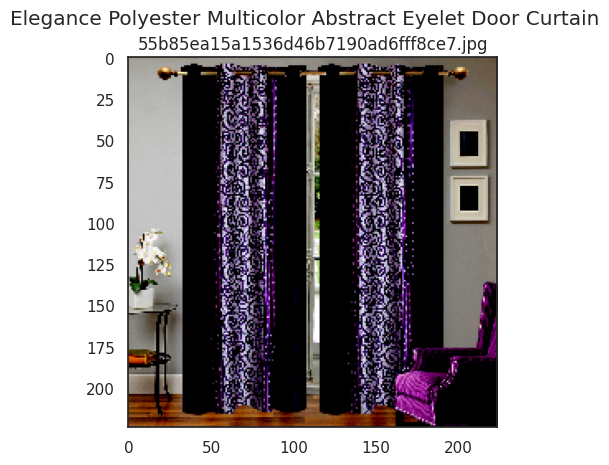

In [ ]:
plt.imshow(X[0])
plt.title(z[0])
plt.suptitle(get_product_name_from_filename(df_data, z[0]))


In [ ]:
# import tensorflow as tf
# from tensorflow.keras.utils import to_categorical
import random
# Assuming you want a constant seed for reproducibility
RANDOM_SEED = 42

def labels_to_categorical(labels_, label_encoder):
    label_encoded = label_encoder.transform(labels_)
    ohe = tf.keras.utils.to_categorical(label_encoded, len(le.classes_))
    return ohe


print(f'sample labels : {y[0:6]}')
Y = labels_to_categorical(y, label_encoder=le)
print(Y.shape)
print(f'sample encode : {Y[0:6]}')

sample labels : ['Home Furnishing' 'Baby Care' 'Baby Care' 'Home Furnishing'
 'Home Furnishing' 'Watches']
(1050, 7)
sample encode : [[0. 0. 0. 0. 1. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [1. 0. 0. 0. 0. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 1.]]


### Train test splitWe add the list of filenames

In [ ]:
# from sklearn.model_selection import train_test_split

# Create a test set
x_train, x_test, y_train, y_test, z_train, z_test = train_test_split(
    X, Y, z, test_size=0.2, random_state=RANDOM_SEED)


### Choice of loss functionIf we want to know the classification probabilities:- y = ohe_encode (labels)- loss= categorical_crossentropy ,- the model predictions display the weights on each category,If we want the most probable classification:- y = label_encode(labels)- loss = sparse_categorical_crossentropy- model predictions display argmax of encoded categoriesReferences- https://machinelearningmastery.com/how-to-choose-loss-functions-when-training-deep-learning-neural-networks/- https://machinelearningmastery.com/cross-entropy-for-machine-learning/### Optimizer ChoiceAdam: Adaptive moment estimation- https://towardsdatascience.com/optimizers-for-training-neural-network-59450d71caf6- https://towardsdatascience.com/7-tips-to-choose-the-best-optimizer-47bb9c1219e

### Fit modelFirst step: know the classification probabilities, to know if the classification is close or farIf we use sparse_categorical_crossentropy, we do not have access to this information.

In [ ]:
PREPROCESS_PARAMS = None
image_data = load_image_data(df_data, preprocess_params=PREPROCESS_PARAMS)
X, y, z = split_image_data(image_data)
X = preprocess_input_tf(X)
# for categorical_crossentropy, use ohe encoding,
# for sparse_categorical_cross_entropy, use label_encoding
Y = labels_to_categorical(y, le)
# split entre train 80% et validation (20%)
x_train, x_val, y_train, y_val, z_train, z_val = train_test_split(
    X, Y, z, test_size=0.2, random_state=RANDOM_SEED)
# si besoin, on peut diviser validation en 2 (validation 10% et test 10%):
x_val, x_test, y_val, y_test, z_val, z_test = train_test_split(
    x_val, y_val, z_val, test_size=0.5, random_state=RANDOM_SEED)

model = create_CNN_simple(nb_classes=7)
# categorical_crossentropy :  les % dans chaque category
# sparse_categorical_crossentropy :  le category avec la plus grande poids
model.compile(optimizer='adam', loss='categorical_crossentropy',
              metrics=['accuracy'])
batch_size = 32
nb_epochs = 10

history = model.fit(x_train, y_train, batch_size=batch_size,
                    epochs=nb_epochs, verbose=1, validation_data=(x_val, y_val))


image_processing_time : 13.6 s


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


Epoch 1/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 1s/step - accuracy: 0.2266 - loss: 1.9814 - val_accuracy: 0.4476 - val_loss: 1.5170
Epoch 2/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 35s 995ms/step - accuracy: 0.4831 - loss: 1.4342 - val_accuracy: 0.4857 - val_loss: 1.4241
Epoch 3/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 999ms/step - accuracy: 0.6153 - loss: 1.1508 - val_accuracy: 0.4762 - val_loss: 1.5791
Epoch 4/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 993ms/step - accuracy: 0.6385 - loss: 0.9803 - val_accuracy: 0.5238 - val_loss: 1.4093
Epoch 5/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 40s 970ms/step - accuracy: 0.7677 - loss: 0.7546 - val_accuracy: 0.5143 - val_loss: 1.3549
Epoch 6/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 966ms/step - accuracy: 0.8320 - loss: 0.5451 - val_accuracy: 0.5810 - val_loss: 1.3412
Epoch 7/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 967ms/step - accuracy: 0.8693 - loss: 0.4361 - val_accuracy: 0.4857 - val_loss: 1.6166
Epoch 8/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 964ms/step - accuracy: 0.8839 - loss: 0.3542 - val_accurac

## 5.4 History Evolution- https://machinelearningmastery.com/display-deep-learning-model-training-history-in-keras/

In [ ]:
# list all data in history
print(history.history.keys())


dict_keys(['accuracy', 'loss', 'val_accuracy', 'val_loss'])


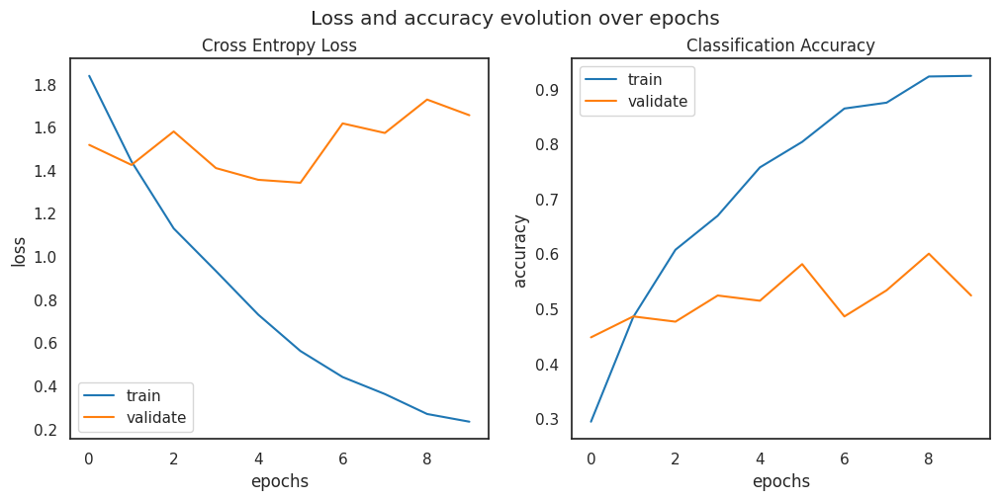

In [ ]:

def plot_diagnostic_learning_curves(model_info):
    """Plot summary diagnostics from history of model training"""
    colors = sns.color_palette('tab10')
    fig, axs = plt.subplots(1, 2, figsize=(12, 5))
    # plot loss
    ax1 = axs[0]
    ax1.set_title('Cross Entropy Loss')
    ax1.plot(model_info.history['loss'], c=colors[0], label='train')
    ax1.plot(model_info.history['val_loss'], c=colors[1], label='validate')
    ax1.set_xlabel('epochs')
    ax1.set_ylabel('loss')
    ax1.legend()
    # plot accuracy
    ax2 = axs[1]
    ax2.set_title('Classification Accuracy')
    ax2.plot(model_info.history['accuracy'], c=colors[0], label='train')
    ax2.plot(model_info.history['val_accuracy'], c=colors[1], label='validate')
    ax2.legend()
    ax2.set_xlabel('epochs')
    ax2.set_ylabel('accuracy')
    fig.suptitle('Loss and accuracy evolution over epochs')


plot_diagnostic_learning_curves(history)


We see that the accuracy of the model on the test data does not improve significantly after 5 epochs: - The model does overfitting on the training data- cross-entropy loss is not reducedWe do not expect a significant improvement of the model with more training

## 5.5 Evaluation de performance du model (accuracy, score)We test with data that has never been seen by the model

In [ ]:
score = model.evaluate(x_val, y_val, verbose=0)
print(f'Validation score (entropy): {score[0]:.3f}')
print(f'Validation accuracy: {round(score[1]*100,1)} %')


Validation score (entropy): 1.655
Validation accuracy: 52.4 %


In [ ]:
score = model.evaluate(x_test, y_test, verbose=0)
print(f'Test score (entropy): {score[0]:.3f}')
print(f'Test accuracy: {round(score[1]*100,1)} %')


Test score (entropy): 1.343
Test accuracy: 63.8 %


In [ ]:
val_pred = model.predict(x_test)
val_true = y_test
print(val_pred.shape, val_true.shape)


4/4 ━━━━━━━━━━━━━━━━━━━━ 1s 286ms/step
(105, 7) (105, 7)


In [ ]:
val_true[0:5]


array([[0., 0., 0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1., 0., 0.],
       [0., 0., 1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1., 0., 0.]])

In [ ]:
val_true.argmax(axis=1)[0:5]


array([5, 4, 2, 2, 4])

The model has an accuracy of about 50%, which is not improved with more epochs

In [ ]:
def cnn_results(filenames, y_true, y_pred, label_encoder):
    """
    Convertir les donnees X (pixels) et labels y (0...n) en forme comprehensible:
    Parameters
    ----------
    filenames   nom du fichier de l'image répresenté par X
    y_true      label_encoded version de true label
    y_pred      label_encoded version des predictions
    label_encoder : l'encoder utilisé pour convertir

    Returns
    -----------
    - l'inverse transform des labels y, associe à chaque image représenté par X"""
    y_pred_pct = np.round(y_pred*100, 2)
    s_filenames = pd.Series(filenames, name='filename')
    s_true = pd.Series(label_encoder.inverse_transform(
        y_true.argmax(axis=1)), name='label_true')
    s_pred = pd.Series(label_encoder.inverse_transform(
        y_pred.argmax(axis=1)), name='label_pred')
    s_prob_pred = pd.Series(y_pred_pct.max(axis=1), name='prob_pred')
    df_pred = pd.DataFrame(y_pred_pct, columns=label_encoder.classes_)
    return pd.concat([s_filenames, s_true, s_pred, s_prob_pred, df_pred], axis=1)


df_val_pred = cnn_results(z_val, val_true, val_pred, le)
df_val_pred.head()


,filename,label_true,label_pred,prob_pred,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
0,d75705ad163412347cba51f882e9c0f0.jpg,Kitchen & Dining,Kitchen & Dining,97.40,0.15,0.04,0.06,0.52,1.74,97.40,0.08
1,9ba898ecb77ab5a6799c8b047c6b6008.jpg,Home Furnishing,Home Furnishing,99.25,0.18,0.00,0.05,0.39,99.25,0.01,0.12
2,52c5fe837181962a7c1d5883bb9d7007.jpg,Computers,Computers,94.18,2.66,0.88,94.18,1.60,0.08,0.56,0.05
3,31ac1b66cc6bb396c83f124317589f8c.jpg,Computers,Computers,82.38,4.74,1.75,82.38,3.20,0.36,7.39,0.18
4,362714cbba2f5ae412d2f26bae99a266.jpg,Home Furnishing,Home Decor & Festive Needs,43.82,33.99,5.84,0.20,43.82,16.15,0.00,0.00


ARI = 0.333
                            precision    recall  f1-score   support

                 Baby Care       0.42      0.62      0.50        16
  Beauty and Personal Care       0.56      0.56      0.56         9
                 Computers       0.65      0.81      0.72        16
Home Decor & Festive Needs       0.50      0.43      0.46        14
           Home Furnishing       0.71      0.60      0.65        20
          Kitchen & Dining       0.88      0.58      0.70        12
                   Watches       0.93      0.78      0.85        18

                  accuracy                           0.64       105
                 macro avg       0.66      0.63      0.63       105
              weighted avg       0.67      0.64      0.64       105

"Clustering_sur_CNN_simple_entrainé_-_confusion_matrix_(ARI=0-333).png"


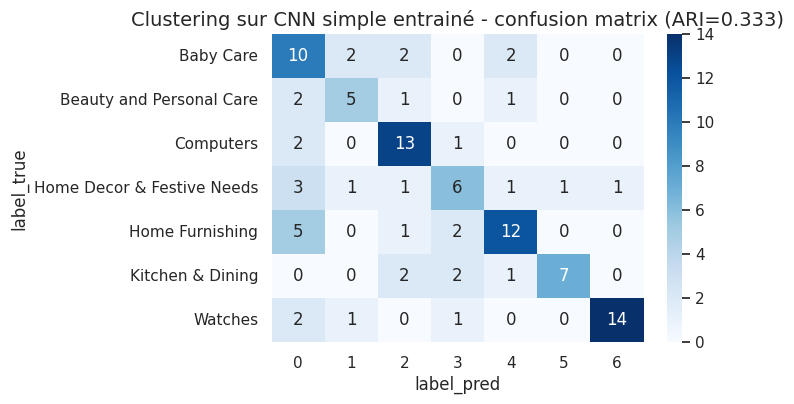

In [ ]:
ari_cnn=plot_classification_metrics(df_val_pred['label_true'], df_val_pred['label_pred'])
plt.gca().set_xticklabels(range(7), rotation=0)
plt.title(f'Clustering sur CNN simple entrainé - confusion matrix (ARI={ari_cnn:.3f})', fontsize=14)
to_png()
df_resultats=add_model_score(model_name='CNN simple',ARI=ari_cnn, k=7)

label_true label_pred
(49, 3)
Index(['label_true', 'variable', 'value'], dtype='object')


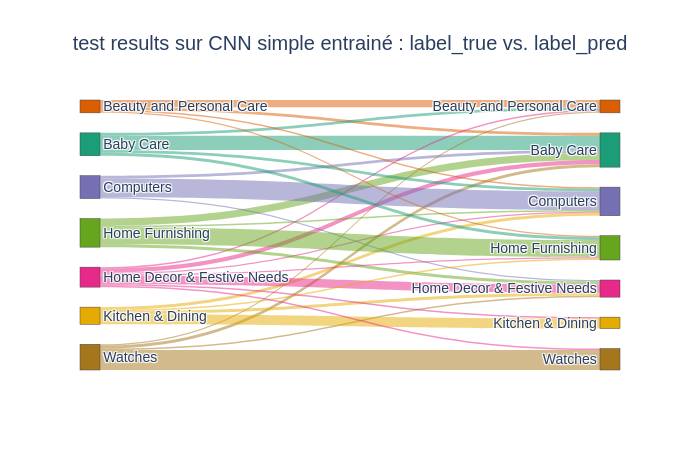

In [ ]:

plot_sankey_confusion_diagram(df_val_pred['label_true'], df_val_pred['label_pred'], palette='Dark2',
    titre='test results sur CNN simple entrainé',to_image=True)

We look at the predictions for all data

In [ ]:
val_pred = model.predict(X)
val_true = Y
print(val_pred.shape, val_true.shape)


33/33 ━━━━━━━━━━━━━━━━━━━━ 14s 418ms/step
(1050, 7) (1050, 7)


In [ ]:
df_val_pred = cnn_results(z, val_true, val_pred, le)
df_val_pred.head()


,filename,label_true,label_pred,prob_pred,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,Home Furnishing,98.08,1.90,0.00,0.00,0.02,98.08,0.00,0.00
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,Baby Care,94.86,94.86,0.11,0.01,0.50,4.49,0.01,0.02
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,Baby Care,38.24,38.24,14.00,0.05,8.98,38.15,0.58,0.01
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,Baby Care,51.37,51.37,0.44,1.69,5.21,37.70,0.22,3.37
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,Home Furnishing,86.01,4.14,8.77,0.03,1.06,86.01,0.00,0.00


label_true label_pred
(49, 3)
Index(['label_true', 'variable', 'value'], dtype='object')


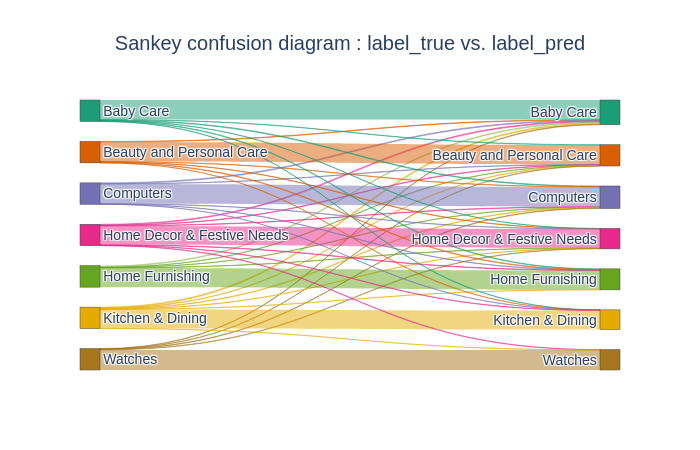

In [ ]:
plot_sankey_confusion_diagram(
    df_val_pred['label_true'], df_val_pred['label_pred'], palette='Dark2')


We look at the misclassified images

In [ ]:
def get_wrongly_classed(df, true_col='label_true', pred_col='label_pred', probability_col='prob_pred'):
    return df[df[true_col] != df[pred_col]].sort_values(by=[probability_col], ascending=False)


wrong_class = get_wrongly_classed(df_val_pred)
wrong_class.head()


,filename,label_true,label_pred,prob_pred,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
381,079d049de21fb2426b516a8d2f9a8bdb.jpg,Beauty and Personal Care,Computers,99.15,0.00,0.24,99.15,0.16,0.29,0.15,0.00
425,60a7313ea1e0ee8d845a0a6dec6117cc.jpg,Computers,Kitchen & Dining,98.42,0.02,0.05,0.39,0.80,0.32,98.42,0.00
113,0ddc40c08d9a9bafc4d14eddd98db7c0.jpg,Kitchen & Dining,Baby Care,97.20,97.20,0.21,0.55,0.08,1.33,0.37,0.27
917,27175ea71cc5f2879882c77b9931cf8b.jpg,Home Decor & Festive Needs,Watches,96.97,0.02,0.02,2.29,0.02,0.66,0.02,96.97
63,f4e7f269319ba9cf5507a9e2febacbf5.jpg,Baby Care,Home Furnishing,96.23,3.30,0.01,0.00,0.45,96.23,0.00,0.00


Visualise badly classed products

['079d049de21fb2426b516a8d2f9a8bdb.jpg', '60a7313ea1e0ee8d845a0a6dec6117cc.jpg', '0ddc40c08d9a9bafc4d14eddd98db7c0.jpg', '27175ea71cc5f2879882c77b9931cf8b.jpg', 'f4e7f269319ba9cf5507a9e2febacbf5.jpg', '04f9f818e2d657b873b07578cfe2eade.jpg', 'd75705ad163412347cba51f882e9c0f0.jpg', '2670ba9bc61b42937773486ddcae442a.jpg', '77f659d4d18381c991fb9210e05d9c1b.jpg', '55ce1309b69e1912d2fd60a3ee3f351b.jpg']
['Computers (99 %)', 'Kitchen & Dining (98 %)', 'Baby Care (97 %)', 'Watches (97 %)', 'Home Furnishing (96 %)', 'Baby Care (96 %)', 'Home Furnishing (95 %)', 'Baby Care (95 %)', 'Beauty and Personal Care (94 %)', 'Home Furnishing (94 %)']
"Mal_classés.png"


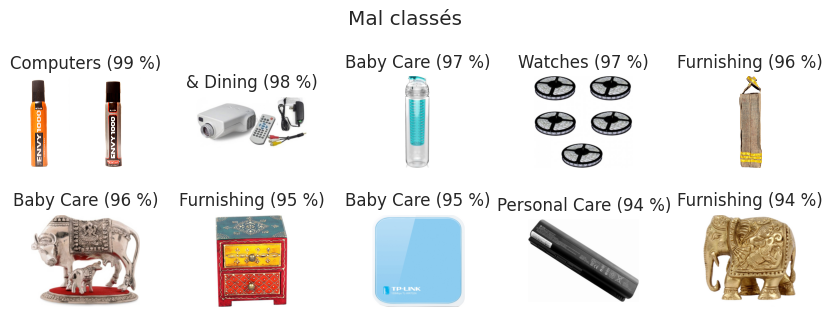

In [ ]:
def label_probability(row):
    label_pred = row['label_pred']
    prob_pred = row['prob_pred']
    return f'{label_pred} ({prob_pred:.0f} %)'


images = list(wrong_class['filename'][:10])
titles = list(wrong_class.head(10).apply(label_probability, axis=1))
print(images)
print(titles)
preview_images(images, titles, 'Mal classés')


In [ ]:
# cleanup
del model
del history
tf.keras.backend.clear_session()


## 5.6 Repeat, but with sparse_category

In [ ]:
# from sklearn.model_selection import train_test_split
PREPROCESS_PARAMS = None
image_data = load_image_data(df_data, preprocess_params=PREPROCESS_PARAMS)
X, y, z = split_image_data(image_data)
# normalise X (valeurs entre -1 et 1)
X = preprocess_input_tf(X)
# encode class labels
Y = le.transform(y)
# split entre train 80% et validation (20%)
x_train, x_val, y_train, y_val, z_train, z_val = train_test_split(
    X, Y, z, test_size=0.2, random_state=RANDOM_SEED)
# si besoin, on peut diviser validation en 2 (validation 10% et test 10%):
# x_val,x_test,y_val,y_test, z_val, z_test =train_test_split(x_val,y_val,z_val,test_size=0.5, random_state=RANDOM_SEED)

model = create_CNN_simple(nb_classes=7)
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy', metrics=['accuracy'])
batch_size = 32
nb_epochs = 10

history = model.fit(x_train, y_train, batch_size=batch_size,
                    epochs=nb_epochs, verbose=1, validation_data=(x_val, y_val))


image_processing_time : 13.5 s


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



Epoch 1/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 34s 1s/step - accuracy: 0.2222 - loss: 1.9395 - val_accuracy: 0.4905 - val_loss: 1.4189
Epoch 2/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 39s 1s/step - accuracy: 0.4886 - loss: 1.4310 - val_accuracy: 0.5095 - val_loss: 1.3893
Epoch 3/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.6044 - loss: 1.1784 - val_accuracy: 0.5286 - val_loss: 1.3176
Epoch 4/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.6787 - loss: 0.9790 - val_accuracy: 0.5667 - val_loss: 1.2691
Epoch 5/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 39s 1s/step - accuracy: 0.7566 - loss: 0.7619 - val_accuracy: 0.5667 - val_loss: 1.2524
Epoch 6/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.8150 - loss: 0.6059 - val_accuracy: 0.5429 - val_loss: 1.2831
Epoch 7/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 41s 1s/step - accuracy: 0.8343 - loss: 0.4839 - val_accuracy: 0.5238 - val_loss: 1.5415
Epoch 8/10
27/27 ━━━━━━━━━━━━━━━━━━━━ 42s 1s/step - accuracy: 0.8929 - loss: 0.3720 - val_accuracy: 0.5714 - val_loss:

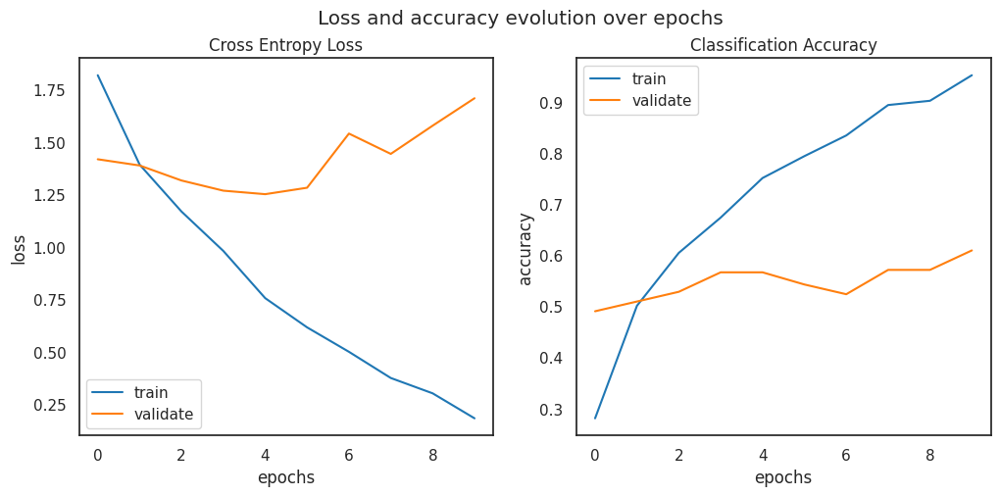

In [ ]:
plot_diagnostic_learning_curves(history)


In [ ]:
# Cleanup
del history

# import tensorflow as tf
del model
tf.keras.backend.clear_session()


## 5.7 Dataset tensors: ways to create out-of-memory datasetsHere we use the data sets in memory, to be faster.Most of the time, you can't process all the data at once. You have to process iteratively.Below are the procedures with tensor datasets

In [ ]:

# from sklearn.model_selection import train_test_split

def datasets_from_numpy(images, labels, filenames, label_encoder=None, loss='categorical_crossentropy', stratified=False):
    if stratified:
        x_train, x_test, y_train, y_test, z_train, z_test = train_test_split(
            images, labels, filenames, train_size=0.2, stratify=labels, random_state=RANDOM_SEED)
    else:
        x_train, x_test, y_train, y_test, z_train, z_test = train_test_split(
            images, labels, filenames, train_size=0.2, random_state=RANDOM_SEED)

    if label_encoder:
        if loss == 'sparse_categorical_crossentropy':
            # if using loss='ca
            y_train = label_encoder.transform(y_train)
            y_test = label_encoder.transform(y_test)
        else:
            y_train = labels_to_categorical(y_train, label_encoder)
            y_test = labels_to_categorical(y_test, label_encoder)

    train_ds = tf.data.Dataset.from_tensor_slices((x_train, y_train))
    test_ds = tf.data.Dataset.from_tensor_slices((x_test, y_test))
    return train_ds, test_ds


def fit_model_from_numpy(model_, images_, labels_, filenames_, label_encoder=None, loss=None, batch_size=32, nb_epochs=1, stratified=False):

    train_ds, test_ds = datasets_from_numpy(
        images_, labels_, filenames_, label_encoder, loss=loss, stratified=stratified)
    SHUFFLE_BUFFER_SIZE = 100
    train_ds = train_ds.shuffle(SHUFFLE_BUFFER_SIZE).batch(batch_size)
    test_ds = test_ds.batch(batch_size)
    history = model_.fit(train_ds, epochs=nb_epochs,
                         validation_data=test_ds)
    return history, model_

# ---------------------------------------
# Fine tuning of preprocessing


# PREPROCESS_PARAMS={'resize':{'sq_size':224},'equalize':True,'squarify':True}
# PREPROCESS_PARAMS={'resize':{'sq_size':224},'equalize':True,'squarify':False}
# PREPROCESS_PARAMS=None
MODEL_PARAMS = dict(loss='sparse_categorical_crossentropy')
# image_data = load_image_data(df_data, preprocess_params=PREPROCESS_PARAMS)
X, y, z = split_image_data(image_data)
X = preprocess_input_tf(X)
model = create_CNN_simple(nb_classes=7)
model.compile(optimizer='adam',
              loss=MODEL_PARAMS['loss'], metrics=['accuracy'])
history, model = fit_model_from_numpy(model, X, y, z, label_encoder=le, loss=MODEL_PARAMS['loss'],
                                      stratified=True, nb_epochs=10)


Epoch 1/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 21s 3s/step - accuracy: 0.1576 - loss: 2.1889 - val_accuracy: 0.2714 - val_loss: 1.8805
Epoch 2/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 19s 3s/step - accuracy: 0.3377 - loss: 1.7857 - val_accuracy: 0.3131 - val_loss: 1.7993
Epoch 3/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - accuracy: 0.5114 - loss: 1.5575 - val_accuracy: 0.3607 - val_loss: 1.7045
Epoch 4/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - accuracy: 0.6763 - loss: 1.2264 - val_accuracy: 0.3869 - val_loss: 1.6832
Epoch 5/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - accuracy: 0.7268 - loss: 0.9252 - val_accuracy: 0.4381 - val_loss: 1.7194
Epoch 6/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - accuracy: 0.7358 - loss: 0.7322 - val_accuracy: 0.4036 - val_loss: 1.8555
Epoch 7/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 17s 3s/step - accuracy: 0.8346 - loss: 0.6263 - val_accuracy: 0.4690 - val_loss: 1.7095
Epoch 8/10
7/7 ━━━━━━━━━━━━━━━━━━━━ 18s 3s/step - accuracy: 0.8999 - loss: 0.3719 - val_accuracy: 0.4560 - val_loss: 1.8979
Epoch 9/

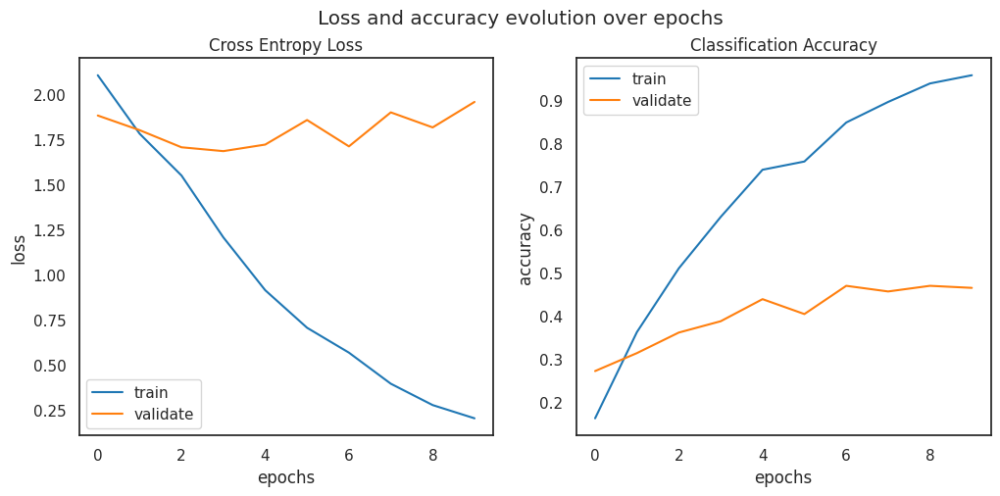

In [ ]:
plot_diagnostic_learning_curves(history)


In [ ]:
# cleanup
del model
del history
tf.keras.backend.clear_session()


### Datasets (train, test) from DataFrameIf the in-memory images (like numpy array) are too large, tensor flow includes a function to load the images from a dataframe.Below, the preprocessing is done during stream, which means that the data is preprocessed at each epoch.

In [ ]:
# import tensorflow as tf
ImageDataGenerator= tf.keras.preprocessing.image.ImageDataGenerator


def datasets_from_df(df: pd.DataFrame,
                     preprocess_fct=preprocess_input_torch, image_size=(224, 224), batch_size=32, flow_params={}):

    dataset_params = dict(
        x_col='image', y_col='categ_level_1',
        directory=IMG_FOLDER,
        # comment cette ligne si on ne veut pas sauvegarder les images
        # save_to_dir='data/out/generated', save_format='jpg',
        class_mode='categorical', batch_size=batch_size, target_size=image_size)

    if not flow_params is None:
        dataset_params = dict(**dataset_params, **flow_params)

    if 'dataset' in df.columns:
        # Use stratified split des categories
        train_df = df[df['dataset'] == 'train']
        validation_df = df[df['dataset'] == 'validation']

        datagen = ImageDataGenerator(
            preprocessing_function=preprocess_fct,
            # target_size=image_size,
        )
        train_ds = datagen.flow_from_dataframe(train_df, **dataset_params)
        validation_ds = datagen.flow_from_dataframe(
            validation_df, **dataset_params)

    else:
        # non-stratified split
        datagen = ImageDataGenerator(
            preprocessing_function=preprocess_fct,
            # target_size=image_size,
            validation_split=0.2,
        )
        train_ds = datagen.flow_from_dataframe(
            df, subset='training', **dataset_params)
        validation_ds = datagen.flow_from_dataframe(
            df, subset='validation', **dataset_params)

    return train_ds, validation_ds


def fit_model_from_dataframe(model_, df, preprocess_fct=preprocess_input_tf, image_size=(224, 224),
                             batch_size=32, nb_epochs=1, flow_params=None):
    train_ds, test_ds = datasets_from_df(df, preprocess_fct=preprocess_fct,
                                         image_size=image_size, batch_size=batch_size)

    history = model_.fit(train_ds, epochs=nb_epochs, validation_data=test_ds)
    return history, model_

# ---------------------------------------
# Fine tuning of preprocessing


# PREPROCESS_PARAMS={'resize':{'sq_size':224},'equalize':True,'squarify':True}
# PREPROCESS_PARAMS={'resize':{'sq_size':224},'equalize':True,'squarify':False}
MODEL_PARAMS = dict(
    preprocess_fct=preprocess_input_tf,
    flow_params=dict(x_col='image', y_col='categ_level_1',
                     directory=IMG_FOLDER,
                     # comment cette ligne si on ne veut pas sauvegarder les images
                     # save_to_dir='data/out/generated', save_format='jpg',
                     class_mode='categorical', target_size=(224, 224))
)
model = create_CNN_simple(nb_classes=7)
model.compile(optimizer='adam', loss='categorical_crossentropy',
              metrics=['accuracy'])
# Beaucoup plus long
# history, model = fit_model_from_dataframe(
#     model, df_data, **MODEL_PARAMS, nb_epochs=5)


/usr/local/lib/python3.11/dist-packages/keras/src/layers/convolutional/base_conv.py:107: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



We see that the model accuracy is high, but the validation is low.Maybe it's because we didn't do a stratified split.

### Dataset from directory (with flow)Dataset from dataframe is slow, and this function is not very parameterizable.If our data is already placed in the folders of each class, we can create datasets without needing a dataframeMost examples use this method, which is not the most suitable for our dataset- In another notebook I implemented a series of procedures for- Stratified split (optional):- split df entre df_train, df_valid, df_test- create/replace train, valid, test folders to receive the images- For each dataset, preprocess the images (if necessary) and put them in subfolders according to their class_label- create datasets from these imagesAdvantage: you can use- from tensorflow.keras.applications.model_name import preprocess_input, decode_predictions; ou- from tensorflow.keras.applications.imagenet_utils import decode_predictions

### Memory cleaning

In [ ]:
# Cleanup

# import tensorflow as tf
# del history
del model
tf.keras.backend.clear_session()


## 5.8 VGG-16 model without trainingThis model is very slow to train with in-memory data (about 20 minutes per epoch)

In [ ]:
def test_my_vgg16(x_train_, y_train_, x_val_, y_val_, label_encoder, x_test_=None, y_test_=None):
    model_VGG16 = create_VGG16(nb_classes=len(label_encoder.classes_))
    model_VGG16.compile(
        optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    batch_size = 32
    nb_epochs = 1
    history = model_VGG16.fit(x_train_, y_train_, batch_size=batch_size, epochs=nb_epochs,
                              verbose=1, validation_data=(x_val_, y_val_))

    if nb_epochs > 2:
        plot_diagnostic_learning_curves(history)

    score = model_VGG16.evaluate(x_val_, y_val_, verbose=0)
    print(f'Validation score (entropy): {score[0]:.3f}')
    print(f'Validation accuracy: {round(score[1]*100,1)} %')

    score = model_VGG16.evaluate(x_test_, y_test_, verbose=0)
    print(f'Test score (entropy): {score[0]:.3f}')
    print(f'Test accuracy: {round(score[1]*100,1)} %')


image_data = load_image_data(df_data, preprocess_params=PREPROCESS_PARAMS)
X, y, z = split_image_data(image_data)
# normalise X (valeurs entre -1 et 1)
X = preprocess_input_tf(X)
# encode class labels
Y = le.transform(y)
# split entre train 80% et validation (20%)
x_train, x_val, y_train, y_val, z_train, z_val = train_test_split(
    X, Y, z, test_size=0.2, random_state=RANDOM_SEED)
# si besoin, on peut diviser validation en 2 (validation 10% et test 10%):
x_val, x_test, y_val, y_test, z_val, z_test = train_test_split(
    x_val, y_val, z_val, test_size=0.5, random_state=RANDOM_SEED)

# test_my_vgg16(x_train,y_train,x_val,y_val, le, x_test,y_test)


image_processing_time : 13.6 s


After 13 minutes (1 epoch):```textimage_processing_time : 12.3 s27/27 [==============================] - 721s 27s/step - loss: 4.6106 - accuracy: 0.1440 - val_loss: 1.9441 - val_accuracy: 0.1143Validation score (entropy): 1.944Validation accuracy: 11.4 %Test score (entropy): 1.956Test accuracy: 8.6 %

It will take time to train this model with our 1000 images, and probably we need to increase the imagesWe will accelerate learning with Transfer Learning

#6. Classification with pre-trained VGG16

## 6.1 Classification avec pretrained VGG16 (1000 classes d'ImageNet)Since the creation of VGG-16 in 2014, there will be performance advancements- https://paperswithcode.com/sota/image-classification-on-imagenet- https://machinelearningmastery.com/use-pre-trained-vgg-model-classify-objects-photographs/- https://stackabuse.com/image-classification-with-transfer-learning-in-keras-create-cutting-edge-cnn-models/

In [ ]:
# import tensorflow as tf
tf.keras.backend.clear_session()

# Charger VGG-16 pré-entraîné sur ImageNet et sans les couches fully-connected
model = tf.keras.applications.vgg16.VGG16(
    weights='imagenet', include_top=True, input_shape=(224, 224, 3))


553467096/553467096 ━━━━━━━━━━━━━━━━━━━━ 11s 0us/step


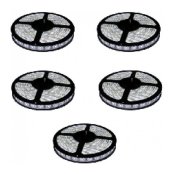

In [ ]:
# import tensorflow as tf
# from tensorflow.keras.preprocessing.image import load_img

# load an image from file
file = f"{wrong_class['filename'].iloc[3]}"
image = tf.keras.preprocessing.image.load_img(f'{IMG_FOLDER}/{file}', target_size=(224, 224))
preview_image(img=image)
plt.show()


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 769ms/step
35363/35363 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
bath_towel (100%)


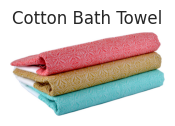

In [ ]:
# preprocess_input, decode_predictions
vgg16 =tf.keras.applications.vgg16

# load the model
# model = VGG16()
# load an image from file
file = f"{wrong_class['filename'].iloc[3]}"
FILES = list(df_data['image'])


def predict_image(filename=None, model=model, decoder_fct=vgg16.decode_predictions, file_path=IMG_FOLDER, preview=False):
    """Prédire une image(enregistré dans IMG_FOLDER) avec un model, utilisant """
    if filename is None:
        filename = np.random.choice(FILES)
    if file_path is None:
        image = tf.keras.preprocessing.image.load_img(filename, target_size=(224, 224))
    else:
        image = tf.keras.preprocessing.image.load_img(f'{file_path}/{filename}', target_size=(224, 224))
    # convert the image pixels to a numpy array
    image = tf.keras.preprocessing.image.img_to_array(image)
    # reshape data for the model
    image = image.reshape((1, image.shape[0], image.shape[1], image.shape[2]))
    # prepare the image for the VGG model
    image = tf.keras.applications.vgg16.preprocess_input(image)
    # predict the probability across all output classes
    yhat = model.predict(image)
    # convert the probabilities to class labels
    try:
        label = decoder_fct(yhat)
        # retrieve the most likely result, e.g. highest probability
        label = label[0][0]
        # print the classification
        classification = f'{label[1]} ({(label[2]*100):.0f}%)'
        print(classification)
    except:
        print(yhat)
    if preview:
        preview_image(filename=filename)


predict_image(FILES[1], preview=True)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
digital_watch (82%)


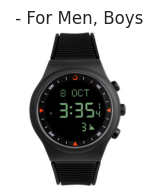

In [ ]:
predict_image(FILES[8], preview=True)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 592ms/step
coffee_mug (98%)


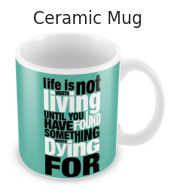

In [ ]:
predict_image(FILES[50], preview=True)


It seems that VGG16, pre-trained on ImageNet, is well capable of classifying our images.We see if the trained model is capable of unsupervised categorization (semi-supervised, because it uses the 1000 ImageNet categories)

## 6.2 Semi-supervised classification of VGG-16 imagesWe can do (semi-supervised) clustering on this VGG-16 model (trained on our images) to find clusters similar to the categoriesIf we don't want to use the provided categories, we can use the features of VGG-16 (trained on ImageNet) for new categories- https://towardsdatascience.com/image-clustering-using-k-means-4a78478d2b83

In [ ]:
df_image_labels = df_data[['image', 'categ_level_1']].copy()
df_image_labels['file'] = IMG_FOLDER + '/' + df_image_labels['image']
df_image_labels.head()


,image,categ_level_1,file
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,data/raw/Flipkart/Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,data/raw/Flipkart/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,data/raw/Flipkart/Images/64d5d4a258243731dc7bbb1eef49ad74.jpg
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,data/raw/Flipkart/Images/d4684dcdc759dd9cdf41504698d737d8.jpg
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,data/raw/Flipkart/Images/6325b6870c54cd47be6ebfbffa620ec7.jpg


In [ ]:
filelist = list(df_image_labels['file'])
print(filelist[:3])


['data/raw/Flipkart/Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg', 'data/raw/Flipkart/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg', 'data/raw/Flipkart/Images/64d5d4a258243731dc7bbb1eef49ad74.jpg']


In [ ]:
predict_image(filelist[0], model, file_path=None)


1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
four-poster (37%)


In [ ]:
from PIL import Image
import numpy as np
from tensorflow.keras.preprocessing import image

def extract_features(img_path, model, target_size=(224, 224)):
    try:
        img = Image.open(img_path).convert("RGB").resize(target_size)
        img_array = image.img_to_array(img)
        img_array = np.expand_dims(img_array, axis=0)  # shape: (1, h, w, 3)
        img_array /= 255.0  # normalize if needed

        features = model.predict(img_array)  # no use_multiprocessing
        return features.squeeze()  # ensure shape is (1000,) or similar
    except Exception as e:
        print(f"[extract_features] Failed to process {img_path}: {e}")
        return None


In [ ]:
import numpy as np
import pickle
import time
import traceback

def extract_all_features(filelist, model, nb=100, pickle_location='data/out/features.pkl'):
    data = {}
    p = pickle_location

    nb = min(nb, len(filelist))
    nb_10 = max(1, nb // 10)

    imagelist = filelist[:nb]
    nb = len(imagelist)

    print(f"Starting feature extraction for {nb} images...")
    start = time.time()

    for i, image in enumerate(imagelist):
        try:
            feat = extract_features(image, model)

            # Validate feature is not None and has shape
            if feat is not None and isinstance(feat, np.ndarray):
                feat = feat.flatten()  # Flatten in case it's (1, 1000) or similar
                data[image] = feat
            else:
                print(f"[WARNING] Skipped invalid feature from: {image}")

        except Exception as e:
            print(f"[ERROR] Failed to process image: {image}")
            traceback.print_exc()
            continue  # Move to next image

        # Progress logging
        if (i + 1) % nb_10 == 0:
            taken = time.time() - start
            percent_done = (i + 1) / nb
            total_time = taken / percent_done
            ETA = total_time - taken
            print(f'{int(taken)}s. (ETA: {int(ETA)}s); extract_features : {i + 1} of {nb}')

    if not data:
        raise ValueError("No features were extracted. Please check extract_features() or your image list.")

    # Save extracted features to pickle
    with open(p, 'wb') as file:
        pickle.dump(data, file)

    filenames = np.array(list(data.keys()))
    feat = np.array(list(data.values()))

    try:
        feat = feat.reshape(len(filenames), -1)
    except Exception as e:
        raise ValueError(f"Reshape failed. Inconsistent feature lengths? {e}")

    print(feat.shape)
    return feat, filenames


# Call the function
feat, filenames = extract_all_features(filelist, model, nb=1050)


Starting feature extraction for 1050 images...
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 850ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 859ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 889ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 825ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 916ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 801ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 842ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 952ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 941ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 921ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 836ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 901ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 908ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 833ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 934ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 920ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 913ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 930ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 977ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 883ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 7

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:3402: DecompressionBombWarning:

Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 844ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 917ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 856ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 809ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 954ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 897ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 868ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 872ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 963ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 884ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 947ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 964ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 905ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 857ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 890ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 906ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 907ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 843ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 915ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 813ms/ste

In [ ]:
save_pickle(feat, 'features_vgg16', OUT_FOLDER)

In [ ]:
def pred_categories(files, model, image_labels: pd.DataFrame = df_image_labels):
    for file in files:
        features = extract_features(file, model)

        # Check if features is valid and has the expected shape
        if features is None or not isinstance(features, np.ndarray) or features.ndim < 1 or features.shape[0] != 1000:
            print(f"[WARNING] Invalid features for file: {file}. Skipping...")
            continue

        # output is same shape as number of categories in ImageNet
        y_pred = tf.keras.applications.vgg16.decode_predictions(features.reshape(1, -1), top=1)
        if not image_labels is None:
            y_true = image_labels['categ_level_1']
            # Access the single prediction directly
            _, pred, weight = y_pred[0][0]
            print(f'{y_true.iloc[0]} \t {pred} ({weight*100:.0f}%)')
        else:
            y_pred = np.argmax(features, axis=0)
        return y_pred


_ = pred_categories(filelist[:5], model)

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
Home Furnishing 	 mosquito_net (24%)


In [ ]:
print(filelist[:5])

['data/raw/Flipkart/Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg', 'data/raw/Flipkart/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg', 'data/raw/Flipkart/Images/64d5d4a258243731dc7bbb1eef49ad74.jpg', 'data/raw/Flipkart/Images/d4684dcdc759dd9cdf41504698d737d8.jpg', 'data/raw/Flipkart/Images/6325b6870c54cd47be6ebfbffa620ec7.jpg']


In [ ]:
print(list(df_image_labels['file'])[:5])

['data/raw/Flipkart/Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg', 'data/raw/Flipkart/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg', 'data/raw/Flipkart/Images/64d5d4a258243731dc7bbb1eef49ad74.jpg', 'data/raw/Flipkart/Images/d4684dcdc759dd9cdf41504698d737d8.jpg', 'data/raw/Flipkart/Images/6325b6870c54cd47be6ebfbffa620ec7.jpg']


In [ ]:
# Reduction de dimensions
feat_pca = reducer_pca(feat)
k = len(categories)

# reduction en 2 dimensions tsne, cluster par KMeans, calcul de similarité
ARI_vgg, X_tsne, labels_vgg = calc_tsne_cluster(
    feat_pca, categories, y_cat_num, k)

Dimensions avant réduction PCA : (1050, 1000)
Dimensions après réduction PCA (99 % variance explained) : (1050, 27)
t-SNE done! Time elapsed: 49.0 seconds
Clustering par KMeans, ARI = 0.184


In [ ]:
search_params = {'n_clusters': range(4, 15)}
scores_vgg, labels_vgg = score_kmeans(
    X_tsne, param_grid=search_params, labels_true=df_data['categ_level_1'])
scores_vgg.head()

k=4, fit: 0.02 s, silhouette= 0.422, ARI = 0.132, cluster sizes = [30 25 23 20]
k=5, fit: 0.03 s, silhouette= 0.414, ARI = 0.164, cluster sizes = [23 22 20 18 15]
k=6, fit: 0.02 s, silhouette= 0.416, ARI = 0.179, cluster sizes = [20 20 17 15 14 12]
k=7, fit: 0.02 s, silhouette= 0.426, ARI = 0.184, cluster sizes = [19 16 15 14 13 11  9]
k=8, fit: 0.01 s, silhouette= 0.407, ARI = 0.171, cluster sizes = [16 15 14 13 13 10  9  7]
k=9, fit: 0.05 s, silhouette= 0.395, ARI = 0.172, cluster sizes = [15 12 11 11 10 10 10  9  8]
k=10, fit: 0.04 s, silhouette= 0.403, ARI = 0.167, cluster sizes = [11 10 10 10 10 10  9  9  8  8]
k=11, fit: 0.04 s, silhouette= 0.41, ARI = 0.167, cluster sizes = [11 10 10 10  9  8  8  8  7  7  6]
k=12, fit: 0.02 s, silhouette= 0.413, ARI = 0.156, cluster sizes = [10 10  9  9  9  8  8  8  7  7  5  5]
k=13, fit: 0.03 s, silhouette= 0.402, ARI = 0.161, cluster sizes = [10  9  8  8  8  8  7  7  7  6  6  6  4]
k=14, fit: 0.03 s, silhouette= 0.41, ARI = 0.137, cluster size

,k,min_cluster_pct,distortion_score,davies_bouldin,calinski_harabasz,silhouette_score,fit_time_cluster,ARI,classifier
0,4,20.86,235275.00,0.83,1161.46,0.42,0.02,0.13,KMeans
1,5,15.14,172239.00,0.79,1284.36,0.41,0.03,0.16,KMeans
2,6,12.00,138932.00,0.77,1322.63,0.42,0.02,0.18,KMeans
3,7,9.33,110730.00,0.72,1425.87,0.43,0.02,0.18,KMeans
4,8,7.43,96663.00,0.76,1420.38,0.41,0.01,0.17,KMeans


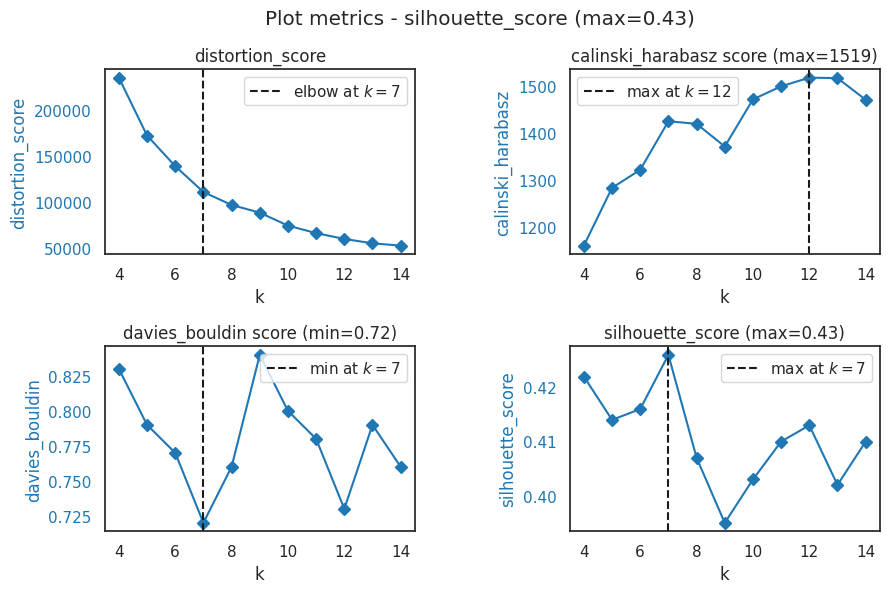

In [ ]:
plot_metrics(scores_vgg)

ARI :  0.1837
"Clustering_non-supervisée_sur_VGG-16,_feature_reduction-_PCA_+_TSNE_(ARI_=_0-184).png"


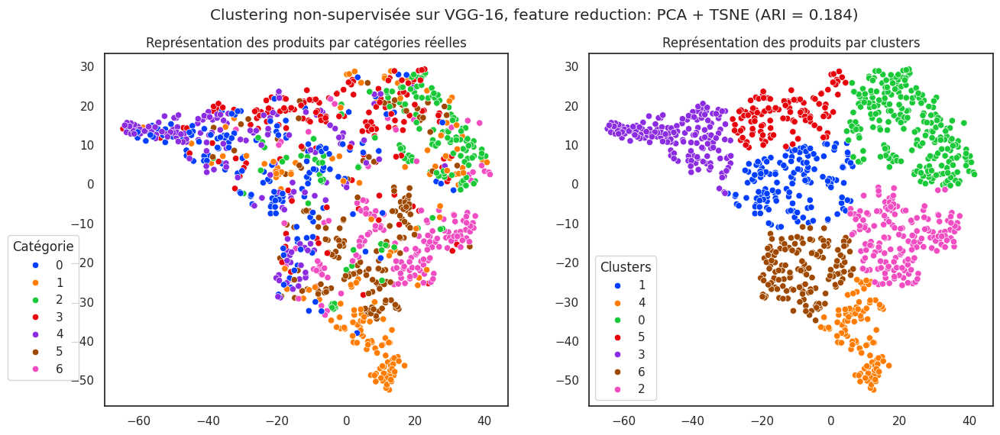

In [ ]:
plot_clusters_sur_2D(X_tsne, y_cat_num, labels_vgg, ARI_vgg)
plt.suptitle(
    f'Clustering non-supervisée sur VGG-16, feature reduction: PCA + TSNE (ARI = {ARI_vgg:.3f})')
to_png()


View images on t-SNE

"Produits_sur_TSNE_pour_clusters_des_features_VGG-16.png"


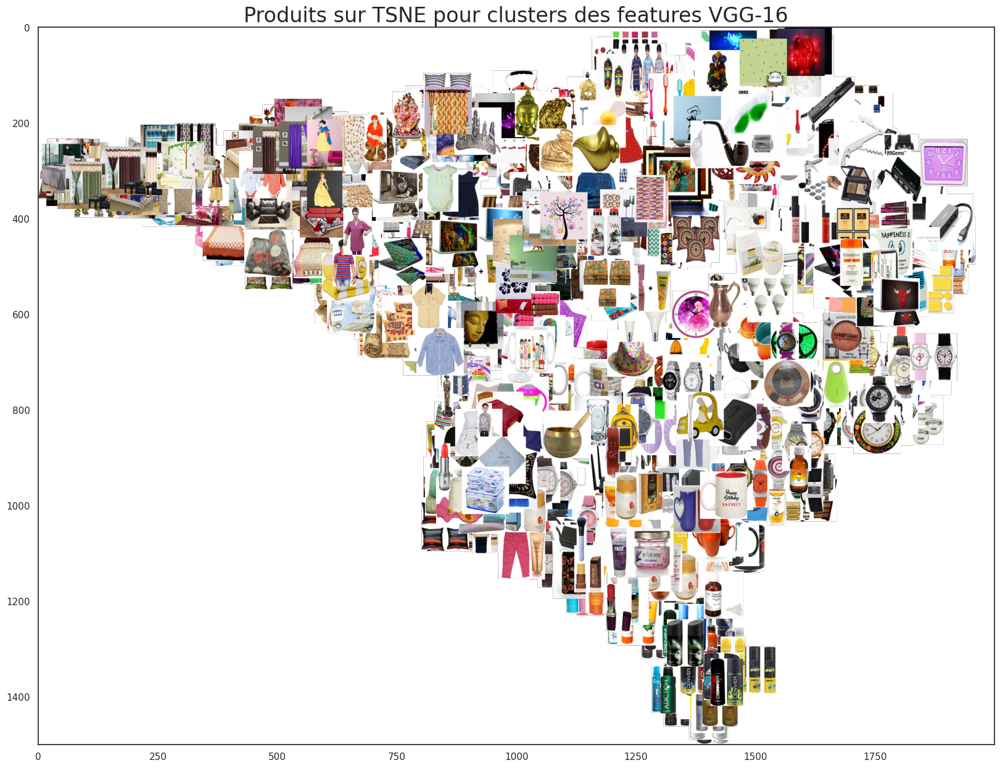

In [ ]:
plot_scatter_with_images(X_tsne, df_data['image'])
plt.title('Produits sur TSNE pour clusters des features VGG-16', fontsize=24)
to_png()


### Evaluation metrics

[1 4 0 5 3 6 2]
Correspondance des clusters : [2 0 6 4 1 3 5]
ARI = 0.193
                            precision    recall  f1-score   support

                 Baby Care       0.36      0.34      0.35       150
  Beauty and Personal Care       0.71      0.47      0.56       150
                 Computers       0.44      0.69      0.54       150
Home Decor & Festive Needs       0.48      0.36      0.41       150
           Home Furnishing       0.46      0.49      0.47       150
          Kitchen & Dining       0.30      0.28      0.29       150
                   Watches       0.58      0.65      0.61       150

                  accuracy                           0.47      1050
                 macro avg       0.48      0.47      0.46      1050
              weighted avg       0.48      0.47      0.46      1050

"Clustering_semi-supervisée_sur_VGG16_-_confusion_matrix_(ARI=0-193).png"


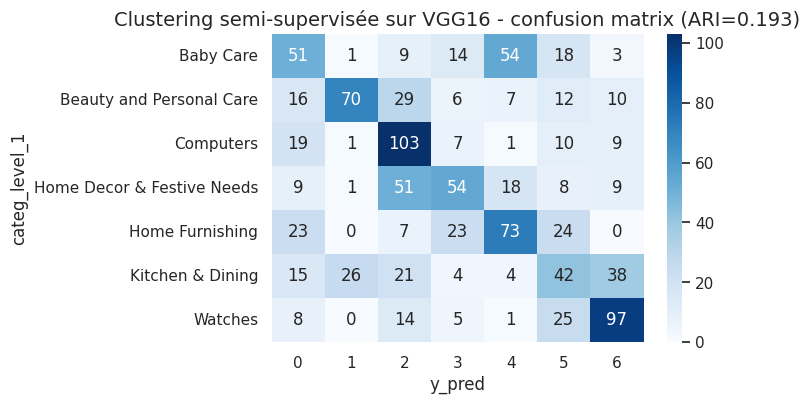

In [ ]:
labels_vgg_transform=conf_matr_relabel(y_cat_txt,labels_vgg)
ari_vgg=plot_classification_metrics(y_cat_txt,labels_vgg_transform)
plt.title(f'Clustering semi-supervisée sur VGG16 - confusion matrix (ARI={ari_vgg:.3f})', fontsize=14)
to_png()


In [ ]:
df_resultats=add_model_score(model_name='VGG16',ARI=ari_vgg, k=len(set(labels_vgg)))

categ_level_1 clusters
(49, 3)
Index(['categ_level_1', 'variable', 'value'], dtype='object')


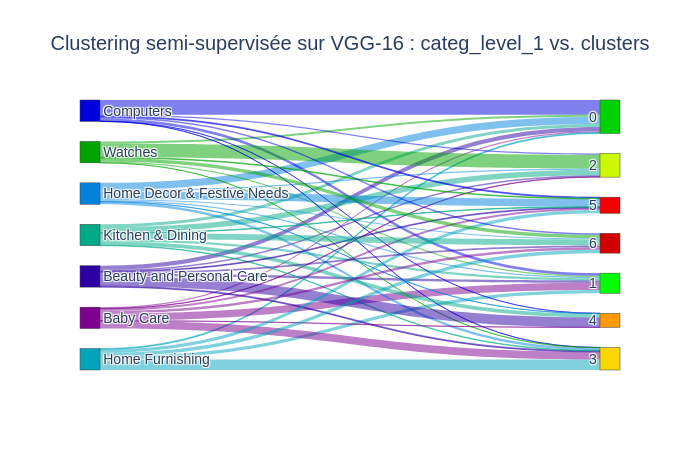

In [ ]:
plot_sankey_confusion_diagram(y_cat_txt,labels_vgg, titre="Clustering semi-supervisée sur VGG-16")

In [ ]:
def fit_clusters(df, features, k=7, label_col='cluster_id'):
    """Fit K clusters to features, returning labels in """
    cls = cluster.KMeans(n_clusters=k)
    cls.fit(features)
    df = df.copy()
    df[label_col] = cls.labels_
    return df


df_clusters = fit_clusters(features=X_tsne, df=df_image_labels)
df_clusters.head()


,image,categ_level_1,file,cluster_id
0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,Home Furnishing,data/raw/Flipkart/Images/55b85ea15a1536d46b7190ad6fff8ce7.jpg,2
1,7b72c92c2f6c40268628ec5f14c6d590.jpg,Baby Care,data/raw/Flipkart/Images/7b72c92c2f6c40268628ec5f14c6d590.jpg,0
2,64d5d4a258243731dc7bbb1eef49ad74.jpg,Baby Care,data/raw/Flipkart/Images/64d5d4a258243731dc7bbb1eef49ad74.jpg,2
3,d4684dcdc759dd9cdf41504698d737d8.jpg,Home Furnishing,data/raw/Flipkart/Images/d4684dcdc759dd9cdf41504698d737d8.jpg,0
4,6325b6870c54cd47be6ebfbffa620ec7.jpg,Home Furnishing,data/raw/Flipkart/Images/6325b6870c54cd47be6ebfbffa620ec7.jpg,5


Clipping cluster size from 155 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[0].png"


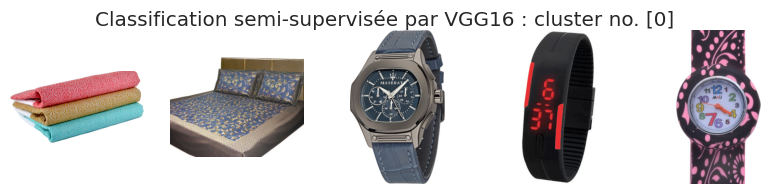

Clipping cluster size from 116 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[1].png"


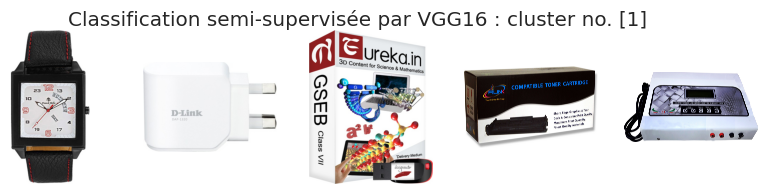

Clipping cluster size from 145 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[2].png"


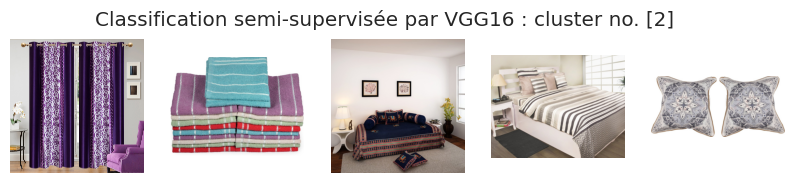

Clipping cluster size from 98 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[3].png"


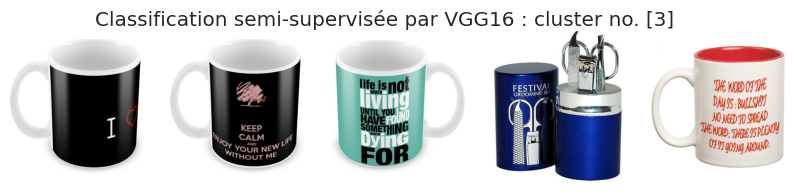

Clipping cluster size from 161 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[4].png"


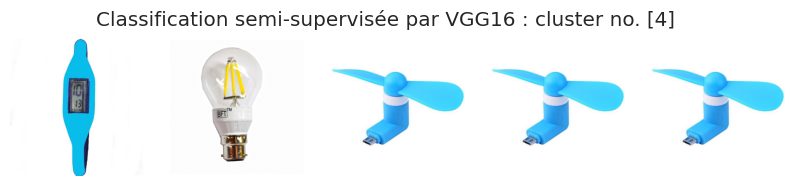

Clipping cluster size from 204 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[5].png"


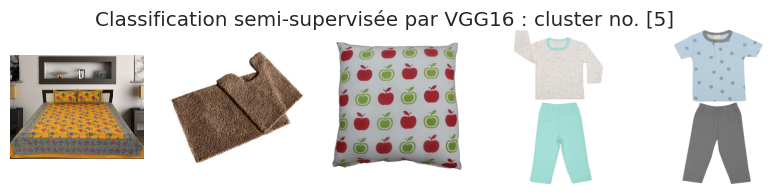

Clipping cluster size from 171 to 5
"Classification_semi-supervisée_par_VGG16_-_cluster_no-_[6].png"


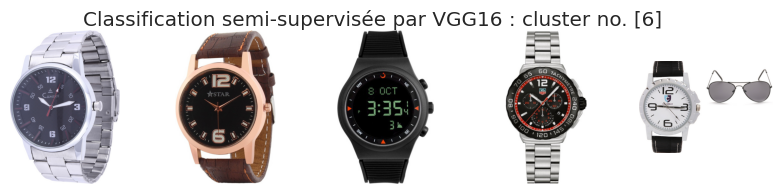

In [ ]:

def view_cluster(df: pd.DataFrame, cluster_id=0, nb=5, cluster_col='cluster_id'):
    """function that lets you view a cluster (based on identifier)"""
    nb=min(nb,10)
    n_cols = min(5,nb)
    n_rows = nb // n_cols + (nb % n_cols > 0)
    fig = plt.figure(figsize=(n_cols*2, n_rows+1))
    # gets the list of filenames for a cluster
    mask = df[cluster_col] == cluster_id
    files = list(df[mask]['file'])

    # only allow up to 30 images to be shown at a time
    if len(files) > nb:
        print(f"Clipping cluster size from {len(files)} to {nb}")
        files = files[:nb]
    # plot each image in the cluster
    for n, file in enumerate(files):
        _ = plt.subplot(n_rows, n_cols, n + 1)
        img = tf.keras.preprocessing.image.load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')


for i in range(7):
    view_cluster(df_clusters, cluster_id=i)
    plt.suptitle(
        f'Classification semi-supervisée par VGG16 : cluster no. [{i}]')
    to_png()
    plt.show()


In [ ]:
# Clean up
del model
tf.keras.backend.clear_session()


## 6.3 Unsupervised clustering without the first 2 layers of VGG16The last layers of VGG16 direct the images to the ImageNet classesWe can check whether we can improve the classification result by removing layers

In [ ]:

# load model
model = tf.keras.applications.vgg16.VGG16()
# remove the output layer and last dense layer
model = tf.keras.models.Model(inputs=model.inputs, outputs=model.layers[-2].output)


In [ ]:
# feat will be a matrix of shape [1050, 4096]
feat, filenames = extract_all_features(filelist, model, nb=1050)


Starting feature extraction for 1050 images...


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning:

The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor']
Received: inputs=Tensor(shape=(1, 224, 224, 3))



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 745ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 572ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 998ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 590ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 874ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step   
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 588ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 606ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 570ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 586ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 582ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 630ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:3402: DecompressionBombWarning:

Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 708ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 791ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 587ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 562ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 568ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 564ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 571ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 581ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 591ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 561ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 649ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 656ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 580ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
1

In [ ]:
save_pickle(feat, 'features_vgg16_2', OUT_FOLDER)


In [ ]:
# Reduction de dimensions
feat_pca = reducer_pca(feat)
categories = y_cat_txt.unique()
k = len(categories)

# reduction en 2 dimensions tsne, cluster par KMeans, calcul de similarité
ARI_vgg2, X_tsne, labels_vgg2 = calc_tsne_cluster(
    feat_pca, categories, y_cat_num, k)


Dimensions avant réduction PCA : (1050, 4096)
Dimensions après réduction PCA (99 % variance explained) : (1050, 303)
t-SNE done! Time elapsed: 16.0 seconds
Clustering par KMeans, ARI = 0.327


k=4, fit: 0.01 s, silhouette= 0.43, ARI = 0.225, cluster sizes = [28 26 25 19]
k=5, fit: 0.0 s, silhouette= 0.435, ARI = 0.303, cluster sizes = [22 21 19 19 17]
k=6, fit: 0.01 s, silhouette= 0.441, ARI = 0.314, cluster sizes = [20 19 16 14 14 13]
k=7, fit: 0.01 s, silhouette= 0.405, ARI = 0.307, cluster sizes = [16 15 15 15 14 11 10]
k=8, fit: 0.01 s, silhouette= 0.429, ARI = 0.328, cluster sizes = [16 14 12 12 12 10 10  9]
k=9, fit: 0.01 s, silhouette= 0.408, ARI = 0.333, cluster sizes = [14 13 11 11 11 10 10  8  8]
k=10, fit: 0.01 s, silhouette= 0.397, ARI = 0.325, cluster sizes = [13 11 11 10 10 10 10  8  7  6]
k=11, fit: 0.01 s, silhouette= 0.413, ARI = 0.357, cluster sizes = [12 11 11 10  8  7  7  7  7  7  7]
k=12, fit: 0.01 s, silhouette= 0.407, ARI = 0.339, cluster sizes = [11 11 11  9  8  7  7  7  7  6  6  6]
k=13, fit: 0.01 s, silhouette= 0.416, ARI = 0.341, cluster sizes = [11 10  9  8  8  8  8  6  6  6  5  5  4]
k=14, fit: 0.01 s, silhouette= 0.406, ARI = 0.31, cluster sizes

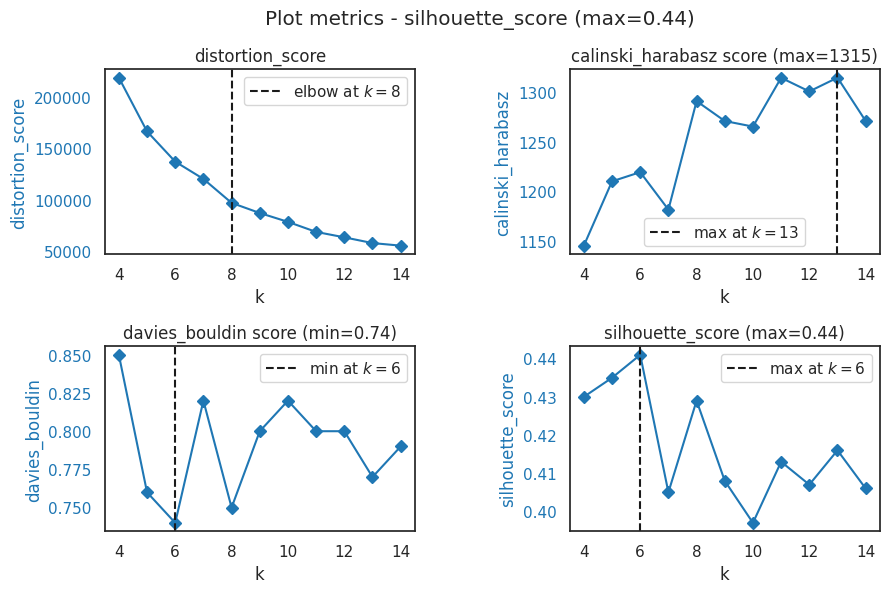

In [ ]:
search_params = {'n_clusters': range(4, 15)}
scores_vgg2, labels_vgg2 = score_kmeans(
    X_tsne, param_grid=search_params, labels_true=df_data['categ_level_1'])
plot_metrics(scores_vgg2)


ARI :  0.3274
"Clustering_non-supervisée_sur_VGG-16_moins_2_couches,_feature_reduction-_PCA_+_TSNE_(ARI_=_0-327).png"


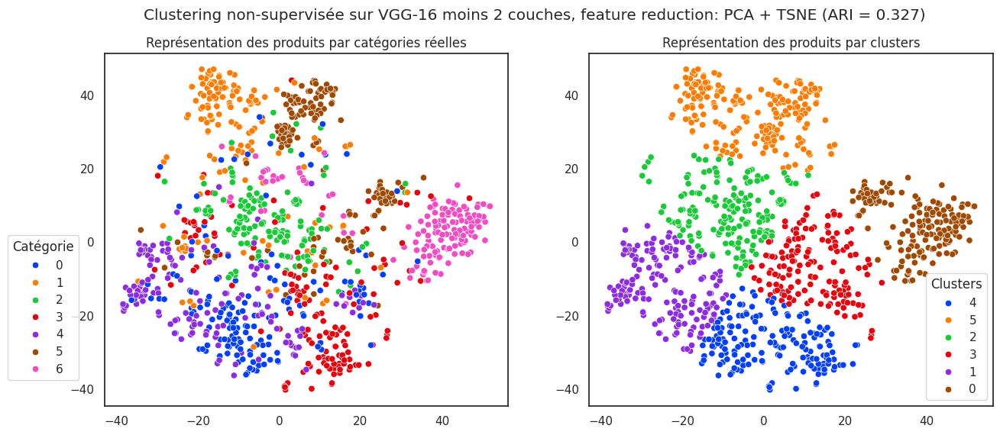

In [ ]:
plot_clusters_sur_2D(X_tsne, y_cat_num, labels_vgg2, ARI_vgg2)
plt.suptitle(
    f'Clustering non-supervisée sur VGG-16 moins 2 couches, feature reduction: PCA + TSNE (ARI = {ARI_vgg2:.3f})')
to_png()


"Produits_sur_TSNE_pour_clusters_des_features_VGG-16_(moins_2_couches).png"


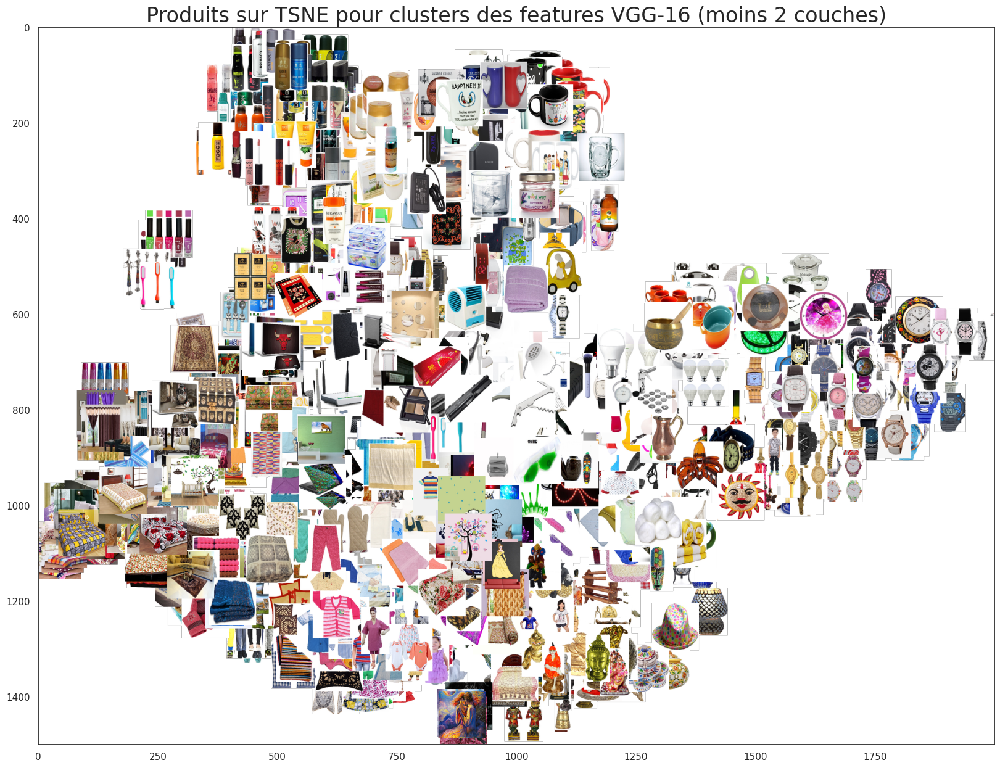

In [ ]:
plot_scatter_with_images(X_tsne, df_data['image'])
plt.title(
    'Produits sur TSNE pour clusters des features VGG-16 (moins 2 couches)', fontsize=24)
to_png()


### Evaluation metrics

ARI = 0.286
                            precision    recall  f1-score   support

                 Baby Care       0.01      0.01      0.01       150
  Beauty and Personal Care       0.08      0.09      0.09       150
                 Computers       0.52      0.62      0.56       150
Home Decor & Festive Needs       0.25      0.27      0.26       150
           Home Furnishing       0.19      0.21      0.20       150
          Kitchen & Dining       0.40      0.55      0.46       150
                   Watches       0.00      0.00      0.00       150

                  accuracy                           0.25      1050
                 macro avg       0.21      0.25      0.23      1050
              weighted avg       0.21      0.25      0.23      1050

"Clustering_semi-supervisée_sur_VGG16_-_confusion_matrix_(ARI=0-286).png"


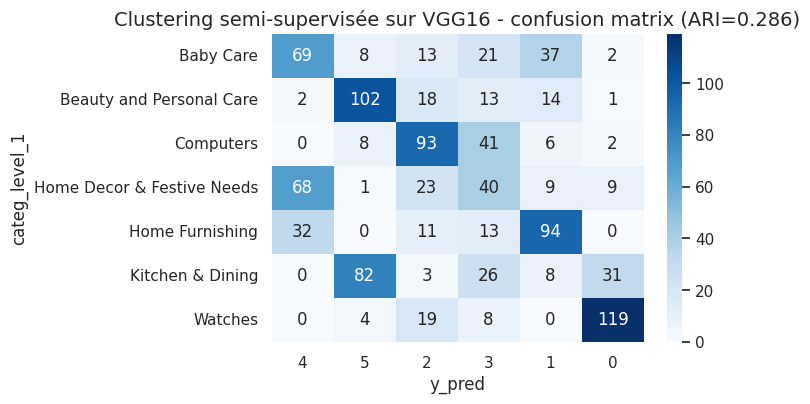

In [ ]:
ari_vgg2=plot_classification_metrics(y_cat_txt,labels_vgg2)
plt.title(f'Clustering semi-supervisée sur VGG16 - confusion matrix (ARI={ari_vgg2:.3f})', fontsize=14)
to_png()
df_resultats=add_model_score(model_name='VGG16_moins2',ARI=ari_vgg2, k=len(set(labels_vgg2)))

By removing the last layers, we improved the model.

In [ ]:
# Cleanup
# import tensorflow as tf
del model
tf.keras.backend.clear_session()


#7. Transfer Learning with pre-trained VGG16The previous section shows that the pre-trained VGG16 model is able to classify images quite well (ARI score = 0.384)We can train this model with our own images to improve the score:- Strategy #1: total fine-tuning- Strategy #2: feature extraction- Strategy #3: partial fine-tuning### References- https://keras.io/guides/transfer_learning/- https://keras.io/api/applications/#usage-examples-for-image-classification-models- https://machinelearningmastery.com/how-to-use-transfer-learning-when-developing-convolutional-neural-network-models/

## 7.1 Regularization with random data augmentation- https://keras.io/guides/transfer_learning/When you don't have a large image dataset, it's a good practice to artificially introduce sample diversity by applying random yet realistic transformations to the training images, such as random horizontal flipping or small random rotations. This helps expose the model to different aspects of the training data while slowing down overfitting.

In [ ]:
data_augmentation = tf.keras.Sequential(
    [tf.keras.layers.RandomFlip("horizontal"), tf.keras.layers.RandomRotation(0.1), ]
)


image_processing_time : 0.0 s
"Data_augmentation.png"


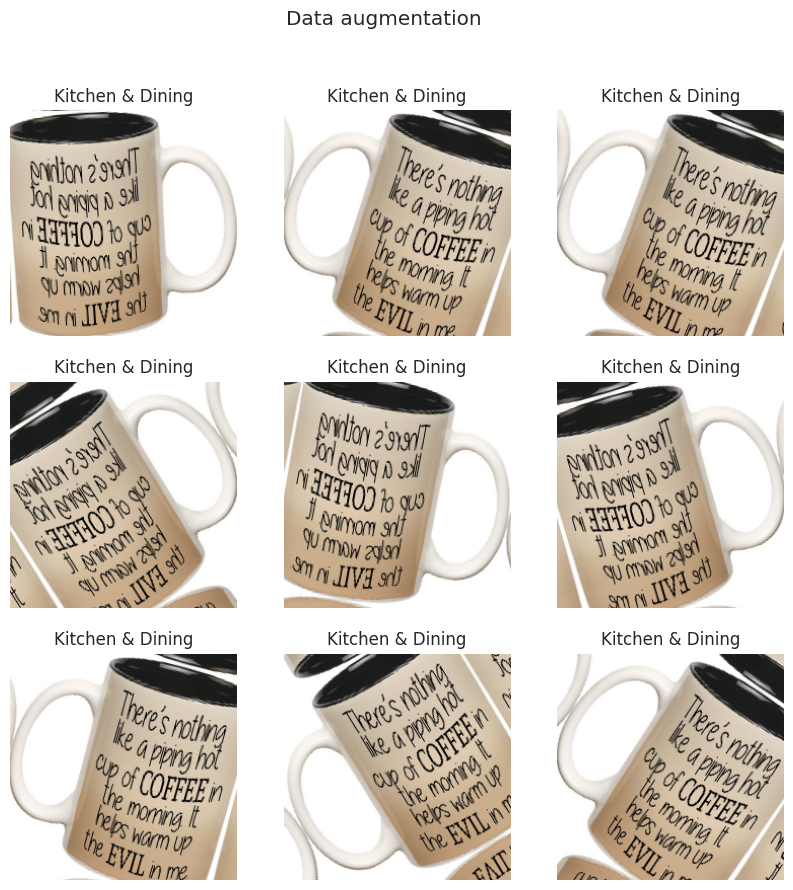

In [ ]:
import numpy as np
row = 143
image_data = load_image_data(
    df_data.loc[row:row+5, :], preprocess_params=PREPROCESS_PARAMS)
images, labels, z = split_image_data(image_data)
# images = preprocess_input_tf(images)

# for images, labels in train_ds.take(1):
plt.figure(figsize=(10, 10))
first_image = images[0]
for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    augmented_image = data_augmentation(
        tf.expand_dims(first_image, 0), training=True
    )
    plt.imshow(augmented_image[0].numpy().astype("int32"))
    plt.title(labels[0])
    plt.axis("off")

plt.suptitle('Data augmentation')
to_png()


## 7.2 Creation of the model for transfer learning (with preprocessing and data augmentation)

In [ ]:
# import tensorflow as tf
# from tensorflow.keras.applications.vgg16 import VGG16, preprocess_input
# from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Dropout
# from tensorflow.keras import Model

tf.keras.backend.clear_session()


def create_vgg16_transfer_model(nb_clusters=7, input_shape=(224, 224, 3)):
    """Créer un model vgg16 pré-entraîné sur ImageNet, prêt pour transfer learning"""
    # Charger VGG-16 pré-entraîné sur ImageNet et sans les couches fully-connected
    # Load weights pre-trained on ImageNet.
    # Do not include the ImageNet classifier at the top.
    base_model = tf.keras.applications.vgg16.VGG16(weights="imagenet",
    include_top=False,input_shape=input_shape)

    # freeze the base model (stops us from setting any individual layer as trainable)
    base_model.trainable = False

    # Create new model on top
    inputs = tf.keras.Input(input_shape)

    x = data_augmentation(inputs)  # Apply random data augmentation

    # Pre-trained VGG16 weights requires that input be scaled
    # from (0, 255) to a range of (0., +1.), the rescaling layer
    # outputs: `(inputs * scale) + offset`
    # equivalent to preprocess_input_tf(X)
    # or tf.keras.applications.vgg16.preprocess_input(X)
    scale_layer = tf.keras.layers.Rescaling(scale=1 / 255, offset=0)
    x = scale_layer(x)

    # The base model contains batchnorm layers.
    # We want to keep them in inference mode
    # when we unfreeze the base model for fine-tuning, so
    # we make sure that the base_model is running in inference mode here.

    # ---- training=False VERY IMPORTANT FOR FINE TUNING !!! ---
    x = base_model(x, training=False)

    x = tf.keras.layers.GlobalAveragePooling2D()(x)
    x = tf.keras.layers.Dropout(0.2)(x)  # Regularize with dropout

    # Add a fully connected layer to improve performance
    x = tf.keras.layers.Dense(512, activation='relu')(x)
    outputs = tf.keras.layers.Dense(nb_clusters, activation='softmax')(x)
    model = tf.keras.Model(inputs, outputs)

    return model


model_vgg16 = create_vgg16_transfer_model(nb_clusters=7)

model_vgg16.summary(show_trainable=True)


58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer_1 (InputLayer)  │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ sequential (Sequential)     │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ rescaling (Rescaling)       │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ vgg16 (Functional)          │ (None, 7, 7, 512)     │ 14,714,688 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 512)           │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 512)           │    262,656 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 7)             │      3,591 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 14,980,935 (57.15 MB)

 Trainable params: 266,247 (1.02 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

### Access to the base modelThe layers of the base model **vgg16** are not displayed here.To access the base model, we create a function that finds it

In [ ]:
def get_inner_model(model_, inner_model_name='vgg16'):
    inner_model = None
    for i, layer in enumerate(model_.layers):
        # print(f'layer [{i}] {layer.name}: {type(layer)}')
        if layer.name == inner_model_name:
            inner_model = model_.layers[i]
    return inner_model


def get_base_model(model, base_model_name='vgg16'):
    return get_inner_model(model, base_model_name)


base_model = get_base_model(model_vgg16)
base_model.summary(show_trainable=True)


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer (InputLayer)    │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_conv1 (Conv2D)       │ (None, 224, 224, 64)  │      1,792 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_conv2 (Conv2D)       │ (None, 224, 224, 64)  │     36,928 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_pool (MaxPooling2D)  │ (None, 112, 112, 64)  │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_conv1 (Conv2D)       │ (None, 112, 112, 128) │     73,856 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_conv2 (Conv2D)       │ (None, 112, 112, 128) │    147,584 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_pool (MaxPooling2D)  │ (None, 56, 56, 128)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv1 (Conv2D)       │ (None, 56, 56, 256)   │    295,168 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv2 (Conv2D)       │ (None, 56, 56, 256)   │    590,080 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv3 (Conv2D)       │ (None, 56, 56, 256)   │    590,080 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_pool (MaxPooling2D)  │ (None, 28, 28, 256)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv1 (Conv2D)       │ (None, 28, 28, 512)   │  1,180,160 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv2 (Conv2D)       │ (None, 28, 28, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv3 (Conv2D)       │ (None, 28, 28, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_pool (MaxPooling2D)  │ (None, 14, 14, 512)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv1 (Conv2D)       │ (None, 14, 14, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv2 (Conv2D)       │ (None, 14, 14, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv3 (Conv2D)       │ (None, 14, 14, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_pool (MaxPooling2D)  │ (None, 7, 7, 512)     │          0 │   -   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 14,714,688 (56.13 MB)

## 7.3 Transfer Learning - Stratégie #1 : Fine tuning totalThe last fully-connected layer of the pre-trained network is replaced by a classifier adapted to the new problem (SVM, logistic regression, etc.) and initialized randomly. All layers are then trained on the new images.This strategy should be used when the new image collection is large: in this case, one can afford to train the entire network without running the risk of overfitting.Moreover, since the parameters of all layers (except the last one) are initially those of the pre-trained network, the learning phase will be done more quickly than if the initialization had been random.

In [ ]:
# Unfreeze base model (otherwise cannot set individual layers as trainable)
base_model.trainable = True
# OK, can now choose which layers are trainable
for layer in base_model.layers:
    layer.trainable = True


# If desired, we can fine-tune layers which are trainable
# for layer in base_model.layers[:5]:
#     layer.trainable = False
model_vgg16.summary(show_trainable=True)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer_1 (InputLayer)  │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ sequential (Sequential)     │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ rescaling (Rescaling)       │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ vgg16 (Functional)          │ (None, 7, 7, 512)     │ 14,714,688 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 512)           │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 512)           │    262,656 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 7)             │      3,591 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 14,980,935 (57.15 MB)

 Trainable params: 14,980,935 (57.15 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
# import tensorflow as tf
nb_epochs = 1
batch_size = 16

# Compiler le modèle
model_vgg16.compile(
    optimizer='adam', loss="categorical_crossentropy", metrics=["accuracy"])

# Entraîner sur les données d'entraînement (X_train, y_train)
# model_info = new_model.fit(x_train, y_train, epochs=nb_epochs, batch_size=batch_size, verbose=2,validation_data=(x_val, y_val))


After 13 minutes (1 epoch):42/42 - 770s - loss: 2.0661 - accuracy: 0.1324 - val_loss: 1.9572 - val_accuracy: 0.1012 - 770s/epoch - 18s/step

This model has already been trained on a large amount of similar images.As our image collection is not large, we do not expect a big improvement in 'accuracy'.

## 7.4 Transfer Learning - Strategy #2: Feature ExtractionWe only train the new classifier and do not retrain the other layers.If we tried strategy 1, we must reload the Imagenet weights

In [ ]:
# nettoyer les anciens models du memoire
del model_vgg16
del base_model
tf.keras.backend.clear_session()


In [ ]:
model_vgg16 = create_vgg16_transfer_model(
    nb_clusters=7, input_shape=(224, 224, 3))

model_vgg16.compile(
    optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
model_vgg16.summary(show_trainable=True)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer_1 (InputLayer)  │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ sequential (Sequential)     │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ rescaling (Rescaling)       │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ vgg16 (Functional)          │ (None, 7, 7, 512)     │ 14,714,688 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 512)           │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 512)           │    262,656 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 7)             │      3,591 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 14,980,935 (57.15 MB)

 Trainable params: 266,247 (1.02 MB)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
base_model = get_base_model(model_vgg16)
# base_model.summary(show_trainable=True)


In [ ]:
# https://www.tensorflow.org/tutorials/keras/save_and_load

checkpoint_path = "saved_models/training_1.keras"  # Add the .keras extension
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 #  save_weights_only=True,
                                                 monitor='val_accuracy', mode='max',
                                                 #   save_freq=5*batch_size,
                                                 save_best_only=True,
                                                 verbose=1)
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', mode='min', verbose=1, patience=3)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.2, patience=2, min_lr=0.001)
callbacks = [early_stopping, reduce_lr, cp_callback]

In [ ]:
# from sklearn import preprocessing
PREPROCESS_PARAMS = None
MODEL_PARAMS = dict(loss='categorical_crossentropy')
image_data = load_image_data(df_data, preprocess_params=PREPROCESS_PARAMS)
X, y, z = split_image_data(image_data)
# have added a scaling layer, so no need to preprocess
# X = preprocess_input_tf(X)
le = preprocessing.LabelEncoder()
encoded_labels = le.fit_transform(list(pd.Series(y).unique()))
# print(le.classes_)
Y = labels_to_categorical(y, le)
x_train, x_val, y_train, y_val, z_train, z_val = train_test_split(
    X, Y, z, train_size=0.2, random_state=RANDOM_SEED)


image_processing_time : 27.7 s


In [ ]:
# model_vgg16.save('saved_models/trained_2')


#### Output of model.fit :<pre style="font-size:0.5em">image_processing_time : 11.3 sEpoch 1/107/7 [==============================] - ETA: 0s - loss: 1.7583 - accuracy: 0.3333Epoch 1: val_accuracy improved from -inf to 0.38095, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 330s 54s/step - loss: 1.7583 - accuracy: 0.3333 - val_loss: 1.5381 - val_accuracy: 0.3810 - lr: 0.0010Epoch 2/107/7 [==============================] - ETA: 0s - loss: 1.2645 - accuracy: 0.6619Epoch 2: val_accuracy improved from 0.38095 to 0.71905, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 323s 52s/step - loss: 1.2645 - accuracy: 0.6619 - val_loss: 1.1780 - val_accuracy: 0.7190 - lr: 0.0010Epoch 3/107/7 [==============================] - ETA: 0s - loss: 0.9224 - accuracy: 0.8048Epoch 3: val_accuracy improved from 0.71905 to 0.72262, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 326s 52s/step - loss: 0.9224 - accuracy: 0.8048 - val_loss: 1.0012 - val_accuracy: 0.7226 - lr: 0.0010Epoch 4/107/7 [==============================] - ETA: 0s - loss: 0.7057 - accuracy: 0.8286Epoch 4: val_accuracy improved from 0.72262 to 0.74405, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 316s 51s/step - loss: 0.7057 - accuracy: 0.8286 - val_loss: 0.8967 - val_accuracy: 0.7440 - lr: 0.0010Epoch 5/107/7 [==============================] - ETA: 0s - loss: 0.5803 - accuracy: 0.8762Epoch 5: val_accuracy improved from 0.74405 to 0.75595, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 300s 48s/step - loss: 0.5803 - accuracy: 0.8762 - val_loss: 0.8351 - val_accuracy: 0.7560 - lr: 0.0010Epoch 6/107/7 [==============================] - ETA: 0s - loss: 0.5099 - accuracy: 0.8429Epoch 6: val_accuracy improved from 0.75595 to 0.75952, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 311s 50s/step - loss: 0.5099 - accuracy: 0.8429 - val_loss: 0.8034 - val_accuracy: 0.7595 - lr: 0.0010Epoch 7/107/7 [==============================] - ETA: 0s - loss: 0.4174 - accuracy: 0.8905Epoch 7: val_accuracy did not improve from 0.759527/7 [==============================] - 326s 52s/step - loss: 0.4174 - accuracy: 0.8905 - val_loss: 0.7993 - val_accuracy: 0.7500 - lr: 0.0010Epoch 8/107/7 [==============================] - ETA: 0s - loss: 0.3763 - accuracy: 0.9238Epoch 8: val_accuracy did not improve from 0.759527/7 [==============================] - 309s 50s/step - loss: 0.3763 - accuracy: 0.9238 - val_loss: 0.7873 - val_accuracy: 0.7595 - lr: 0.0010Epoch 9/107/7 [==============================] - ETA: 0s - loss: 0.3268 - accuracy: 0.9286Epoch 9: val_accuracy improved from 0.75952 to 0.77024, saving model to saved_models\model_vgg16INFO:tensorflow:Assets written to: saved_models\model_vgg16\assets7/7 [==============================] - 307s 50s/step - loss: 0.3268 - accuracy: 0.9286 - val_loss: 0.7703 - val_accuracy: 0.7702 - lr: 0.0010Epoch 10/107/7 [==============================] - ETA: 0s - loss: 0.2874 - accuracy: 0.9238Epoch 10: val_accuracy did not improve from 0.770247/7 [==============================] - 331s 53s/step - loss: 0.2874 - accuracy: 0.9238 - val_loss: 0.7680 - val_accuracy: 0.7536 - lr: 0.0010</pre>

After 10 epochs the model has an accuracy of 92% for the training images, but only 77% for the validation images.

In [ ]:
predict_image(FILES[3], model=model_vgg16)
print(le.inverse_transform([4]))


1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
[[0.24324869 0.15912431 0.11997025 0.16583359 0.09863366 0.0685724
  0.14461702]]
['Home Furnishing']


### Predict images validation

In [ ]:
val_pred = model_vgg16.predict(x_val)
val_true = y_val
print(val_pred.shape, val_true.shape)


27/27 ━━━━━━━━━━━━━━━━━━━━ 716s 26s/step
(840, 7) (840, 7)


In [ ]:
df_results = cnn_results(z_val, val_true, val_pred, label_encoder=le)
df_results.head()


,filename,label_true,label_pred,prob_pred,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
0,833a87b0af3b84fe246d2ebf271af177.jpg,Computers,Baby Care,23.62,23.62,17.50,17.68,10.93,7.91,8.30,14.06
1,55195de3873fffaa9e37b041533d7305.jpg,Kitchen & Dining,Baby Care,24.33,24.33,14.20,12.76,12.01,8.36,10.09,18.25
2,44b963eb856b4831dfdd21b666593c95.jpg,Computers,Computers,20.28,18.07,17.41,20.28,15.29,9.84,6.44,12.66
3,98ad5b99ad96695568d8f143b11ab740.jpg,Beauty and Personal Care,Beauty and Personal Care,40.23,12.70,40.23,10.48,10.15,9.89,6.16,10.38
4,29b1ca231e10d5269516b80bf9d0dffc.jpg,Watches,Watches,27.13,15.55,13.70,7.27,25.27,4.86,6.21,27.13


In [ ]:
calc_ARI(df_results['label_true'], df_results['label_pred'])


np.float64(0.1646)

In [ ]:
y_true = df_results['label_true']
y_pred = df_results['label_pred']


In [ ]:
# https://www.tensorflow.org/tutorials/keras/save_and_load

checkpoint_path = "saved_models/training_1.keras"  # Add the .keras extension
checkpoint_dir = os.path.dirname(checkpoint_path)

# Create a callback that saves the model's weights
cp_callback = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                                                 #  save_weights_only=True,
                                                 monitor='val_accuracy', mode='max',
                                                 #   save_freq=5*batch_size,
                                                 save_best_only=True,
                                                 verbose=1)
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', mode='min', verbose=1, patience=3)
reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
    monitor='val_loss', factor=0.2, patience=2, min_lr=0.001)
callbacks = [early_stopping, reduce_lr, cp_callback]

## 7.5 Transfer Learning - Strategy #3: Partial Fine-tuningWe train the new classifier and the upper layersIf we have loaded a model that has already been trained, we must put a pointer back to the base_model

In [ ]:
base_model = None
for i, layer in enumerate(model_vgg16.layers):
    print(f'layer [{i}] {layer.name}: {type(layer)}')
    if layer.name == 'vgg16':
        base_model = model_vgg16.layers[i]

base_model.summary(show_trainable=True)


layer [0] input_layer_1: <class 'keras.src.layers.core.input_layer.InputLayer'>
layer [1] sequential: <class 'keras.src.models.sequential.Sequential'>
layer [2] rescaling: <class 'keras.src.layers.preprocessing.rescaling.Rescaling'>
layer [3] vgg16: <class 'keras.src.models.functional.Functional'>
layer [4] global_average_pooling2d: <class 'keras.src.layers.pooling.global_average_pooling2d.GlobalAveragePooling2D'>
layer [5] dropout: <class 'keras.src.layers.regularization.dropout.Dropout'>
layer [6] dense: <class 'keras.src.layers.core.dense.Dense'>
layer [7] dense_1: <class 'keras.src.layers.core.dense.Dense'>


Model: "vgg16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer (InputLayer)    │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_conv1 (Conv2D)       │ (None, 224, 224, 64)  │      1,792 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_conv2 (Conv2D)       │ (None, 224, 224, 64)  │     36,928 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block1_pool (MaxPooling2D)  │ (None, 112, 112, 64)  │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_conv1 (Conv2D)       │ (None, 112, 112, 128) │     73,856 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_conv2 (Conv2D)       │ (None, 112, 112, 128) │    147,584 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block2_pool (MaxPooling2D)  │ (None, 56, 56, 128)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv1 (Conv2D)       │ (None, 56, 56, 256)   │    295,168 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv2 (Conv2D)       │ (None, 56, 56, 256)   │    590,080 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_conv3 (Conv2D)       │ (None, 56, 56, 256)   │    590,080 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block3_pool (MaxPooling2D)  │ (None, 28, 28, 256)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv1 (Conv2D)       │ (None, 28, 28, 512)   │  1,180,160 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv2 (Conv2D)       │ (None, 28, 28, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_conv3 (Conv2D)       │ (None, 28, 28, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block4_pool (MaxPooling2D)  │ (None, 14, 14, 512)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv1 (Conv2D)       │ (None, 14, 14, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv2 (Conv2D)       │ (None, 14, 14, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_conv3 (Conv2D)       │ (None, 14, 14, 512)   │  2,359,808 │   N   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ block5_pool (MaxPooling2D)  │ (None, 7, 7, 512)     │          0 │   -   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 14,714,688 (56.13 MB)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 14,714,688 (56.13 MB)

In [ ]:
# Must unfreeze base_model, otherwise we cannot modify trainable of its layers
base_model.trainable = True
# lock first layers
# for layer in base_model.layers[:-3]:
#     layer.trainable = False

# # Unlock last 3 layers
# for layer in base_model.layers[-3:]:
#     layer.trainable = True

model_vgg16.summary(show_trainable=True)


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━┓
┃ Layer (type)                ┃ Output Shape          ┃    Param # ┃ Trai… ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━┩
│ input_layer_1 (InputLayer)  │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ sequential (Sequential)     │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ rescaling (Rescaling)       │ (None, 224, 224, 3)   │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ vgg16 (Functional)          │ (None, 7, 7, 512)     │ 14,714,688 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ global_average_pooling2d    │ (None, 512)           │          0 │   -   │
│ (GlobalAveragePooling2D)    │                       │            │       │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dropout (Dropout)           │ (None, 512)           │          0 │   -   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense (Dense)               │ (None, 512)           │    262,656 │   Y   │
├─────────────────────────────┼───────────────────────┼────────────┼───────┤
│ dense_1 (Dense)             │ (None, 7)             │      3,591 │   Y   │
└─────────────────────────────┴───────────────────────┴────────────┴───────┘

 Total params: 15,513,431 (59.18 MB)

 Trainable params: 14,980,935 (57.15 MB)

 Non-trainable params: 0 (0.00 B)

 Optimizer params: 532,496 (2.03 MB)

We will save the model in another location to be able to retrieve the extracted model with the ImageNet weights if we need to restart the fine tuning

In [ ]:
# https://www.tensorflow.org/tutorials/keras/save_and_load
fine_checkpoint_path = 'saved_models/model_vgg16_fine'
fine_checkpoint_dir = os.path.dirname(checkpoint_path)

fine_checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath=checkpoint_path,
                               monitor='val_accuracy', mode='max',
                               verbose=1, save_best_only=True)
early_stopping = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss', mode='min', verbose=1, patience=3)
# reduce_lr = ReduceLROnPlateau(
#     monitor='val_loss', factor=0.2, patience=2, min_lr=0.001)
fine_callbacks = [early_stopping, fine_checkpointer]


In [ ]:
# Suivant les instructions sur https://www.tensorflow.org/guide/keras/transfer_learning

# Unfreeze the base model
base_model.trainable = True

# It's important to recompile your model after you make any changes
# to the `trainable` attribute of any inner layer, so that your changes
# are take into account
model_vgg16.compile(optimizer=tf.keras.optimizers.Adam(1e-5),  # Very low learning rate
                    loss='categorical_crossentropy',
                    metrics=['accuracy'])

# delete model or comment following line to run model
MODEL_FINE_TUNED = os.path.exists(fine_checkpoint_path)
print(f'model is tuned = {MODEL_FINE_TUNED}')
if not MODEL_FINE_TUNED:
    # Train end-to-end. Be careful to stop before you overfit!
    model_info = model_vgg16.fit(x_train, y_train, batch_size=32,
                               epochs=10, verbose=1, validation_data=(x_val, y_val),
                               callbacks=[early_stopping, fine_checkpointer])
    MODEL_FINE_TUNED = os.path.exists(fine_checkpoint_path)
else:
    # model already run - load model with state of optimizer, nb epochs etc
    # could just save weights, but will loose the state of optimizer and callbacks
    model_info = None
    del model_vgg16
    del base_model
    tf.keras.backend.clear_session()
    model_vgg16 = tf.keras.models.load_model(fine_checkpoint_path)
    print('loading previously fine_tuned model')
    model_vgg16.summary(show_trainable=True)



model is tuned = True
loading previously fine_tuned model
Model: "model"
____________________________________________________________________________
 Layer (type)                Output Shape              Param #   Trainable  
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         Y          
                                                                            
 sequential (Sequential)     (None, 224, 224, 3)       0         Y          
                                                                            
 rescaling (Rescaling)       (None, 224, 224, 3)       0         Y          
                                                                            
 vgg16 (Functional)          (None, 7, 7, 512)         14714688  Y          
                                                                            
 global_average_pooling2d (G  (None, 512)              0         Y          
 lobalAveragePooling2D)                                                     
   

In [ ]:
# model_vgg16.save('saved_models/tuned_3')
if model_info is None:
    class model_info: # noqa
        pass
    model_info.history = dict(
        loss=[1.7583, 1.2645, 0.9224, 0.7057, 0.5803,
              0.5099, 0.4174, 0.3763, 0.3268, 0.2874],
        accuracy=[0.3333, 0.6619, 0.8048, 0.8286, 0.8762,
                  0.8429, 0.8905, 0.9238, 0.9286, 0.9238],
        val_loss=[1.5381, 1.178, 1.0012, 0.8967, 0.8351,
                  0.8034, 0.7993, 0.7873, 0.7703, 0.768],
        val_accuracy=[0.381, 0.719, 0.7226, 0.744, 0.756,
                      0.7595, 0.75, 0.7595, 0.7702, 0.7536],
    )

print(model_info.history)


{'loss': [1.7583, 1.2645, 0.9224, 0.7057, 0.5803, 0.5099, 0.4174, 0.3763, 0.3268, 0.2874], 'accuracy': [0.3333, 0.6619, 0.8048, 0.8286, 0.8762, 0.8429, 0.8905, 0.9238, 0.9286, 0.9238], 'val_loss': [1.5381, 1.178, 1.0012, 0.8967, 0.8351, 0.8034, 0.7993, 0.7873, 0.7703, 0.768], 'val_accuracy': [0.381, 0.719, 0.7226, 0.744, 0.756, 0.7595, 0.75, 0.7595, 0.7702, 0.7536]}


"transfer-learning_#3_-_Fine_tuning.png"


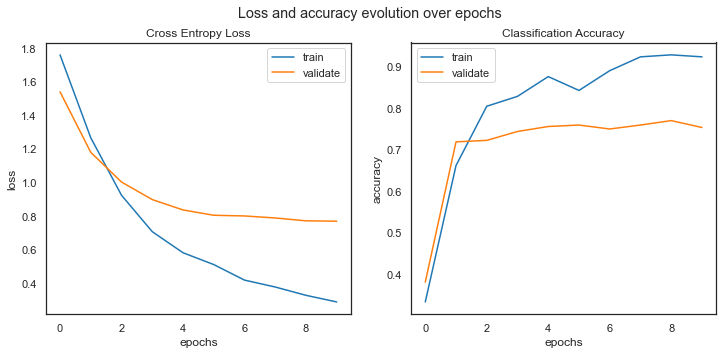

In [ ]:
plot_diagnostic_learning_curves(model_info)
to_png('transfer-learning #3 - Fine tuning')


In [ ]:
val_pred = model_vgg16.predict(x_val)
val_true = y_val
print(val_pred.shape, val_true.shape)


27/27 ━━━━━━━━━━━━━━━━━━━━ 690s 26s/step
(840, 7) (840, 7)


In [ ]:
df_results = cnn_results(z_val, val_true, val_pred, label_encoder=le)
df_results.head()


,filename,label_true,label_pred,prob_pred,Baby Care,Beauty and Personal Care,Computers,Home Decor & Festive Needs,Home Furnishing,Kitchen & Dining,Watches
0,833a87b0af3b84fe246d2ebf271af177.jpg,Computers,Baby Care,23.62,23.62,17.50,17.68,10.93,7.91,8.30,14.06
1,55195de3873fffaa9e37b041533d7305.jpg,Kitchen & Dining,Baby Care,24.33,24.33,14.20,12.76,12.01,8.36,10.09,18.25
2,44b963eb856b4831dfdd21b666593c95.jpg,Computers,Computers,20.28,18.07,17.41,20.28,15.29,9.84,6.44,12.66
3,98ad5b99ad96695568d8f143b11ab740.jpg,Beauty and Personal Care,Beauty and Personal Care,40.23,12.70,40.23,10.48,10.15,9.89,6.16,10.38
4,29b1ca231e10d5269516b80bf9d0dffc.jpg,Watches,Watches,27.13,15.55,13.70,7.27,25.27,4.86,6.21,27.13


In [ ]:
calc_ARI(df_results['label_true'], df_results['label_pred'])


np.float64(0.1646)

### Determination of difficult to classify categoriesThe CNN model does not have a much higher ARI score than with clusteringWe look at the misclassified categories in the results (from the validation set)

In [ ]:
y_true = df_results['label_true']
y_pred = df_results['label_pred']


### Extract features from fine-tuned model

In [ ]:
# load model
# remove the output layer and last dense layer
model = tf.keras.models.Model(inputs=model_vgg16.inputs, outputs=model_vgg16.layers[-1].output)
feat, filenames = extract_all_features(filelist, model, nb=1050)

Starting feature extraction for 1050 images...


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning:

The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_19']
Received: inputs=Tensor(shape=(1, 224, 224, 3))



1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 

/usr/local/lib/python3.11/dist-packages/PIL/Image.py:3402: DecompressionBombWarning:

Image size (93680328 pixels) exceeds limit of 89478485 pixels, could be decompression bomb DOS attack.



1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 787ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 813ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 823ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 916ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 887ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 853ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 804ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 832ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 795ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 785ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 869ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 858ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 746ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 830ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 883ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 850ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 939ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 828ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 863ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 1s/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 832ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 861ms/step
1

In [ ]:
save_pickle(feat,'features_image_transfer')

## 7.6 ConclusionsThe best image results are on unsupervised classification on VGG-16 minus 2 layers.We will probably improve if we repeat the unsupervised clustering on our new model trained via transfer learning on our images.I don't do it, because:- we risk having overfitted the new weights: perhaps they are no longer suitable for new products- it may be biased to classify new products (e.g. boat) into one of the 7 categories of our new model, rather than into one of the 1000 categories of ImageNet

#8. Combination of image features + text featuresWe will try to do clustering on the features which give good ARI scores:- text features (Tf-Idf vectors), combined with- feature images (VGG-16 vectors minus 2 layers)

## 8.1 Feature ExtractionWe have already extracted the best text features with TF-IDF, and the best image features with VGG-16 (minus 2 layers)### Retrieve feature vectorsIf the results are good, the ideal would be to create a model where we extract text and image features together.Here, we retrieve the feature vectors already calculated (numpy arrays), knowing that the order is identical to the 1050 registers in df_data

In [ ]:
# load image vectors
features_image = load_pickle('features_vgg16_2', OUT_FOLDER)
print(
    f'Loaded image features of type {type(features_image)} and shape {features_image.shape}')


Loaded image features of type <class 'numpy.ndarray'> and shape (1050, 4096)


## 8.2 Procedure for merging text and image vectorsThe text features are a sparse matrix.We can reduce their dimensions with _SparsePCA_, or more simply convert to dense and add to vectors_vgg16_2Their respective weights can be refined later.

### Feature reduction

### Combination

Check that the ARI is still good for the texts

Check that the ARI is still good for the images

## 8.3 Clustering on text features + image features

k=7, fit: 0.03 s, silhouette= 0.434, ARI = 0.343, cluster sizes = [18 17 14 13 13 12 10]
k=8, fit: 0.02 s, silhouette= 0.389, ARI = 0.309, cluster sizes = [16 15 14 13 13  9  9  7]
k=9, fit: 0.04 s, silhouette= 0.423, ARI = 0.334, cluster sizes = [15 12 12 11 11 10  9  8  8]
k=10, fit: 0.03 s, silhouette= 0.423, ARI = 0.357, cluster sizes = [12 11 11 11 11 10  9  8  6  5]
k=11, fit: 0.03 s, silhouette= 0.421, ARI = 0.353, cluster sizes = [12 11 11 10  9  8  8  7  7  6  5]
k=12, fit: 0.03 s, silhouette= 0.411, ARI = 0.348, cluster sizes = [12 11 11 10  8  7  7  7  7  6  6  5]
k=13, fit: 0.04 s, silhouette= 0.412, ARI = 0.328, cluster sizes = [11  9  9  8  8  7  7  7  6  6  6  5  4]
k=14, fit: 0.03 s, silhouette= 0.409, ARI = 0.333, cluster sizes = [11  9  8  8  8  7  6  6  6  5  5  5  5  4]


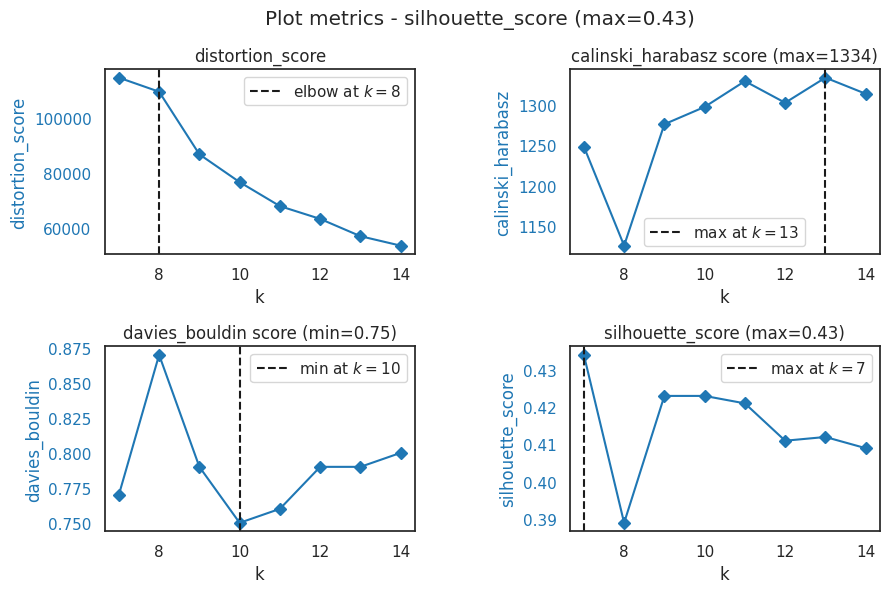

In [ ]:
search_params = {'n_clusters': range(7, 15)}
scores_combined, labels_combined = score_kmeans(
    X_tsne, param_grid=search_params, labels_true=df_data['categ_level_1'])
plot_metrics(scores_combined)


## 8.4 Visualization of clusters (text features + images)

ARI :  0.357
"Clustering_features_textes_+_images,_feature_reduction-_PCA_+_TSNE_(ARI_=_0-357).png"


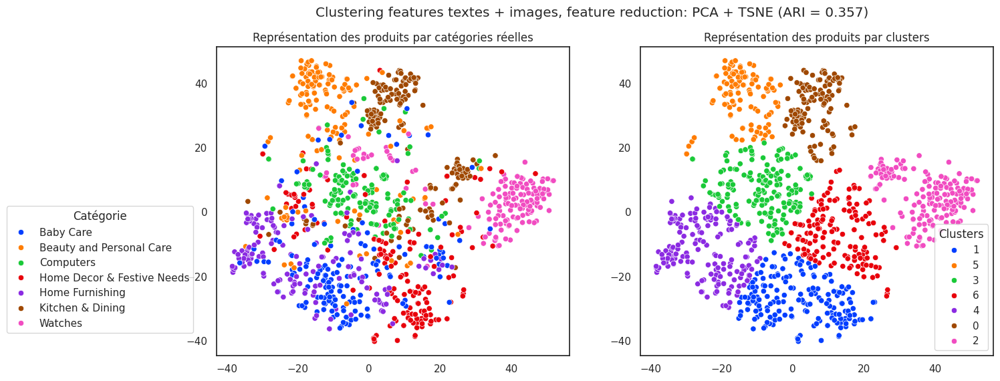

In [ ]:
# meilleur score
ARI_combined_max = scores_combined['ARI'].max()

plot_clusters_sur_2D(X_tsne, y_cat_txt, labels_combined, ARI_combined_max)
plt.suptitle(
    f'Clustering features textes + images, feature reduction: PCA + TSNE (ARI = {ARI_combined_max:.3f})')
to_png()


"Produits_sur_TSNE_pour_clustering_image_+_text.png"


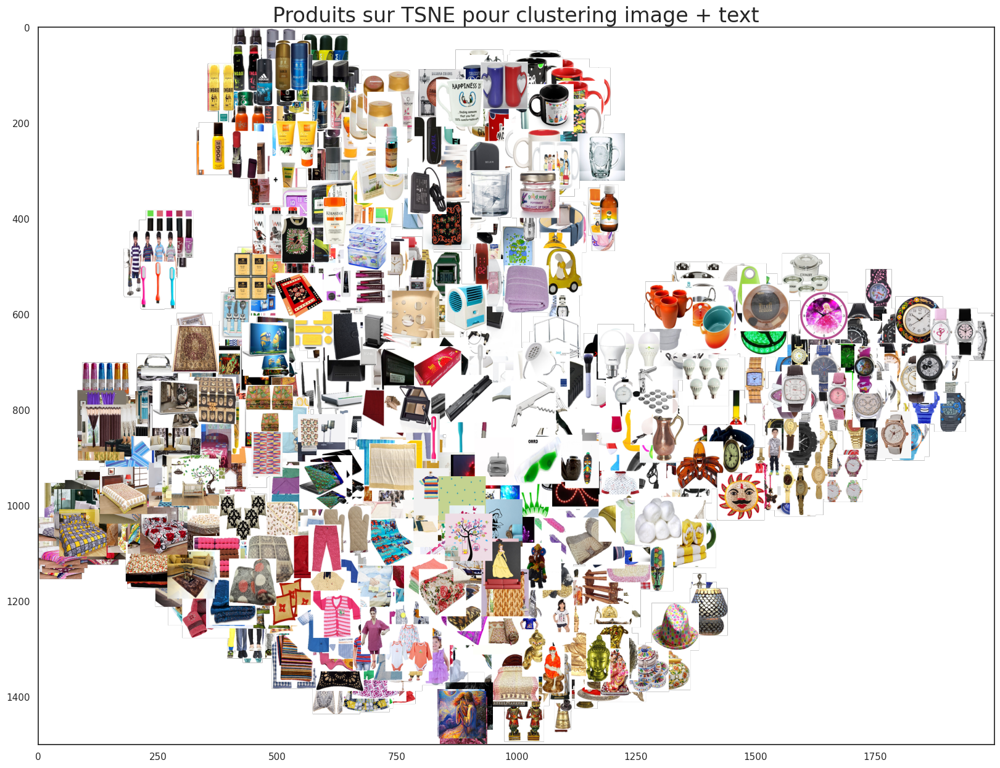

In [ ]:
plot_scatter_with_images(X_tsne, df_data['image'])
plt.title('Produits sur TSNE pour clustering image + text', fontsize=24)
to_png()


## 8.5 Performance evaluation on the 7 level 1 categories

[1 5 3 6 4 0 2]
Correspondance des clusters : [5 0 6 2 4 1 3]
ARI = 0.322
                            precision    recall  f1-score   support

                 Baby Care       0.39      0.46      0.42       150
  Beauty and Personal Care       0.88      0.67      0.76       150
                 Computers       0.57      0.63      0.60       150
Home Decor & Festive Needs       0.25      0.25      0.25       150
           Home Furnishing       0.56      0.63      0.59       150
          Kitchen & Dining       0.73      0.54      0.62       150
                   Watches       0.73      0.79      0.76       150

                  accuracy                           0.57      1050
                 macro avg       0.59      0.57      0.57      1050
              weighted avg       0.59      0.57      0.57      1050

"Classification_(images_+_text)_features,_ARI=0-322.png"


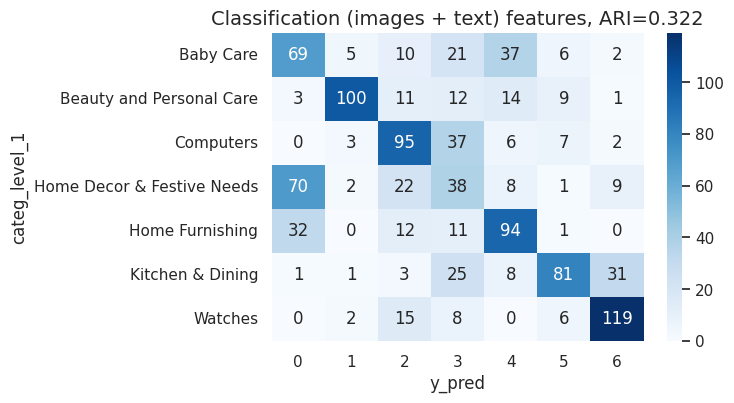

In [ ]:
labels_combined_transform= conf_matr_relabel(y_cat_txt,labels_combined)

ari_combi=plot_classification_metrics(y_cat_txt, labels_combined_transform)
plt.gca().set_xticklabels(range(7), rotation=0)
plt.title(f'Classification (images + text) features, ARI={ari_combi:.3f}', fontsize=14)
to_png()
df_resultats=add_model_score(model_name='Image_et_text',ARI=ari_combi, k=len(set(labels_combined)))


categ_level_1 clusters
(49, 3)
Index(['categ_level_1', 'variable', 'value'], dtype='object')


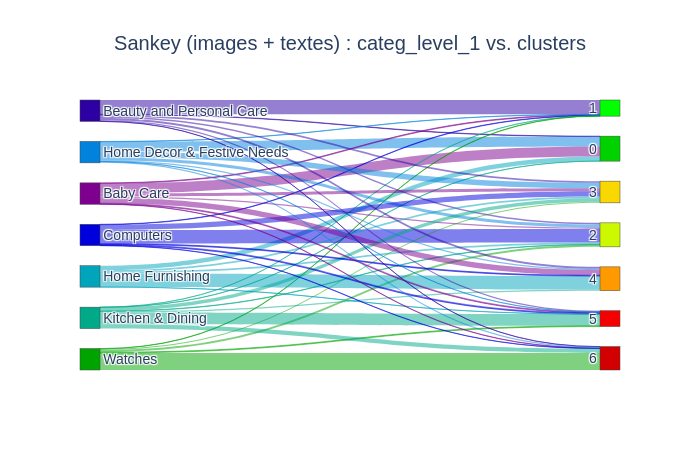

In [ ]:
plot_sankey_confusion_diagram(y_cat_txt, labels_combined_transform,
titre=f'Sankey (images + textes)')


In [ ]:
# confusion matrix avant de fusionner les clusters pour arriver à 7 clusters
conf_matrix_labels(y_cat_txt,labels_combined).style.background_gradient()

y_pred,1,5,3,6,4,0,2
categ_level_1,,,,,,,
Baby Care,69,5,10,21,37,6,2
Beauty and Personal Care,3,100,11,12,14,9,1
Computers,0,3,95,37,6,7,2
Home Decor & Festive Needs,70,2,22,38,8,1,9
Home Furnishing,32,0,12,11,94,1,0
Kitchen & Dining,1,1,3,25,8,81,31
Watches,0,2,15,8,0,6,119


## 8.6 Performance assessment on level 2 categories

In [ ]:
# Reduction de dimensions
categories2 = cat2_encoder.classes_
k2 = len(categories2)
text_image_features = np.random.rand(len(y_cat2_num), 10)  # Replace 10 with the desired number of features

# reduction en 2 dimensions tsne, cluster par KMeans, calcul de similarité
ARI_combined2, X_tsne, labels_combined2 = calc_tsne_cluster(
    text_image_features, categories2, y_cat2_num, k2)


t-SNE done! Time elapsed: 25.0 seconds
Clustering par KMeans, ARI = 0.001


k=4, fit: 0.01 s, silhouette= 0.372, ARI = 0.001, cluster sizes = [27 25 24 22]
k=5, fit: 0.0 s, silhouette= 0.345, ARI = 0.001, cluster sizes = [23 21 19 18 17]
k=6, fit: 0.01 s, silhouette= 0.327, ARI = 0.001, cluster sizes = [21 18 16 15 14 13]
k=7, fit: 0.01 s, silhouette= 0.352, ARI = -0.0, cluster sizes = [16 15 14 14 13 13 11]
k=8, fit: 0.01 s, silhouette= 0.343, ARI = 0.0, cluster sizes = [14 13 13 12 12 11 11 10]
k=9, fit: 0.01 s, silhouette= 0.34, ARI = -0.001, cluster sizes = [14 12 11 11 10 10 10  9  9]
k=10, fit: 0.01 s, silhouette= 0.332, ARI = 0.003, cluster sizes = [11 11 11 10 10  9  9  9  8  7]
k=15, fit: 0.01 s, silhouette= 0.343, ARI = 0.004, cluster sizes = [7 7 7 7 7 6 6 6 6 6 6 6 5 5 4]
k=20, fit: 0.01 s, silhouette= 0.341, ARI = 0.0, cluster sizes = [6 5 5 5 5 5 5 5 5 5 5 5 5 5 5 4 3 3 3 3]
k=25, fit: 0.02 s, silhouette= 0.356, ARI = 0.0, cluster sizes = [5 5 4 4 4 4 4 4 4 4 4 4 3 3 3 3 3 3 3 3 3 3 3 2 2]
k=30, fit: 0.02 s, silhouette= 0.359, ARI = 0.001, cluste

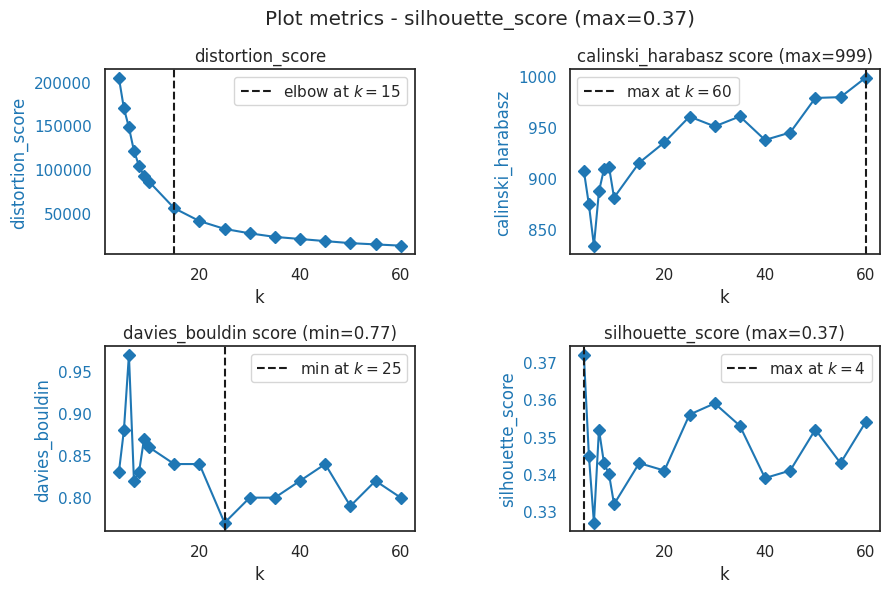

In [ ]:
search_params = {'n_clusters': [*range(4, 10), *np.arange(10, 61, 5)]}
scores_combined2, labels_combined2 = score_kmeans(
    X_tsne, param_grid=search_params, labels_true=df_data['categ_level_2'])
plot_metrics(scores_combined2)


In [ ]:
cls_labels_transform = conf_mat_transform(y_cat2_num, labels_combined2)
conf_mat = metrics.confusion_matrix(y_cat2_num, cls_labels_transform)
# print(conf_mat)


Correspondance des clusters :  [61 61 61 61]


                                  precision    recall  f1-score   support

               Baby & Kids Gifts       0.00      0.00      0.00        15
                Baby Bath & Skin       0.00      0.00      0.00        14
                    Baby Bedding       0.00      0.00      0.00        15
                   Baby Grooming       0.00      0.00      0.00         4
                 Bar & Glassware       0.00      0.00      0.00         8
                      Bath Linen       0.00      0.00      0.00        21
                    Bath and Spa       0.00      0.00      0.00         7
              Beauty Accessories       0.00      0.00      0.00         1
                       Bed Linen       0.00      0.00      0.00        65
              Body and Skin Care       0.00      0.00      0.00        15
            Candles & Fragrances       0.00      0.00      0.00         1
                          Clocks       0.00      0.00      0.00         1
                     Coffee Mugs     

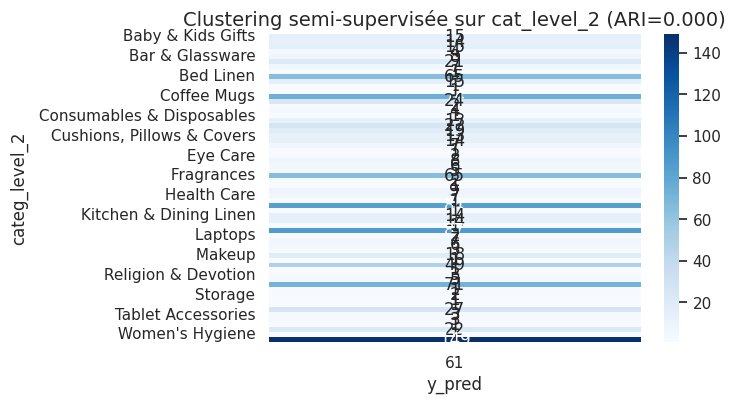

In [ ]:
print(metrics.classification_report(y_cat2_num, cls_labels_transform,
      target_names=categories2, zero_division=0))
ari_combi2=plot_classification_metrics(y_cat2_txt,cls_labels_transform)
plt.title(f'Clustering semi-supervisée sur cat_level_2 (ARI={ari_combi2:.3f})', fontsize=14)
to_png()
df_resultats=add_model_score(model_name='combi2',ARI=ari_combi2, k=len(set(cls_labels_transform)))

There are some level 2 categories that can be classified very well:- Coffee Mugs- Infant Wear- Wrist watchesFor other level 2 categories, only level 1 categories should be assigned.

#9. Results## 9.1 Summary of results

In [ ]:
df_resultats=df_resultats.sort_values(by='ARI',ascending=False)
df_resultats.to_csv(f'{OUT_FOLDER}/image_resultats.csv')
df_resultats

,model,ARI,k
2,CNN simple,0.33,7
5,Image_et_text,0.32,7
4,VGG16_moins2,0.29,6
3,VGG16,0.19,7
0,SIFT,0.04,10
1,ORB,0.03,10
6,combi2,0.00,1


## 9.2 Recording resultsSaves data with labels produced by each model

In [ ]:
# data_T.to_csv(f'{OUT_FOLDER}/data_image_labelled.csv')
